In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns 
import scipy.stats as stats
from sklearn.linear_model import LinearRegression

## 1. Определить два вектора, представляющие собой число автомобилей, припаркованных в течении 5 рабочих дней у бизнес-центра на уличнойстоянке и в подземном гараже

In [5]:
df_dict = {'День' : ('Понедельник', 'Вторник', 'Среда', 'Четверг', 'Пятница'), 
           'Улица' : (80, 98, 75, 91, 78),
           'Гараж' : (100, 82, 105, 89, 102)}
df = pd.DataFrame(df_dict)

In [6]:
df

,День,Улица,Гараж
0,Понедельник,80,100
1,Вторник,98,82
2,Среда,75,105
3,Четверг,91,89
4,Пятница,78,102


## 1.1. Найти и интерпретировать корреляцию между переменными «Улица» и «Гараж» (подсчитать корреляцию по Пирсону).

In [13]:
print(f'Корреляция между переменными Гараж и Улица: {np.corrcoef(df.Гараж, df.Улица)}')

Корреляция между переменными Гараж и Улица: [[ 1. -1.]
 [-1.  1.]]


<font size = 5> Видим, что переменные обратнопропорциональны друг-другу (коррелируют, но в противоположных направлениях)

## 1.2. Построить диаграмму рассеяния для вышеупомянутых переменных

<AxesSubplot:title={'center':'Диаграмма рассеяния для Гараж и Улица'}, xlabel='Гараж', ylabel='Улица'>

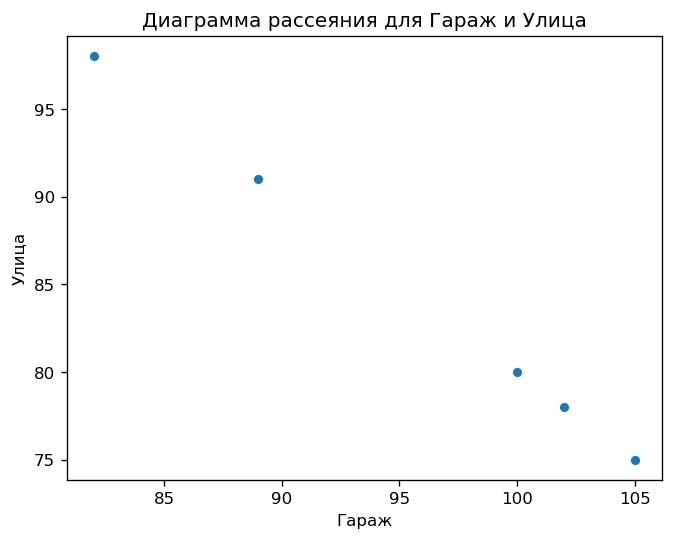

In [27]:
plt.figure(dpi=120)
plt.title('Диаграмма рассеяния для Гараж и Улица')
sns.scatterplot(x='Гараж', y='Улица', data=df)

## 2. Найти и выгрузить данные. Вывести, провести предобработку и описать признаки.

<font size = 5> Нашел и выгрузил данные. Ссылка: https://www.kaggle.com/datasets/jahnavipaliwal/customer-feedback-and-satisfaction

<font size = 5> 
Характеристики

Набор данных включает следующие столбцы:<br>
- CustomerID: уникальный идентификатор для каждого клиента.<br><br>
- Возраст (Age): возраст клиента (числовой).<br>
- Пол (Gender): Пол клиента (категорический: мужской, женский).<br>
- Страна (Country): Страна проживания (категорично: США, Канада, Великобритания, Германия, Франция).<br>
- Доход (Income): Годовой доход покупателя (числовой).<br>
- ProductQuality: Оценка качества продукта по шкале от 1 до 10 (числовая).<br>
- ServiceQuality: Оценка качества обслуживания по шкале от 1 до 10 (числовая).<br>
- PurchaseFrequency (частота покупок): Количество покупок, совершенных клиентом за последний год (числовой показатель).<br>
- FeedbackScore: Общая оценка отзывов, классифицированная как низкая, средняя или высокая (категорическая).<br>
- LoyaltyLevel (Уровень лояльности): Статус лояльности клиента (категорический: Бронзовый, Серебряный, Золотой).<br>
- SatisfactionScore: Целевая переменная, отражающая удовлетворенность клиента в процентах от 1 до 100 (числовой показатель).<br>


In [28]:
df_2 = pd.read_csv('customer_feedback_satisfaction.csv')

In [29]:
df_2.head()

,CustomerID,Age,Gender,Country,Income,ProductQuality,ServiceQuality,PurchaseFrequency,FeedbackScore,LoyaltyLevel,SatisfactionScore
0,1,56,Male,UK,83094,5,8,5,Low,Bronze,100.0
1,2,69,Male,UK,86860,10,2,8,Medium,Gold,100.0
2,3,46,Female,USA,60173,8,10,18,Medium,Silver,100.0
3,4,32,Female,UK,73884,7,10,16,Low,Gold,100.0
4,5,60,Male,UK,97546,6,4,13,Low,Bronze,82.0


In [30]:
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38444 entries, 0 to 38443
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   CustomerID         38444 non-null  int64  
 1   Age                38444 non-null  int64  
 2   Gender             38444 non-null  object 
 3   Country            38444 non-null  object 
 4   Income             38444 non-null  int64  
 5   ProductQuality     38444 non-null  int64  
 6   ServiceQuality     38444 non-null  int64  
 7   PurchaseFrequency  38444 non-null  int64  
 8   FeedbackScore      38444 non-null  object 
 9   LoyaltyLevel       38444 non-null  object 
 10  SatisfactionScore  38444 non-null  float64
dtypes: float64(1), int64(6), object(4)
memory usage: 3.2+ MB


<font size = 5> Видим, что данные и так предобработаны

## 2.1. Построить корреляционную матрицу по одной целевой переменной. Определить наиболее коррелирующую переменную, продолжить с ней работу в следующем пункте.

In [45]:
corr = df_2.corr()['SatisfactionScore'].to_frame()
corr.style.background_gradient(cmap='inferno')

,SatisfactionScore
CustomerID,0.004160
Age,0.157510
Income,0.245129
ProductQuality,0.547690
ServiceQuality,0.553614
PurchaseFrequency,0.113018
SatisfactionScore,1.000000


<font size = 5> Из матрицы корреляций видно, что наиболее коррелирующие переменные с целевой это **ProductQuality**, **ServiceQuality**.

## 2.2. Реализовать регрессию вручную, отобразить наклон, сдвиг и MSE.

<font size = 5> Возьмем **ServiceQuality** в качестве переменной

In [178]:
X = df_2.ServiceQuality.to_numpy()
y = df_2.SatisfactionScore.to_numpy()

In [179]:
def mserror(X, w1, w0, y):
    y_pred = w1 * X + w0 
    return np.sum((y - y_pred) ** 2) / len(y_pred)

def gr_mserror(X, w1, w0, y):
    y_pred = w1 * X + w0 
    return (2/len(X)*np.sum( (y - y_pred) ) * (-1), 2/len(X)*np.sum( (y - y_pred) * (-X)))

In [180]:
eps = 0.0001 # Минимальное значения различия между значениями переменных следующего и текущего шага

# первоначальные значения весов
w1 = 0
w0 = 0 

# размер шага
learning_rate = 0.0001
next_w1 = w1
next_w0 = w0 

n = 100000

for i in range(n):
    cur_w1 = next_w1
    cur_w0 = next_w0
    
    #Обновление весов по формуле градиентного спуска
    next_w0 = cur_w0 - learning_rate * gr_mserror(X, cur_w1, cur_w0, y)[0]
    next_w1 = cur_w1 - learning_rate * gr_mserror(X, cur_w1, cur_w0, y)[1]
    
    print(f'Итерация: {i}')
    print(f'Текущая точка {cur_w1, cur_w0} | следующая точка {next_w1, next_w0}')
    print(f'MSE {mserror(X, cur_w1, cur_w0, y)}')
    print(f'-------------------------------------------------------------------')
    
    if (abs(cur_w1 - next_w1) <= eps and abs(cur_w0 - next_w0) <= eps):
        break

Итерация: 0
Текущая точка (0, 0) | следующая точка (0.09906139127041931, 0.017055281812506505)
MSE 7557.620425598274
-------------------------------------------------------------------
Итерация: 1
Текущая точка (0.09906139127041931, 0.017055281812506505) | следующая точка (0.1973424507535012, 0.03399832830673069)
MSE 7456.9760816043645
-------------------------------------------------------------------
Итерация: 2
Текущая точка (0.1973424507535012, 0.03399832830673069) | следующая точка (0.2948493010284643, 0.050830019166140036)
MSE 7357.9036308528075
-------------------------------------------------------------------
Итерация: 3
Текущая точка (0.2948493010284643, 0.050830019166140036) | следующая точка (0.3915880166370374, 0.06755122717228301)
MSE 7260.378504201191
-------------------------------------------------------------------
Итерация: 4
Текущая точка (0.3915880166370374, 0.06755122717228301) | следующая точка (0.48756462446035975, 0.08416281825894124)
MSE 7164.376516531441
----

Итерация: 355
Текущая точка (11.762718825691135, 2.6845397951379333) | следующая точка (11.768397937963035, 2.688136190226933)
MSE 1120.253719058034
-------------------------------------------------------------------
Итерация: 356
Текущая точка (11.768397937963035, 2.688136190226933) | следующая точка (11.774029437717617, 2.6917256272268855)
MSE 1119.8033324240469
-------------------------------------------------------------------
Итерация: 357
Текущая точка (11.774029437717617, 2.6917256272268855) | следующая точка (11.779613698649356, 2.695308159834318)
MSE 1119.358807990928
-------------------------------------------------------------------
Итерация: 358
Текущая точка (11.779613698649356, 2.695308159834318) | следующая точка (11.785151091520731, 2.6988838413244944)
MSE 1118.9200542297042
-------------------------------------------------------------------
Итерация: 359
Текущая точка (11.785151091520731, 2.6988838413244944) | следующая точка (11.790641984185232, 2.7024527245547216)
MS

Итерация: 681
Текущая точка (12.350360783506362, 3.669209981366997) | следующая точка (12.35044032207686, 3.6719638861479145)
MSE 1072.0688400034167
-------------------------------------------------------------------
Итерация: 682
Текущая точка (12.35044032207686, 3.6719638861479145) | следующая точка (12.350516223833061, 3.674717152770482)
MSE 1071.992947057623
-------------------------------------------------------------------
Итерация: 683
Текущая точка (12.350516223833061, 3.674717152770482) | следующая точка (12.350588517436275, 3.6774697853575664)
MSE 1071.917094773577
-------------------------------------------------------------------
Итерация: 684
Текущая точка (12.350588517436275, 3.6774697853575664) | следующая точка (12.350657231322927, 3.6802217879997254)
MSE 1071.8412826123194
-------------------------------------------------------------------
Итерация: 685
Текущая точка (12.350657231322927, 3.6802217879997254) | следующая точка (12.350722393706329, 3.6829731647554587)
MSE

MSE 1044.0836458547274
-------------------------------------------------------------------
Итерация: 1066
Текущая точка (12.259406363850253, 4.703493969678468) | следующая точка (12.25904895416773, 4.706140935979652)
MSE 1044.0122995589877
-------------------------------------------------------------------
Итерация: 1067
Текущая точка (12.25904895416773, 4.706140935979652) | следующая точка (12.25869138445821, 4.70878776552132)
MSE 1043.9409593601931
-------------------------------------------------------------------
Итерация: 1068
Текущая точка (12.25869138445821, 4.70878776552132) | следующая точка (12.25833365610224, 4.711434458506621)
MSE 1043.8696252565665
-------------------------------------------------------------------
Итерация: 1069
Текущая точка (12.25833365610224, 4.711434458506621) | следующая точка (12.257975770469525, 4.714081015137149)
MSE 1043.7982972463496
-------------------------------------------------------------------
Итерация: 1070
Текущая точка (12.257975770469

Итерация: 1409
Текущая точка (12.132721578686677, 5.604174377271409) | следующая точка (12.13234869072288, 5.6067803775356815)
MSE 1019.8934912206037
-------------------------------------------------------------------
Итерация: 1410
Текущая точка (12.13234869072288, 5.6067803775356815) | следующая точка (12.13197580673433, 5.609386266237368)
MSE 1019.8241898535666
-------------------------------------------------------------------
Итерация: 1411
Текущая точка (12.13197580673433, 5.609386266237368) | следующая точка (12.131602926813022, 5.611992043394415)
MSE 1019.7548943305693
-------------------------------------------------------------------
Итерация: 1412
Текущая точка (12.131602926813022, 5.611992043394415) | следующая точка (12.131230051050224, 5.614597709024663)
MSE 1019.6856046511133
-------------------------------------------------------------------
Итерация: 1413
Текущая точка (12.131230051050224, 5.614597709024663) | следующая точка (12.130857179536484, 5.617203263145848)
MSE

Итерация: 1670
Текущая точка (12.035705898820003, 6.28059382405459) | следующая точка (12.035335795716279, 6.2831711173675115)
MSE 1002.0026794328535
-------------------------------------------------------------------
Итерация: 1671
Текущая точка (12.035335795716279, 6.2831711173675115) | следующая точка (12.034965706713598, 6.285748301799918)
MSE 1001.9348866907507
-------------------------------------------------------------------
Итерация: 1672
Текущая точка (12.034965706713598, 6.285748301799918) | следующая точка (12.03459563182316, 6.288325377358097)
MSE 1001.867099665124
-------------------------------------------------------------------
Итерация: 1673
Текущая точка (12.03459563182316, 6.288325377358097) | следующая точка (12.034225571056076, 6.29090234404832)
MSE 1001.7993183554912
-------------------------------------------------------------------
Итерация: 1674
Текущая точка (12.034225571056076, 6.29090234404832) | следующая точка (12.033855524423359, 6.293479201876844)
MSE 1

Итерация: 1995
Текущая точка (11.916200716004226, 7.1125131678784435) | следующая точка (11.915835474714559, 7.115055360188191)
MSE 980.2682965023977
-------------------------------------------------------------------
Итерация: 1996
Текущая точка (11.915835474714559, 7.115055360188191) | следующая точка (11.915470248708074, 7.117597445296663)
MSE 980.2023364635451
-------------------------------------------------------------------
Итерация: 1997
Текущая точка (11.915470248708074, 7.117597445296663) | следующая точка (11.915105037985038, 7.120139423208507)
MSE 980.1363819866242
-------------------------------------------------------------------
Итерация: 1998
Текущая точка (11.915105037985038, 7.120139423208507) | следующая точка (11.914739842545712, 7.122681293928376)
MSE 980.0704330711659
-------------------------------------------------------------------
Итерация: 1999
Текущая точка (11.914739842545712, 7.122681293928376) | следующая точка (11.914374662390351, 7.125223057460916)
MSE 

Итерация: 2330
Текущая точка (11.79469919401189, 7.958178657288322) | следующая точка (11.794339061747348, 7.96068519245165)
MSE 958.4799536010705
-------------------------------------------------------------------
Итерация: 2331
Текущая точка (11.794339061747348, 7.96068519245165) | следующая точка (11.793978944658493, 7.963191621932592)
MSE 958.4158308151501
-------------------------------------------------------------------
Итерация: 2332
Текущая точка (11.793978944658493, 7.963191621932592) | следующая точка (11.79361884274475, 7.965697945735612)
MSE 958.3517134362393
-------------------------------------------------------------------
Итерация: 2333
Текущая точка (11.79361884274475, 7.965697945735612) | следующая точка (11.793258756005546, 7.968204163865176)
MSE 958.2876014638822
-------------------------------------------------------------------
Итерация: 2334
Текущая точка (11.793258756005546, 7.968204163865176) | следующая точка (11.792898684440303, 7.9707102763257485)
MSE 958.2

Итерация: 2607
Текущая точка (11.695520570459166, 8.648464671628744) | следующая точка (11.695164618850853, 8.650942102637087)
MSE 940.9230418155328
-------------------------------------------------------------------
Итерация: 2608
Текущая точка (11.695164618850853, 8.650942102637087) | следующая точка (11.694808682249327, 8.653419429191198)
MSE 940.8603994766464
-------------------------------------------------------------------
Итерация: 2609
Текущая точка (11.694808682249327, 8.653419429191198) | следующая точка (11.694452760653965, 8.655896651295484)
MSE 940.7977624199343
-------------------------------------------------------------------
Итерация: 2610
Текущая точка (11.694452760653965, 8.655896651295484) | следующая точка (11.69409685406414, 8.658373768954348)
MSE 940.7351306449506
-------------------------------------------------------------------
Итерация: 2611
Текущая точка (11.69409685406414, 8.658373768954348) | следующая точка (11.693740962479227, 8.660850782172195)
MSE 940

Итерация: 2892
Текущая точка (11.594679295890387, 9.350322012048657) | следующая точка (11.594327595871595, 9.35276985114829)
MSE 923.2820544612297
-------------------------------------------------------------------
Итерация: 2893
Текущая точка (11.594327595871595, 9.35276985114829) | следующая точка (11.593975910681174, 9.355217587041475)
MSE 923.2208996588602
-------------------------------------------------------------------
Итерация: 2894
Текущая точка (11.593975910681174, 9.355217587041475) | следующая точка (11.593624240318496, 9.357665219732562)
MSE 923.1597500132317
-------------------------------------------------------------------
Итерация: 2895
Текущая точка (11.593624240318496, 9.357665219732562) | следующая точка (11.59327258478294, 9.360112749225904)
MSE 923.098605523909
-------------------------------------------------------------------
Итерация: 2896
Текущая точка (11.59327258478294, 9.360112749225904) | следующая точка (11.592920944073878, 9.36256017552585)
MSE 923.037

Итерация: 3191
Текущая точка (11.490178862158583, 10.077647085049763) | следующая точка (11.489831568103053, 10.080064258477156)
MSE 905.2246005846653
-------------------------------------------------------------------
Итерация: 3192
Текущая точка (11.489831568103053, 10.080064258477156) | следующая точка (11.489484288690216, 10.082481329991047)
MSE 905.1649684364141
-------------------------------------------------------------------
Итерация: 3193
Текущая точка (11.489484288690216, 10.082481329991047) | следующая точка (11.489137023919456, 10.084898299595734)
MSE 905.105341316509
-------------------------------------------------------------------
Итерация: 3194
Текущая точка (11.489137023919456, 10.084898299595734) | следующая точка (11.488789773790154, 10.087315167295513)
MSE 905.045719224527
-------------------------------------------------------------------
Итерация: 3195
Текущая точка (11.488789773790154, 10.087315167295513) | следующая точка (11.488442538301696, 10.08973193309468

Итерация: 3500
Текущая точка (11.383558789748061, 10.81972487528479) | следующая точка (11.383215991034909, 10.822110761033494)
MSE 887.0354941809939
-------------------------------------------------------------------
Итерация: 3501
Текущая точка (11.383215991034909, 10.822110761033494) | следующая точка (11.382873206774924, 10.82449654618786)
MSE 886.9773957881634
-------------------------------------------------------------------
Итерация: 3502
Текущая точка (11.382873206774924, 10.82449654618786) | следующая точка (11.3825304369675, 10.826882230752124)
MSE 886.9193022943488
-------------------------------------------------------------------
Итерация: 3503
Текущая точка (11.3825304369675, 10.826882230752124) | следующая точка (11.382187681612024, 10.82926781473053)
MSE 886.8612136991372
-------------------------------------------------------------------
Итерация: 3504
Текущая точка (11.382187681612024, 10.82926781473053) | следующая точка (11.38184494070789, 10.831653298127318)
MSE 8

Итерация: 3803
Текущая точка (11.280349266939563, 11.53806517267691) | следующая точка (11.2800108197733, 11.540420771573475)
MSE 869.6539414195283
-------------------------------------------------------------------
Итерация: 3804
Текущая точка (11.2800108197733, 11.540420771573475) | следующая точка (11.279672386876735, 11.54277627115266)
MSE 869.597308686977
-------------------------------------------------------------------
Итерация: 3805
Текущая точка (11.279672386876735, 11.54277627115266) | следующая точка (11.279333968249267, 11.545131671418654)
MSE 869.5406807298533
-------------------------------------------------------------------
Итерация: 3806
Текущая точка (11.279333968249267, 11.545131671418654) | следующая точка (11.278995563890293, 11.547486972375644)
MSE 869.4840575477547
-------------------------------------------------------------------
Итерация: 3807
Текущая точка (11.278995563890293, 11.547486972375644) | следующая точка (11.278657173799212, 11.549842174027816)
MSE

Итерация: 4072
Текущая точка (11.189819420029108, 12.168154677751925) | следующая точка (11.189484789805999, 12.170483710649425)
MSE 854.590586811531
-------------------------------------------------------------------
Итерация: 4073
Текущая точка (11.189484789805999, 12.170483710649425) | следующая точка (11.189150173691656, 12.172812645349628)
MSE 854.535224262422
-------------------------------------------------------------------
Итерация: 4074
Текущая точка (11.189150173691656, 12.172812645349628) | следующая точка (11.188815571685486, 12.175141481856675)
MSE 854.4798663816354
-------------------------------------------------------------------
Итерация: 4075
Текущая точка (11.188815571685486, 12.175141481856675) | следующая точка (11.188480983786894, 12.177470220174708)
MSE 854.4245131687776
-------------------------------------------------------------------
Итерация: 4076
Текущая точка (11.188480983786894, 12.177470220174708) | следующая точка (11.188146409995285, 12.17979886030786

Итерация: 4381
Текущая точка (11.087087173468694, 12.883173123036809) | следующая точка (11.086756874669522, 12.885472009138981)
MSE 837.7038013099682
-------------------------------------------------------------------
Итерация: 4382
Текущая точка (11.086756874669522, 12.885472009138981) | следующая точка (11.086426589796496, 12.887770798314914)
MSE 837.649862701004
-------------------------------------------------------------------
Итерация: 4383
Текущая точка (11.086426589796496, 12.887770798314914) | следующая точка (11.086096318849027, 12.890069490568695)
MSE 837.5959286402916
-------------------------------------------------------------------
Итерация: 4384
Текущая точка (11.086096318849027, 12.890069490568695) | следующая точка (11.085766061826527, 12.89236808590441)
MSE 837.5419991274476
-------------------------------------------------------------------
Итерация: 4385
Текущая точка (11.085766061826527, 12.89236808590441) | следующая точка (11.085435818728412, 12.894666584326146

Итерация: 4662
Текущая точка (10.99481892352498, 13.525361947215174) | следующая точка (10.994492514963975, 13.527633757183617)
MSE 822.7245854394001
-------------------------------------------------------------------
Итерация: 4663
Текущая точка (10.994492514963975, 13.527633757183617) | следующая точка (10.994166120165094, 13.529905471367412)
MSE 822.6719099190691
-------------------------------------------------------------------
Итерация: 4664
Текущая точка (10.994166120165094, 13.529905471367412) | следующая точка (10.993839739127756, 13.532177089770597)
MSE 822.6192388404824
-------------------------------------------------------------------
Итерация: 4665
Текущая точка (10.993839739127756, 13.532177089770597) | следующая точка (10.993513371851382, 13.534448612397211)
MSE 822.566572203266
-------------------------------------------------------------------
Итерация: 4666
Текущая точка (10.993513371851382, 13.534448612397211) | следующая точка (10.99318701833539, 13.536720039251293

Итерация: 4958
Текущая точка (10.898800368753355, 14.193652966343587) | следующая точка (10.898478008551855, 14.195896599650705)
MSE 807.3249653024085
-------------------------------------------------------------------
Итерация: 4959
Текущая точка (10.898478008551855, 14.195896599650705) | следующая точка (10.89815566194179, 14.198140138361168)
MSE 807.2735883203529
-------------------------------------------------------------------
Итерация: 4960
Текущая точка (10.89815566194179, 14.198140138361168) | следующая точка (10.897833328922587, 14.200383582478963)
MSE 807.2222156705456
-------------------------------------------------------------------
Итерация: 4961
Текущая точка (10.897833328922587, 14.200383582478963) | следующая точка (10.897511009493675, 14.202626932008078)
MSE 807.1708473526214
-------------------------------------------------------------------
Итерация: 4962
Текущая точка (10.897511009493675, 14.202626932008078) | следующая точка (10.897188703654479, 14.20487018695250

MSE 793.6595519534933
-------------------------------------------------------------------
Итерация: 5228
Текущая точка (10.812254833505092, 14.796011584317466) | следующая точка (10.81193612225916, 14.798229820822462)
MSE 793.6093272766327
-------------------------------------------------------------------
Итерация: 5229
Текущая точка (10.81193612225916, 14.798229820822462) | следующая точка (10.811617424450816, 14.800447963801588)
MSE 793.5591068348549
-------------------------------------------------------------------
Итерация: 5230
Текущая точка (10.811617424450816, 14.800447963801588) | следующая точка (10.811298740079492, 14.802666013258788)
MSE 793.5088906278029
-------------------------------------------------------------------
Итерация: 5231
Текущая точка (10.811298740079492, 14.802666013258788) | следующая точка (10.810980069144621, 14.804883969198004)
MSE 793.4586786551192
-------------------------------------------------------------------
Итерация: 5232
Текущая точка (10.810

MSE 780.6935672249335
-------------------------------------------------------------------
Итерация: 5489
Текущая точка (10.7295254805379, 15.37180949897863) | следующая точка (10.729210257348658, 15.374003458540844)
MSE 780.6444358755256
-------------------------------------------------------------------
Итерация: 5490
Текущая точка (10.729210257348658, 15.374003458540844) | следующая точка (10.728895047449939, 15.37619732560076)
MSE 780.5953086690076
-------------------------------------------------------------------
Итерация: 5491
Текущая точка (10.728895047449939, 15.37619732560076) | следующая точка (10.728579850841182, 15.378391100162277)
MSE 780.5461856050308
-------------------------------------------------------------------
Итерация: 5492
Текущая точка (10.728579850841182, 15.378391100162277) | следующая точка (10.728264667521827, 15.380584782229295)
MSE 780.4970666832459
-------------------------------------------------------------------
Итерация: 5493
Текущая точка (10.728264

MSE 765.7074335982622
-------------------------------------------------------------------
Итерация: 5798
Текущая точка (10.63275123791932, 16.045360120301613) | следующая точка (10.632440094951091, 16.047525681445777)
MSE 765.6595659208114
-------------------------------------------------------------------
Итерация: 5799
Текущая точка (10.632440094951091, 16.047525681445777) | следующая точка (10.632128965101353, 16.049691151284982)
MSE 765.6117022796944
-------------------------------------------------------------------
Итерация: 5800
Текущая точка (10.632128965101353, 16.049691151284982) | следующая точка (10.631817848369554, 16.05185652982308)
MSE 765.5638426745712
-------------------------------------------------------------------
Итерация: 5801
Текущая точка (10.631817848369554, 16.05185652982308) | следующая точка (10.631506744755141, 16.05402181706392)
MSE 765.5159871051014
-------------------------------------------------------------------
Итерация: 5802
Текущая точка (10.63150

MSE 751.9001701161972
-------------------------------------------------------------------
Итерация: 6090
Текущая точка (10.542452578736142, 16.673840554265478) | следующая точка (10.542145242963679, 16.675979617252658)
MSE 751.8534667051341
-------------------------------------------------------------------
Итерация: 6091
Текущая точка (10.542145242963679, 16.675979617252658) | следующая точка (10.541837920149186, 16.6781185900521)
MSE 751.806767232231
-------------------------------------------------------------------
Итерация: 6092
Текущая точка (10.541837920149186, 16.6781185900521) | следующая точка (10.541530610292119, 16.680257472667613)
MSE 751.7600716971558
-------------------------------------------------------------------
Итерация: 6093
Текущая точка (10.541530610292119, 16.680257472667613) | следующая точка (10.541223313391932, 16.682396265102994)
MSE 751.7133800995763
-------------------------------------------------------------------
Итерация: 6094
Текущая точка (10.541223

Итерация: 6414
Текущая точка (10.443550769220362, 17.362199082803563) | следующая точка (10.443247603371946, 17.36430912303782)
MSE 736.9270359244728
-------------------------------------------------------------------
Итерация: 6415
Текущая точка (10.443247603371946, 17.36430912303782) | следующая точка (10.442944450305687, 17.36641907430801)
MSE 736.8815950892188
-------------------------------------------------------------------
Итерация: 6416
Текущая точка (10.442944450305687, 17.36641907430801) | следующая точка (10.442641310021047, 17.368528936617878)
MSE 736.8361580856613
-------------------------------------------------------------------
Итерация: 6417
Текущая точка (10.442641310021047, 17.368528936617878) | следующая точка (10.442338182517489, 17.37063870997118)
MSE 736.7907249134761
-------------------------------------------------------------------
Итерация: 6418
Текущая точка (10.442338182517489, 17.37063870997118) | следующая точка (10.442035067794471, 17.372748394371662)
M

Итерация: 6702
Текущая точка (10.356765148939097, 17.966228697302668) | следующая точка (10.356465642168777, 17.968313270281808)
MSE 723.9971663279466
-------------------------------------------------------------------
Итерация: 6703
Текущая точка (10.356465642168777, 17.968313270281808) | следующая точка (10.35616614802634, 17.970397755370634)
MSE 723.9528157748177
-------------------------------------------------------------------
Итерация: 6704
Текущая точка (10.35616614802634, 17.970397755370634) | следующая точка (10.355866666511254, 17.972482152572855)
MSE 723.9084689614494
-------------------------------------------------------------------
Итерация: 6705
Текущая точка (10.355866666511254, 17.972482152572855) | следующая точка (10.355567197622985, 17.974566461892174)
MSE 723.8641258875264
-------------------------------------------------------------------
Итерация: 6706
Текущая точка (10.355567197622985, 17.974566461892174) | следующая точка (10.355267741361002, 17.97665068333229

MSE 707.7111824899433
-------------------------------------------------------------------
Итерация: 7076
Текущая точка (10.24562583729417, 18.739760479999074) | следующая точка (10.245331016408674, 18.7418124391282)
MSE 707.6682052157124
-------------------------------------------------------------------
Итерация: 7077
Текущая точка (10.245331016408674, 18.7418124391282) | следующая точка (10.245036207953492, 18.743864311742087)
MSE 707.6252315654433
-------------------------------------------------------------------
Итерация: 7078
Текущая точка (10.245036207953492, 18.743864311742087) | следующая точка (10.244741411928102, 18.745916097844383)
MSE 707.5822615388307
-------------------------------------------------------------------
Итерация: 7079
Текущая точка (10.244741411928102, 18.745916097844383) | следующая точка (10.244446628331978, 18.747967797438733)
MSE 707.5392951355685
-------------------------------------------------------------------
Итерация: 7080
Текущая точка (10.244446

Итерация: 7444
Текущая точка (10.13796684466648, 19.48906917426786) | следующая точка (10.137676562927682, 19.491089540847184)
MSE 692.0961021239647
-------------------------------------------------------------------
Итерация: 7445
Текущая точка (10.137676562927682, 19.491089540847184) | следующая точка (10.13738629342782, 19.49310982224328)
MSE 692.0544415562078
-------------------------------------------------------------------
Итерация: 7446
Текущая точка (10.13738629342782, 19.49310982224328) | следующая точка (10.137096036166376, 19.495130018459744)
MSE 692.0127845013849
-------------------------------------------------------------------
Итерация: 7447
Текущая точка (10.137096036166376, 19.495130018459744) | следующая точка (10.136805791142836, 19.497150129500163)
MSE 691.9711309591987
-------------------------------------------------------------------
Итерация: 7448
Текущая точка (10.136805791142836, 19.497150129500163) | следующая точка (10.136515558356681, 19.49917015536813)
MS

Итерация: 7763
Текущая точка (10.045984984566525, 20.129264719532404) | следующая точка (10.04569858099105, 20.131258094019145)
MSE 678.982983432776
-------------------------------------------------------------------
Итерация: 7764
Текущая точка (10.04569858099105, 20.131258094019145) | следующая точка (10.045412189491, 20.133251384460706)
MSE 678.9424285992114
-------------------------------------------------------------------
Итерация: 7765
Текущая точка (10.045412189491, 20.133251384460706) | следующая точка (10.045125810065862, 20.135244590860633)
MSE 678.901877185342
-------------------------------------------------------------------
Итерация: 7766
Текущая точка (10.045125810065862, 20.135244590860633) | следующая точка (10.044839442715128, 20.13723771322247)
MSE 678.8613291908789
-------------------------------------------------------------------
Итерация: 7767
Текущая точка (10.044839442715128, 20.13723771322247) | следующая точка (10.04455308743829, 20.139230751549757)
MSE 678.

MSE 665.3107440912528
-------------------------------------------------------------------
Итерация: 8106
Текущая точка (9.948453435781678, 20.808086206583788) | следующая точка (9.948171144356959, 20.810050960420853)
MSE 665.27134213847
-------------------------------------------------------------------
Итерация: 8107
Текущая точка (9.948171144356959, 20.810050960420853) | следующая точка (9.947888864834285, 20.812015631419452)
MSE 665.2319435081678
-------------------------------------------------------------------
Итерация: 8108
Текущая точка (9.947888864834285, 20.812015631419452) | следующая точка (9.947606597213154, 20.813980219583076)
MSE 665.1925482000663
-------------------------------------------------------------------
Итерация: 8109
Текущая точка (9.947606597213154, 20.813980219583076) | следующая точка (9.947324341493065, 20.81594472491522)
MSE 665.1531562138854
-------------------------------------------------------------------
Итерация: 8110
Текущая точка (9.9473243414930

Итерация: 8485
Текущая точка (9.842313041882036, 21.546825424004872) | следующая точка (9.842035225576458, 21.54875903092519)
MSE 650.5747319871966
-------------------------------------------------------------------
Итерация: 8486
Текущая точка (9.842035225576458, 21.54875903092519) | следующая точка (9.841757420984244, 21.550692556320264)
MSE 650.5365726154371
-------------------------------------------------------------------
Итерация: 8487
Текущая точка (9.841757420984244, 21.550692556320264) | следующая точка (9.8414796281049, 21.552626000193534)
MSE 650.4984164613801
-------------------------------------------------------------------
Итерация: 8488
Текущая точка (9.8414796281049, 21.552626000193534) | следующая точка (9.841201846937931, 21.55455936254844)
MSE 650.4602635247552
-------------------------------------------------------------------
Итерация: 8489
Текущая точка (9.841201846937931, 21.55455936254844) | следующая точка (9.840924077482846, 21.55649264338841)
MSE 650.422113

Итерация: 8798
Текущая точка (9.755925986671649, 22.148081017815514) | следующая точка (9.755651812639762, 22.1499892744397)
MSE 638.7865981544455
-------------------------------------------------------------------
Итерация: 8799
Текущая точка (9.755651812639762, 22.1499892744397) | следующая точка (9.755377650167674, 22.151897450607475)
MSE 638.7494327905148
-------------------------------------------------------------------
Итерация: 8800
Текущая точка (9.755377650167674, 22.151897450607475) | следующая точка (9.755103499254895, 22.15380554632222)
MSE 638.7122705604695
-------------------------------------------------------------------
Итерация: 8801
Текущая точка (9.755103499254895, 22.15380554632222) | следующая точка (9.754829359900938, 22.155713561587337)
MSE 638.6751114640457
-------------------------------------------------------------------
Итерация: 8802
Текущая точка (9.754829359900938, 22.155713561587337) | следующая точка (9.754555232105318, 22.15762149640621)
MSE 638.6379

MSE 628.6106676073614
-------------------------------------------------------------------
Итерация: 9076
Текущая точка (9.68014897122249, 22.67549052737832) | следующая точка (9.679877992121014, 22.677376547224362)
MSE 628.5743603058497
-------------------------------------------------------------------
Итерация: 9077
Текущая точка (9.679877992121014, 22.677376547224362) | следующая точка (9.67960702444463, 22.67926248755154)
MSE 628.5380560658692
-------------------------------------------------------------------
Итерация: 9078
Текущая точка (9.67960702444463, 22.67926248755154) | следующая точка (9.679336068192857, 22.68114834836321)
MSE 628.5017548871621
-------------------------------------------------------------------
Итерация: 9079
Текущая точка (9.679336068192857, 22.68114834836321) | следующая точка (9.679065123365213, 22.68303412966272)
MSE 628.4654567694699
-------------------------------------------------------------------
Итерация: 9080
Текущая точка (9.679065123365213, 22

Итерация: 9325
Текущая точка (9.61302671470323, 23.142662745520383) | следующая точка (9.612758565627948, 23.14452906832877)
MSE 619.6284716014767
-------------------------------------------------------------------
Итерация: 9326
Текущая точка (9.612758565627948, 23.14452906832877) | следующая точка (9.612490427858438, 23.14639531244876)
MSE 619.5929217034079
-------------------------------------------------------------------
Итерация: 9327
Текущая точка (9.612490427858438, 23.14639531244876) | следующая точка (9.612222301394223, 23.14826147788368)
MSE 619.5573748030041
-------------------------------------------------------------------
Итерация: 9328
Текущая точка (9.612222301394223, 23.14826147788368) | следующая точка (9.611954186234826, 23.15012756463684)
MSE 619.5218309000127
-------------------------------------------------------------------
Итерация: 9329
Текущая точка (9.611954186234826, 23.15012756463684) | следующая точка (9.611686082379771, 23.15199357271156)
MSE 619.4862899

Итерация: 9679
Текущая точка (9.518804856296773, 23.798448722807723) | следующая точка (9.518540679828211, 23.80028739619564)
MSE 607.229265334201
-------------------------------------------------------------------
Итерация: 9680
Текущая точка (9.518540679828211, 23.80028739619564) | следующая точка (9.518276514497927, 23.802125992060926)
MSE 607.1947609712676
-------------------------------------------------------------------
Итерация: 9681
Текущая точка (9.518276514497927, 23.802125992060926) | следующая точка (9.518012360305452, 23.80396451040685)
MSE 607.1602595178368
-------------------------------------------------------------------
Итерация: 9682
Текущая точка (9.518012360305452, 23.80396451040685) | следующая точка (9.517748217250315, 23.805802951236682)
MSE 607.1257609736633
-------------------------------------------------------------------
Итерация: 9683
Текущая точка (9.517748217250315, 23.805802951236682) | следующая точка (9.517484085332045, 23.80764131455369)
MSE 607.091

Итерация: 10042
Текущая точка (9.423636917609441, 24.460819437353305) | следующая точка (9.423376753636484, 24.46263018369333)
MSE 594.8934195748735
-------------------------------------------------------------------
Итерация: 10043
Текущая точка (9.423376753636484, 24.46263018369333) | следующая точка (9.42311660063263, 24.4644408536882)
MSE 594.8599554043433
-------------------------------------------------------------------
Итерация: 10044
Текущая точка (9.42311660063263, 24.4644408536882) | следующая точка (9.422856458597415, 24.466251447341122)
MSE 594.8264940556041
-------------------------------------------------------------------
Итерация: 10045
Текущая точка (9.422856458597415, 24.466251447341122) | следующая точка (9.422596327530377, 24.46806196465532)
MSE 594.7930355284175
-------------------------------------------------------------------
Итерация: 10046
Текущая точка (9.422596327530377, 24.46806196465532) | следующая точка (9.422336207431051, 24.46987240563401)
MSE 594.759

MSE 583.5141230582954
-------------------------------------------------------------------
Итерация: 10388
Текущая точка (9.334271720039718, 25.082802960231078) | следующая точка (9.334015323905673, 25.08458748233859)
MSE 583.4816184213088
-------------------------------------------------------------------
Итерация: 10389
Текущая точка (9.334015323905673, 25.08458748233859) | следующая точка (9.33375893858187, 25.086371929206617)
MSE 583.4491165252024
-------------------------------------------------------------------
Итерация: 10390
Текущая точка (9.33375893858187, 25.086371929206617) | следующая точка (9.333502564067851, 25.088156300838325)
MSE 583.4166173697449
-------------------------------------------------------------------
Итерация: 10391
Текущая точка (9.333502564067851, 25.088156300838325) | следующая точка (9.333246200363162, 25.089940597236886)
MSE 583.3841209547057
-------------------------------------------------------------------
Итерация: 10392
Текущая точка (9.333246200

MSE 573.0614961901849
-------------------------------------------------------------------
Итерация: 10714
Текущая точка (9.251256654038462, 25.66058944319731) | следующая точка (9.251003758007416, 25.662349604519505)
MSE 573.0298729474109
-------------------------------------------------------------------
Итерация: 10715
Текущая точка (9.251003758007416, 25.662349604519505) | следующая точка (9.250750872639037, 25.664109691629317)
MSE 572.9982523711957
-------------------------------------------------------------------
Итерация: 10716
Текущая точка (9.250750872639037, 25.664109691629317) | следующая точка (9.250497997932877, 25.665869704529875)
MSE 572.9666344613145
-------------------------------------------------------------------
Итерация: 10717
Текущая точка (9.250497997932877, 25.665869704529875) | следующая точка (9.250245133888487, 25.667629643224306)
MSE 572.9350192175422
-------------------------------------------------------------------
Итерация: 10718
Текущая точка (9.250245

Итерация: 11057
Текущая точка (9.165135726432142, 26.25999278367875) | следующая точка (9.164886461454245, 26.261727672800006)
MSE 562.3389155331404
-------------------------------------------------------------------
Итерация: 11058
Текущая точка (9.164886461454245, 26.261727672800006) | следующая точка (9.164637206985923, 26.26346248877441)
MSE 562.3081964478246
-------------------------------------------------------------------
Итерация: 11059
Текущая точка (9.164637206985923, 26.26346248877441) | следующая точка (9.164387963026734, 26.26519723160505)
MSE 562.2774799528262
-------------------------------------------------------------------
Итерация: 11060
Текущая точка (9.164387963026734, 26.26519723160505) | следующая точка (9.164138729576234, 26.266931901295006)
MSE 562.2467660479274
-------------------------------------------------------------------
Итерация: 11061
Текущая точка (9.164138729576234, 26.266931901295006) | следующая точка (9.163889506633978, 26.268666497847367)
MSE 5

Итерация: 11399
Текущая точка (9.080497009965667, 26.849079905638035) | следующая точка (9.080251313547544, 26.850789957513467)
MSE 551.9825991615527
-------------------------------------------------------------------
Итерация: 11400
Текущая точка (9.080251313547544, 26.850789957513467) | следующая точка (9.080005627488537, 26.85249993728924)
MSE 551.952753349284
-------------------------------------------------------------------
Итерация: 11401
Текущая точка (9.080005627488537, 26.85249993728924) | следующая точка (9.079759951788212, 26.854209844968402)
MSE 551.9229100536961
-------------------------------------------------------------------
Итерация: 11402
Текущая точка (9.079759951788212, 26.854209844968402) | следующая точка (9.07951428644613, 26.855919680553985)
MSE 551.8930692745771
-------------------------------------------------------------------
Итерация: 11403
Текущая точка (9.07951428644613, 26.855919680553985) | следующая точка (9.079268631461854, 26.85762944404903)
MSE 55

Итерация: 11752
Текущая точка (8.994406602433093, 27.448270825809438) | следующая точка (8.994164535781325, 27.44995561444005)
MSE 541.6018525209652
-------------------------------------------------------------------
Итерация: 11753
Текущая точка (8.994164535781325, 27.44995561444005) | следующая точка (8.993922479335634, 27.451640332036163)
MSE 541.5728820417709
-------------------------------------------------------------------
Итерация: 11754
Текущая точка (8.993922479335634, 27.451640332036163) | следующая точка (8.99368043309559, 27.45332497860077)
MSE 541.5439140054474
-------------------------------------------------------------------
Итерация: 11755
Текущая точка (8.99368043309559, 27.45332497860077) | следующая точка (8.993438397060764, 27.455009554136865)
MSE 541.5149484117879
-------------------------------------------------------------------
Итерация: 11756
Текущая точка (8.993438397060764, 27.455009554136865) | следующая точка (8.993196371230725, 27.456694058647447)
MSE 54

MSE 531.9476546251083
-------------------------------------------------------------------
Итерация: 12091
Текущая точка (8.912927964311473, 28.015363740684137) | следующая точка (8.912689332983428, 28.017024619394455)
MSE 531.9194982144027
-------------------------------------------------------------------
Итерация: 12092
Текущая точка (8.912689332983428, 28.017024619394455) | следующая точка (8.912450711716618, 28.018685428078367)
MSE 531.8913441779231
-------------------------------------------------------------------
Итерация: 12093
Текущая точка (8.912450711716618, 28.018685428078367) | следующая точка (8.91221210051062, 28.02034616673883)
MSE 531.8631925154692
-------------------------------------------------------------------
Итерация: 12094
Текущая точка (8.91221210051062, 28.02034616673883) | следующая точка (8.911973499365013, 28.022006835378793)
MSE 531.8350432268408
-------------------------------------------------------------------
Итерация: 12095
Текущая точка (8.911973499

Итерация: 12422
Текущая точка (8.834487957179803, 28.561307724439573) | следующая точка (8.834252633059922, 28.562945584916378)
MSE 522.728978804882
-------------------------------------------------------------------
Итерация: 12423
Текущая точка (8.834252633059922, 28.562945584916378) | следующая точка (8.83401731886184, 28.564583376337282)
MSE 522.7015997382471
-------------------------------------------------------------------
Итерация: 12424
Текущая точка (8.83401731886184, 28.564583376337282) | следующая точка (8.833782014585134, 28.566221098705192)
MSE 522.6742229802902
-------------------------------------------------------------------
Итерация: 12425
Текущая точка (8.833782014585134, 28.566221098705192) | следующая точка (8.833546720229391, 28.567858752023024)
MSE 522.6468485308169
-------------------------------------------------------------------
Итерация: 12426
Текущая точка (8.833546720229391, 28.567858752023024) | следующая точка (8.83331143579419, 28.569496336293685)
MSE 

Итерация: 12813
Текущая точка (8.743228594853377, 29.196474671069808) | следующая точка (8.74299711843468, 29.19808575147113)
MSE 512.1978799207513
-------------------------------------------------------------------
Итерация: 12814
Текущая точка (8.74299711843468, 29.19808575147113) | следующая точка (8.742765651775551, 29.199696763945656)
MSE 512.1713888653052
-------------------------------------------------------------------
Итерация: 12815
Текущая точка (8.742765651775551, 29.199696763945656) | следующая точка (8.742534194875581, 29.201307708496252)
MSE 512.1449000436577
-------------------------------------------------------------------
Итерация: 12816
Текущая точка (8.742534194875581, 29.201307708496252) | следующая точка (8.742302747734358, 29.20291858512578)
MSE 512.1184134556204
-------------------------------------------------------------------
Итерация: 12817
Текущая точка (8.742302747734358, 29.20291858512578) | следующая точка (8.74207131035147, 29.204529393837102)
MSE 512

MSE 502.8554107634867
-------------------------------------------------------------------
Итерация: 13172
Текущая точка (8.660752585355441, 29.77050931023017) | следующая точка (8.6605245863119, 29.772096188032396)
MSE 502.8297074907053
-------------------------------------------------------------------
Итерация: 13173
Текущая точка (8.6605245863119, 29.772096188032396) | следующая точка (8.660296596881313, 29.773682998928262)
MSE 502.80400638529477
-------------------------------------------------------------------
Итерация: 13174
Текущая точка (8.660296596881313, 29.773682998928262) | следующая точка (8.660068617063278, 29.77526974292059)
MSE 502.7783074470719
-------------------------------------------------------------------
Итерация: 13175
Текущая точка (8.660068617063278, 29.77526974292059) | следующая точка (8.659840646857386, 29.7768564200122)
MSE 502.75261067585404
-------------------------------------------------------------------
Итерация: 13176
Текущая точка (8.659840646857

Итерация: 13511
Текущая точка (8.584009046230523, 30.304645843479285) | следующая точка (8.583784282868217, 30.306210200876826)
MSE 494.2400253183964
-------------------------------------------------------------------
Итерация: 13512
Текущая точка (8.583784282868217, 30.306210200876826) | следующая точка (8.583559528982443, 30.30777449231752)
MSE 494.21504851858396
-------------------------------------------------------------------
Итерация: 13513
Текущая точка (8.583559528982443, 30.30777449231752) | следующая точка (8.583334784572802, 30.309338717804145)
MSE 494.19007382488405
-------------------------------------------------------------------
Итерация: 13514
Текущая точка (8.583334784572802, 30.309338717804145) | следующая точка (8.583110049638893, 30.310902877339487)
MSE 494.16510123711873
-------------------------------------------------------------------
Итерация: 13515
Текущая точка (8.583110049638893, 30.310902877339487) | следующая точка (8.582885324180317, 30.312466970926323)

MSE 485.698290629128
-------------------------------------------------------------------
Итерация: 13859
Текущая точка (8.506360797958791, 30.84507917008456) | следующая точка (8.506139308422306, 30.84662074159036)
MSE 485.6740340918504
-------------------------------------------------------------------
Итерация: 13860
Текущая точка (8.506139308422306, 30.84662074159036) | следующая точка (8.50591782822432, 30.84816224810002)
MSE 485.6497795999506
-------------------------------------------------------------------
Итерация: 13861
Текущая точка (8.50591782822432, 30.84816224810002) | следующая точка (8.50569635736444, 30.849703689616277)
MSE 485.62552715325614
-------------------------------------------------------------------
Итерация: 13862
Текущая точка (8.50569635736444, 30.849703689616277) | следующая точка (8.505474895842275, 30.85124506614187)
MSE 485.6012767515947
-------------------------------------------------------------------
Итерация: 13863
Текущая точка (8.505474895842275

Итерация: 14216
Текущая точка (8.427879508053493, 31.391310482752043) | следующая точка (8.427661327465747, 31.392829023909897)
MSE 477.1438579135476
-------------------------------------------------------------------
Итерация: 14217
Текущая точка (8.427661327465747, 31.392829023909897) | следующая точка (8.42744315607699, 31.39434750104262)
MSE 477.1203227095372
-------------------------------------------------------------------
Итерация: 14218
Текущая точка (8.42744315607699, 31.39434750104262) | следующая точка (8.427224993886831, 31.39586591415291)
MSE 477.0967894900799
-------------------------------------------------------------------
Итерация: 14219
Текущая точка (8.427224993886831, 31.39586591415291) | следующая точка (8.427006840894885, 31.39738426324347)
MSE 477.07325825500806
-------------------------------------------------------------------
Итерация: 14220
Текущая точка (8.427006840894885, 31.39738426324347) | следующая точка (8.426788697100761, 31.398902548316997)
MSE 477

Итерация: 14542
Текущая точка (8.357237741322804, 31.88297856079975) | следующая точка (8.357022539151766, 31.88447637211907)
MSE 469.57556216895927
-------------------------------------------------------------------
Итерация: 14543
Текущая точка (8.357022539151766, 31.88447637211907) | следующая точка (8.356807346054138, 31.88597412028728)
MSE 469.55266514443736
-------------------------------------------------------------------
Итерация: 14544
Текущая точка (8.356807346054138, 31.88597412028728) | следующая точка (8.356592162029537, 31.887471805307037)
MSE 469.52977005065577
-------------------------------------------------------------------
Итерация: 14545
Текущая точка (8.356592162029537, 31.887471805307037) | следующая точка (8.356376987077583, 31.888969427181003)
MSE 469.5068768874512
-------------------------------------------------------------------
Итерация: 14546
Текущая точка (8.356376987077583, 31.888969427181003) | следующая точка (8.356161821197892, 31.890466985911843)
MS

MSE 461.36731345191527
-------------------------------------------------------------------
Итерация: 14907
Текущая точка (8.279288632252243, 32.425505884449045) | следующая точка (8.279076716591996, 32.42698082158898)
MSE 461.3451085694751
-------------------------------------------------------------------
Итерация: 14908
Текущая точка (8.279076716591996, 32.42698082158898) | следующая точка (8.278864809866594, 32.42845569654222)
MSE 461.32290555941137
-------------------------------------------------------------------
Итерация: 14909
Текущая точка (8.278864809866594, 32.42845569654222) | следующая точка (8.278652912075659, 32.429930509311404)
MSE 461.3007044215664
-------------------------------------------------------------------
Итерация: 14910
Текущая точка (8.278652912075659, 32.429930509311404) | следующая точка (8.278441023218814, 32.43140525989914)
MSE 461.27850515578257
-------------------------------------------------------------------
Итерация: 14911
Текущая точка (8.2784410

Итерация: 15243
Текущая точка (8.208585471249023, 32.91760126783437) | следующая точка (8.208376536594006, 32.91905545711961)
MSE 453.9892833755965
-------------------------------------------------------------------
Итерация: 15244
Текущая точка (8.208376536594006, 32.91905545711961) | следующая точка (8.208167610748147, 32.92050958509294)
MSE 453.967700628921
-------------------------------------------------------------------
Итерация: 15245
Текущая точка (8.208167610748147, 32.92050958509294) | следующая точка (8.207958693711074, 32.92196365175694)
MSE 453.9461197021623
-------------------------------------------------------------------
Итерация: 15246
Текущая точка (8.207958693711074, 32.92196365175694) | следующая точка (8.207749785482415, 32.9234176571142)
MSE 453.92454059516643
-------------------------------------------------------------------
Итерация: 15247
Текущая точка (8.207749785482415, 32.9234176571142) | следующая точка (8.2075408860618, 32.924871601167304)
MSE 453.90296

Итерация: 15557
Текущая точка (8.143410988428625, 33.37121694293807) | следующая точка (8.143204801677255, 33.37265200676018)
MSE 447.3009542665847
-------------------------------------------------------------------
Итерация: 15558
Текущая точка (8.143204801677255, 33.37265200676018) | следующая точка (8.142998623619185, 33.37408701007674)
MSE 447.2799354981939
-------------------------------------------------------------------
Итерация: 15559
Текущая точка (8.142998623619185, 33.37408701007674) | следующая точка (8.14279245425405, 33.375521952890324)
MSE 447.2589185021634
-------------------------------------------------------------------
Итерация: 15560
Текущая точка (8.14279245425405, 33.375521952890324) | следующая точка (8.14258629358148, 33.37695683520347)
MSE 447.2379032783437
-------------------------------------------------------------------
Итерация: 15561
Текущая точка (8.14258629358148, 33.37695683520347) | следующая точка (8.14238014160111, 33.37839165701873)
MSE 447.21688

Итерация: 15833
Текущая точка (8.08683208900308, 33.76500718950234) | следующая точка (8.086628287746116, 33.766425650236734)
MSE 441.5665202217397
-------------------------------------------------------------------
Итерация: 15834
Текущая точка (8.086628287746116, 33.766425650236734) | следующая точка (8.086424495081873, 33.76784405116561)
MSE 441.5459849965812
-------------------------------------------------------------------
Итерация: 15835
Текущая точка (8.086424495081873, 33.76784405116561) | следующая точка (8.086220711009991, 33.769262392291495)
MSE 441.52545150300926
-------------------------------------------------------------------
Итерация: 15836
Текущая точка (8.086220711009991, 33.769262392291495) | следующая точка (8.086016935530106, 33.77068067361691)
MSE 441.5049197408777
-------------------------------------------------------------------
Итерация: 15837
Текущая точка (8.086016935530106, 33.77068067361691) | следующая точка (8.085813168641856, 33.772098895144374)
MSE 4

Итерация: 16100
Текущая точка (8.032721156273933, 34.141620339591555) | следующая точка (8.032519636456314, 34.143022921463476)
MSE 436.14465000223674
-------------------------------------------------------------------
Итерация: 16101
Текущая точка (8.032519636456314, 34.143022921463476) | следующая точка (8.032318125135227, 34.14442544419938)
MSE 436.12457196407
-------------------------------------------------------------------
Итерация: 16102
Текущая точка (8.032318125135227, 34.14442544419938) | следующая точка (8.032116622310312, 34.145827907801745)
MSE 436.10449561893853
-------------------------------------------------------------------
Итерация: 16103
Текущая точка (8.032116622310312, 34.145827907801745) | следующая точка (8.031915127981213, 34.147230312273074)
MSE 436.08442096669967
-------------------------------------------------------------------
Итерация: 16104
Текущая точка (8.031915127981213, 34.147230312273074) | следующая точка (8.03171364214757, 34.148632657615856)
MS

MSE 430.4511836164908
-------------------------------------------------------------------
Итерация: 16388
Текущая точка (7.975033186265608, 34.543129739102994) | следующая точка (7.97483409870332, 34.54451539243025)
MSE 430.4315856670508
-------------------------------------------------------------------
Итерация: 16389
Текущая точка (7.97483409870332, 34.54451539243025) | следующая точка (7.974635019535013, 34.54590098733523)
MSE 430.41198937016355
-------------------------------------------------------------------
Итерация: 16390
Текущая точка (7.974635019535013, 34.54590098733523) | следующая точка (7.974435948760334, 34.54728652382039)
MSE 430.39239472569
-------------------------------------------------------------------
Итерация: 16391
Текущая точка (7.974435948760334, 34.54728652382039) | следующая точка (7.97423688637893, 34.5486720018882)
MSE 430.37280173349075
-------------------------------------------------------------------
Итерация: 16392
Текущая точка (7.97423688637893, 

MSE 423.25461299170803
-------------------------------------------------------------------
Итерация: 16761
Текущая точка (7.901352858572109, 35.05594626087973) | следующая точка (7.901156877539131, 35.05731029270222)
MSE 423.23562187687344
-------------------------------------------------------------------
Итерация: 16762
Текущая точка (7.901156877539131, 35.05731029270222) | следующая точка (7.900960904769158, 35.05867426701404)
MSE 423.2166323634217
-------------------------------------------------------------------
Итерация: 16763
Текущая точка (7.900960904769158, 35.05867426701404) | следующая точка (7.90076494026184, 35.060038183817625)
MSE 423.19764445121797
-------------------------------------------------------------------
Итерация: 16764
Текущая точка (7.90076494026184, 35.060038183817625) | следующая точка (7.900568984016829, 35.061402043115386)
MSE 423.1786581401271
-------------------------------------------------------------------
Итерация: 16765
Текущая точка (7.900568984

Итерация: 17115
Текущая точка (7.832489308995746, 35.53523791275519) | следующая точка (7.8322962314058175, 35.53658173655728)
MSE 416.61239911131804
-------------------------------------------------------------------
Итерация: 17116
Текущая точка (7.8322962314058175, 35.53658173655728) | следующая точка (7.832103161956477, 35.53792550370072)
MSE 416.5939680862051
-------------------------------------------------------------------
Итерация: 17117
Текущая точка (7.832103161956477, 35.53792550370072) | следующая точка (7.831910100647381, 35.53926921418789)
MSE 416.57553861524696
-------------------------------------------------------------------
Итерация: 17118
Текущая точка (7.831910100647381, 35.53926921418789) | следующая точка (7.831717047478187, 35.540612868021185)
MSE 416.55711069831244
-------------------------------------------------------------------
Итерация: 17119
Текущая точка (7.831717047478187, 35.540612868021185) | следующая точка (7.8315240024485515, 35.541956465203)
MSE 

Итерация: 17464
Текущая точка (7.765597173417529, 36.00080848464702) | следующая точка (7.765406916151375, 36.00213267894048)
MSE 410.27343512268675
-------------------------------------------------------------------
Итерация: 17465
Текущая точка (7.765406916151375, 36.00213267894048) | следующая точка (7.765216666906897, 36.003456817402906)
MSE 410.2555386164317
-------------------------------------------------------------------
Итерация: 17466
Текущая точка (7.765216666906897, 36.003456817402906) | следующая точка (7.765026425683758, 36.004780900036664)
MSE 410.23764361925936
-------------------------------------------------------------------
Итерация: 17467
Текущая точка (7.765026425683758, 36.004780900036664) | следующая точка (7.76483619248162, 36.0061049268441)
MSE 410.2197501310423
-------------------------------------------------------------------
Итерация: 17468
Текущая точка (7.76483619248162, 36.0061049268441) | следующая точка (7.764645967300144, 36.00742889782757)
MSE 410.

MSE 404.4835736452217
-------------------------------------------------------------------
Итерация: 17793
Текущая точка (7.703433368167599, 36.43346978497785) | следующая точка (7.703245731868115, 36.43477573729203)
MSE 404.4661653559923
-------------------------------------------------------------------
Итерация: 17794
Текущая точка (7.703245731868115, 36.43477573729203) | следующая точка (7.703058103479802, 36.4360816345443)
MSE 404.4487585346778
-------------------------------------------------------------------
Итерация: 17795
Текущая точка (7.703058103479802, 36.4360816345443) | следующая точка (7.702870483002326, 36.43738747673699)
MSE 404.4313531811541
-------------------------------------------------------------------
Итерация: 17796
Текущая точка (7.702870483002326, 36.43738747673699) | следующая точка (7.702682870435354, 36.438693263872416)
MSE 404.41394929529775
-------------------------------------------------------------------
Итерация: 17797
Текущая точка (7.7026828704353

Итерация: 18138
Текущая точка (7.639166038858442, 36.88077165390133) | следующая точка (7.638981112214962, 36.88205874695672)
MSE 398.5470770292159
-------------------------------------------------------------------
Итерация: 18139
Текущая точка (7.638981112214962, 36.88205874695672) | следующая точка (7.638796193368408, 36.88334578574536)
MSE 398.5301693216899
-------------------------------------------------------------------
Итерация: 18140
Текущая точка (7.638796193368408, 36.88334578574536) | следующая точка (7.6386112823184495, 36.88463277026953)
MSE 398.51326303986826
-------------------------------------------------------------------
Итерация: 18141
Текущая точка (7.6386112823184495, 36.88463277026953) | следующая точка (7.63842637906476, 36.885919700531524)
MSE 398.4963581836306
-------------------------------------------------------------------
Итерация: 18142
Текущая точка (7.63842637906476, 36.885919700531524) | следующая точка (7.638241483607009, 36.88720657653362)
MSE 398

Итерация: 18455
Текущая точка (7.580933086568601, 37.286074140750856) | следующая точка (7.580750615158137, 37.28734414533644)
MSE 393.2581134974558
-------------------------------------------------------------------
Итерация: 18456
Текущая точка (7.580750615158137, 37.28734414533644) | следующая точка (7.5805681514410805, 37.28861409637576)
MSE 393.24165176986446
-------------------------------------------------------------------
Итерация: 18457
Текущая точка (7.5805681514410805, 37.28861409637576) | следующая точка (7.580385695417107, 37.289883993871065)
MSE 393.22519143037135
-------------------------------------------------------------------
Итерация: 18458
Текущая точка (7.580385695417107, 37.289883993871065) | следующая точка (7.580203247085891, 37.29115383782462)
MSE 393.2087324788592
-------------------------------------------------------------------
Итерация: 18459
Текущая точка (7.580203247085891, 37.29115383782462) | следующая точка (7.580020806447111, 37.29242362823869)
MSE

MSE 386.98999043037816
-------------------------------------------------------------------
Итерация: 18843
Текущая точка (7.510708664190939, 37.77483749393918) | следующая точка (7.5105291536009995, 37.776086891156005)
MSE 386.9740572481436
-------------------------------------------------------------------
Итерация: 18844
Текущая точка (7.5105291536009995, 37.776086891156005) | следующая точка (7.5103496505796326, 37.777336235695415)
MSE 386.95812540943876
-------------------------------------------------------------------
Итерация: 18845
Текущая точка (7.5103496505796326, 37.777336235695415) | следующая точка (7.510170155126519, 37.778585527559635)
MSE 386.94219491415043
-------------------------------------------------------------------
Итерация: 18846
Текущая точка (7.510170155126519, 37.778585527559635) | следующая точка (7.50999066724134, 37.77983476675088)
MSE 386.92626576216514
-------------------------------------------------------------------
Итерация: 18847
Текущая точка (7.

Итерация: 19206
Текущая точка (7.446041084560882, 38.224925112924225) | следующая точка (7.4458643005024046, 38.226155533428745)
MSE 381.2781774168242
-------------------------------------------------------------------
Итерация: 19207
Текущая точка (7.4458643005024046, 38.226155533428745) | следующая точка (7.4456875238975435, 38.22738590205595)
MSE 381.2627258703545
-------------------------------------------------------------------
Итерация: 19208
Текущая точка (7.4456875238975435, 38.22738590205595) | следующая точка (7.445510754745984, 38.22861621880803)
MSE 381.2472756268016
-------------------------------------------------------------------
Итерация: 19209
Текущая точка (7.445510754745984, 38.22861621880803) | следующая точка (7.445333993047411, 38.22984648368717)
MSE 381.2318266860557
-------------------------------------------------------------------
Итерация: 19210
Текущая точка (7.445333993047411, 38.22984648368717) | следующая точка (7.445157238801512, 38.23107669669556)
MSE

Итерация: 19571
Текущая точка (7.382007530486237, 38.670599901643335) | следующая точка (7.381833446227271, 38.671811531490455)
MSE 375.72403931739206
-------------------------------------------------------------------
Итерация: 19572
Текущая точка (7.381833446227271, 38.671811531490455) | следующая точка (7.381659369308091, 38.67302311025252)
MSE 375.709056111105
-------------------------------------------------------------------
Итерация: 19573
Текущая точка (7.381659369308091, 38.67302311025252) | следующая точка (7.3814852997283875, 38.67423463793168)
MSE 375.69407416824316
-------------------------------------------------------------------
Итерация: 19574
Текущая точка (7.3814852997283875, 38.67423463793168) | следующая точка (7.381311237487852, 38.6754461145301)
MSE 375.6790934887
-------------------------------------------------------------------
Итерация: 19575
Текущая точка (7.381311237487852, 38.6754461145301) | следующая точка (7.381137182586174, 38.676657540049916)
MSE 375.

Итерация: 19933
Текущая точка (7.319466200398764, 39.105888782227055) | следующая точка (7.319294753023769, 39.107082059310166)
MSE 370.38184304967797
-------------------------------------------------------------------
Итерация: 19934
Текущая точка (7.319294753023769, 39.107082059310166) | следующая точка (7.319123312877383, 39.10827528608201)
MSE 370.36731031205636
-------------------------------------------------------------------
Итерация: 19935
Текущая точка (7.319123312877383, 39.10827528608201) | следующая точка (7.318951879959302, 39.10946846254472)
MSE 370.3527787998752
-------------------------------------------------------------------
Итерация: 19936
Текущая точка (7.318951879959302, 39.10946846254472) | следующая точка (7.318780454269221, 39.1106615887004)
MSE 370.33824851303086
-------------------------------------------------------------------
Итерация: 19937
Текущая точка (7.318780454269221, 39.1106615887004) | следующая точка (7.318609035806834, 39.11185466455119)
MSE 37

Итерация: 20274
Текущая точка (7.2614196986354544, 39.50989356976538) | следующая точка (7.2612506986323, 39.51106981309262)
MSE 365.4965462032538
-------------------------------------------------------------------
Итерация: 20275
Текущая точка (7.2612506986323, 39.51106981309262) | следующая точка (7.261081705754568, 39.51224600682677)
MSE 365.4824254072831
-------------------------------------------------------------------
Итерация: 20276
Текущая точка (7.261081705754568, 39.51224600682677) | следующая точка (7.260912720001957, 39.51342215096994)
MSE 365.4683058020167
-------------------------------------------------------------------
Итерация: 20277
Текущая точка (7.260912720001957, 39.51342215096994) | следующая точка (7.260743741374169, 39.514598245524205)
MSE 365.45418738735435
-------------------------------------------------------------------
Итерация: 20278
Текущая точка (7.260743741374169, 39.514598245524205) | следующая точка (7.260574769870901, 39.51577429049167)
MSE 365.44

Итерация: 20597
Текущая точка (7.207201574929972, 39.88725277114633) | следующая точка (7.207034860885576, 39.88841310415589)
MSE 360.99689437236145
-------------------------------------------------------------------
Итерация: 20598
Текущая точка (7.207034860885576, 39.88841310415589) | следующая точка (7.206868153870222, 39.889573388243186)
MSE 360.98315299939446
-------------------------------------------------------------------
Итерация: 20599
Текущая точка (7.206868153870222, 39.889573388243186) | следующая точка (7.206701453883614, 39.89073362341028)
MSE 360.9694127851379
-------------------------------------------------------------------
Итерация: 20600
Текущая точка (7.206701453883614, 39.89073362341028) | следующая точка (7.206534760925454, 39.89189380965923)
MSE 360.95567372949387
-------------------------------------------------------------------
Итерация: 20601
Текущая точка (7.206534760925454, 39.89189380965923) | следующая точка (7.206368074995446, 39.893053946992104)
MSE 

MSE 355.7779005499921
-------------------------------------------------------------------
Итерация: 20984
Текущая точка (7.143205416617481, 40.332667284629444) | следующая точка (7.143041400795907, 40.3338088379554)
MSE 355.7645992569218
-------------------------------------------------------------------
Итерация: 20985
Текущая точка (7.143041400795907, 40.3338088379554) | следующая точка (7.142877391889611, 40.33495034315089)
MSE 355.75129908545307
-------------------------------------------------------------------
Итерация: 20986
Текущая точка (7.142877391889611, 40.33495034315089) | следующая точка (7.142713389898302, 40.33609180021793)
MSE 355.7380000354914
-------------------------------------------------------------------
Итерация: 20987
Текущая точка (7.142713389898302, 40.33609180021793) | следующая точка (7.142549394821687, 40.33723320915856)
MSE 355.7247021069422
-------------------------------------------------------------------
Итерация: 20988
Текущая точка (7.1425493948216

Итерация: 21304
Текущая точка (7.091071737335312, 40.695518712056796) | следующая точка (7.090909919587605, 40.696644966745644)
MSE 351.5652778664018
-------------------------------------------------------------------
Итерация: 21305
Текущая точка (7.090909919587605, 40.696644966745644) | следующая точка (7.0907481086625, 40.69777117394905)
MSE 351.5523317932492
-------------------------------------------------------------------
Итерация: 21306
Текущая точка (7.0907481086625, 40.69777117394905) | следующая точка (7.09058630455971, 40.69889733366901)
MSE 351.53938681174486
-------------------------------------------------------------------
Итерация: 21307
Текущая точка (7.09058630455971, 40.69889733366901) | следующая точка (7.090424507278947, 40.70002344590753)
MSE 351.5264429217971
-------------------------------------------------------------------
Итерация: 21308
Текущая точка (7.090424507278947, 40.70002344590753) | следующая точка (7.0902627168199235, 40.70114951066661)
MSE 351.513

Итерация: 21637
Текущая точка (7.037561818829031, 41.067948791400326) | следующая точка (7.037402257180551, 41.06905934359444)
MSE 347.31402211541285
-------------------------------------------------------------------
Итерация: 21638
Текущая точка (7.037402257180551, 41.06905934359444) | следующая точка (7.03724270225955, 41.07016984896516)
MSE 347.30143451982406
-------------------------------------------------------------------
Итерация: 21639
Текущая точка (7.03724270225955, 41.07016984896516) | следующая точка (7.037083154065746, 41.071280307514456)
MSE 347.28884798565593
-------------------------------------------------------------------
Итерация: 21640
Текущая точка (7.037083154065746, 41.071280307514456) | следующая точка (7.036923612598854, 41.07239071924431)
MSE 347.2762625128189
-------------------------------------------------------------------
Итерация: 21641
Текущая точка (7.036923612598854, 41.07239071924431) | следующая точка (7.036764077858592, 41.073501084156696)
MSE 3

Итерация: 22003
Текущая точка (6.979609327491087, 41.471299264539454) | следующая точка (6.979452209250754, 41.47239281056507)
MSE 342.7771398739861
-------------------------------------------------------------------
Итерация: 22004
Текущая точка (6.979452209250754, 41.47239281056507) | следующая точка (6.979295097634881, 41.47348631048431)
MSE 342.76493484077156
-------------------------------------------------------------------
Итерация: 22005
Текущая точка (6.979295097634881, 41.47348631048431) | следующая точка (6.97913799264319, 41.47457976429912)
MSE 342.7527308367189
-------------------------------------------------------------------
Итерация: 22006
Текущая точка (6.97913799264319, 41.47457976429912) | следующая точка (6.9789808942754, 41.47567317201145)
MSE 342.7405278617416
-------------------------------------------------------------------
Итерация: 22007
Текущая точка (6.9789808942754, 41.47567317201145) | следующая точка (6.978823802531234, 41.47676653362323)
MSE 342.728325

Итерация: 22416
Текущая точка (6.9152798486435945, 41.91903369546526) | следующая точка (6.9151254426796305, 41.9201083639943)
MSE 337.8230173766587
-------------------------------------------------------------------
Итерация: 22417
Текущая точка (6.9151254426796305, 41.9201083639943) | следующая точка (6.914971043225771, 41.92118298721289)
MSE 337.8112300886631
-------------------------------------------------------------------
Итерация: 22418
Текущая точка (6.914971043225771, 41.92118298721289) | следующая точка (6.914816650281741, 41.922257565122926)
MSE 337.79944379460403
-------------------------------------------------------------------
Итерация: 22419
Текущая точка (6.914816650281741, 41.922257565122926) | следующая точка (6.914662263847268, 41.92333209772633)
MSE 337.7876584943976
-------------------------------------------------------------------
Итерация: 22420
Текущая точка (6.914662263847268, 41.92333209772633) | следующая точка (6.914507883922076, 41.92440658502501)
MSE 33

Итерация: 22821
Текущая точка (6.853275021156937, 42.35058850745452) | следующая точка (6.85312322945678, 42.351644980656324)
MSE 333.1295663650539
-------------------------------------------------------------------
Итерация: 22822
Текущая точка (6.85312322945678, 42.351644980656324) | следующая точка (6.852971444156505, 42.35270140931483)
MSE 333.1181748417414
-------------------------------------------------------------------
Итерация: 22823
Текущая точка (6.852971444156505, 42.35270140931483) | следующая точка (6.852819665255842, 42.35375779343192)
MSE 333.10678427899336
-------------------------------------------------------------------
Итерация: 22824
Текущая точка (6.852819665255842, 42.35375779343192) | следующая точка (6.85266789275452, 42.35481413300946)
MSE 333.09539467672903
-------------------------------------------------------------------
Итерация: 22825
Текущая точка (6.85266789275452, 42.35481413300946) | следующая точка (6.852516126652271, 42.355870428049336)
MSE 333.0

Итерация: 23232
Текущая точка (6.791424768178289, 42.78106747784479) | следующая точка (6.79127558422473, 42.78210580107928)
MSE 328.5276601980577
-------------------------------------------------------------------
Итерация: 23233
Текущая точка (6.79127558422473, 42.78210580107928) | следующая точка (6.791126406561103, 42.78314408053572)
MSE 328.5166567201155
-------------------------------------------------------------------
Итерация: 23234
Текущая точка (6.791126406561103, 42.78314408053572) | следующая точка (6.790977235187145, 42.78418231621595)
MSE 328.50565417001684
-------------------------------------------------------------------
Итерация: 23235
Текущая точка (6.790977235187145, 42.78418231621595) | следующая точка (6.790828070102589, 42.78522050812181)
MSE 328.4946525476833
-------------------------------------------------------------------
Итерация: 23236
Текущая точка (6.790828070102589, 42.78522050812181) | следующая точка (6.790678911307171, 42.78625865625515)
MSE 328.483

Итерация: 23572
Текущая точка (6.741062996982094, 43.13158639033902) | следующая точка (6.740915936394748, 43.13260993490314)
MSE 324.8394449067399
-------------------------------------------------------------------
Итерация: 23573
Текущая точка (6.740915936394748, 43.13260993490314) | следующая точка (6.740768882007809, 43.1336334363123)
MSE 324.8287524292433
-------------------------------------------------------------------
Итерация: 23574
Текущая точка (6.740768882007809, 43.1336334363123) | следующая точка (6.740621833821016, 43.13465689456833)
MSE 324.8180608533658
-------------------------------------------------------------------
Итерация: 23575
Текущая точка (6.740621833821016, 43.13465689456833) | следующая точка (6.740474791834107, 43.13568030967304)
MSE 324.80737017903124
-------------------------------------------------------------------
Итерация: 23576
Текущая точка (6.740474791834107, 43.13568030967304) | следующая точка (6.74032775604682, 43.13670368162826)
MSE 324.7966

MSE 320.8612578610163
-------------------------------------------------------------------
Итерация: 23951
Текущая точка (6.685768831799663, 43.51643486144458) | следующая точка (6.68562410253942, 43.51744217992647)
MSE 320.85090083518025
-------------------------------------------------------------------
Итерация: 23952
Текущая точка (6.68562410253942, 43.51744217992647) | следующая точка (6.68547937938129, 43.51844945593753)
MSE 320.84054468267703
-------------------------------------------------------------------
Итерация: 23953
Текущая точка (6.68547937938129, 43.51844945593753) | следующая точка (6.685334662325015, 43.519456689479554)
MSE 320.83018940343317
-------------------------------------------------------------------
Итерация: 23954
Текущая точка (6.685334662325015, 43.519456689479554) | следующая точка (6.685189951370339, 43.52046388055434)
MSE 320.81983499737464
-------------------------------------------------------------------
Итерация: 23955
Текущая точка (6.68518995137

MSE 317.15846023261264
-------------------------------------------------------------------
Итерация: 24314
Текущая точка (6.633631011046439, 43.87931511359149) | следующая точка (6.633488480034677, 43.880307132220956)
MSE 317.14841543684486
-------------------------------------------------------------------
Итерация: 24315
Текущая точка (6.633488480034677, 43.880307132220956) | следующая точка (6.633345955032344, 43.881299109024674)
MSE 317.1383714880819
-------------------------------------------------------------------
Итерация: 24316
Текущая точка (6.633345955032344, 43.881299109024674) | следующая точка (6.633203436039188, 43.882291044004404)
MSE 317.1283283862522
-------------------------------------------------------------------
Итерация: 24317
Текущая точка (6.633203436039188, 43.882291044004404) | следующая точка (6.633060923054955, 43.883282937161916)
MSE 317.1182861312845
-------------------------------------------------------------------
Итерация: 24318
Текущая точка (6.6330

Итерация: 24652
Текущая точка (6.585796173636175, 44.212246517514245) | следующая точка (6.5856556594493805, 44.21322449900249)
MSE 313.80134380698456
-------------------------------------------------------------------
Итерация: 24653
Текущая точка (6.5856556594493805, 44.21322449900249) | следующая точка (6.585515151186982, 44.21420243925683)
MSE 313.7915820924964
-------------------------------------------------------------------
Итерация: 24654
Текущая точка (6.585515151186982, 44.21420243925683) | следующая точка (6.58537464884873, 44.21518033827899)
MSE 313.7818212011428
-------------------------------------------------------------------
Итерация: 24655
Текущая точка (6.58537464884873, 44.21518033827899) | следующая точка (6.585234152434374, 44.216158196070715)
MSE 313.7720611328545
-------------------------------------------------------------------
Итерация: 24656
Текущая точка (6.585234152434374, 44.216158196070715) | следующая точка (6.585093661943665, 44.217136012633745)
MSE 3

Итерация: 25027
Текущая точка (6.533516632519481, 44.57611314616263) | следующая точка (6.533378322556418, 44.5770757862106)
MSE 310.19782273463204
-------------------------------------------------------------------
Итерация: 25028
Текущая точка (6.533378322556418, 44.5770757862106) | следующая точка (6.5332400184248165, 44.57803838567148)
MSE 310.1883648789404
-------------------------------------------------------------------
Итерация: 25029
Текущая точка (6.5332400184248165, 44.57803838567148) | следующая точка (6.53310172012443, 44.57900094454699)
MSE 310.1789078207609
-------------------------------------------------------------------
Итерация: 25030
Текущая точка (6.53310172012443, 44.57900094454699) | следующая точка (6.532963427655012, 44.57996346283884)
MSE 310.16945156002663
-------------------------------------------------------------------
Итерация: 25031
Текущая точка (6.532963427655012, 44.57996346283884) | следующая точка (6.5328251410163185, 44.580925940548745)
MSE 310.

Итерация: 25361
Текущая точка (6.487643890357521, 44.895388328782786) | следующая точка (6.487507514493052, 44.89633750746672)
MSE 307.08283840011427
-------------------------------------------------------------------
Итерация: 25362
Текущая точка (6.487507514493052, 44.89633750746672) | следующая точка (6.487371144378497, 44.89728664613113)
MSE 307.07364320845903
-------------------------------------------------------------------
Итерация: 25363
Текущая точка (6.487371144378497, 44.89728664613113) | следующая точка (6.487234780013615, 44.8982357447777)
MSE 307.0644487921676
-------------------------------------------------------------------
Итерация: 25364
Текущая точка (6.487234780013615, 44.8982357447777) | следующая точка (6.487098421398164, 44.899184803408126)
MSE 307.0552551511746
-------------------------------------------------------------------
Итерация: 25365
Текущая точка (6.487098421398164, 44.899184803408126) | следующая точка (6.486962068531899, 44.900133822024095)
MSE 30

Итерация: 25718
Текущая точка (6.439321274646845, 45.23171467921629) | следующая точка (6.43918693617318, 45.23264967762037)
MSE 303.8489382575629
-------------------------------------------------------------------
Итерация: 25719
Текущая точка (6.43918693617318, 45.23264967762037) | следующая точка (6.439052603363529, 45.23358463660281)
MSE 303.8400157572519
-------------------------------------------------------------------
Итерация: 25720
Текущая точка (6.439052603363529, 45.23358463660281) | следующая точка (6.438918276217653, 45.23451955616525)
MSE 303.8310940093106
-------------------------------------------------------------------
Итерация: 25721
Текущая точка (6.438918276217653, 45.23451955616525) | следующая точка (6.438783954735314, 45.235454436309375)
MSE 303.8221730136756
-------------------------------------------------------------------
Итерация: 25722
Текущая точка (6.438783954735314, 45.235454436309375) | следующая точка (6.438649638916272, 45.236389277036835)
MSE 303.8

MSE 300.54656697344836
-------------------------------------------------------------------
Итерация: 26095
Текущая точка (6.3890750053280305, 45.58142969638504) | следующая точка (6.388942785350758, 45.58234995001279)
MSE 300.53792293815627
-------------------------------------------------------------------
Итерация: 26096
Текущая точка (6.388942785350758, 45.58234995001279) | следующая точка (6.388810570948179, 45.58327016484057)
MSE 300.529279631753
-------------------------------------------------------------------
Итерация: 26097
Текущая точка (6.388810570948179, 45.58327016484057) | следующая точка (6.388678362120058, 45.58419034087001)
MSE 300.5206370541769
-------------------------------------------------------------------
Итерация: 26098
Текущая точка (6.388678362120058, 45.58419034087001) | следующая точка (6.388546158866161, 45.58511047810275)
MSE 300.5119952053669
-------------------------------------------------------------------
Итерация: 26099
Текущая точка (6.38854615886

Итерация: 26411
Текущая точка (6.347569724635162, 45.87030726176209) | следующая точка (6.347439254614426, 45.87121533565813)
MSE 297.8425938087211
-------------------------------------------------------------------
Итерация: 26412
Текущая точка (6.347439254614426, 45.87121533565813) | следующая точка (6.347308790094601, 45.87212337126771)
MSE 297.83417777987444
-------------------------------------------------------------------
Итерация: 26413
Текущая точка (6.347308790094601, 45.87212337126771) | следующая точка (6.347178331075456, 45.873031368592464)
MSE 297.82576246069067
-------------------------------------------------------------------
Итерация: 26414
Текущая точка (6.347178331075456, 45.873031368592464) | следующая точка (6.347047877556759, 45.87393932763399)
MSE 297.81734785110956
-------------------------------------------------------------------
Итерация: 26415
Текущая точка (6.347047877556759, 45.87393932763399) | следующая точка (6.346917429538276, 45.87484724839391)
MSE 2

Итерация: 26776
Текущая точка (6.300311735425755, 46.199223790924954) | следующая точка (6.3001832579087615, 46.200117996955974)
MSE 294.8174088180707
-------------------------------------------------------------------
Итерация: 26777
Текущая точка (6.3001832579087615, 46.200117996955974) | следующая точка (6.300054785808671, 46.20101216528524)
MSE 294.8092478811333
-------------------------------------------------------------------
Итерация: 26778
Текущая точка (6.300054785808671, 46.20101216528524) | следующая точка (6.299926319125255, 46.20190629591435)
MSE 294.80108763234847
-------------------------------------------------------------------
Итерация: 26779
Текущая точка (6.299926319125255, 46.20190629591435) | следующая точка (6.299797857858286, 46.202800388844885)
MSE 294.79292807165837
-------------------------------------------------------------------
Итерация: 26780
Текущая точка (6.299797857858286, 46.202800388844885) | следующая точка (6.299669402007534, 46.203694444078444)


Итерация: 27140
Текущая точка (6.253901978538962, 46.52223660653279) | следующая точка (6.253775457762318, 46.52311719361271)
MSE 291.89183217457213
-------------------------------------------------------------------
Итерация: 27141
Текущая точка (6.253775457762318, 46.52311719361271) | следующая точка (6.253648942320076, 46.52399774356509)
MSE 291.88391793029444
-------------------------------------------------------------------
Итерация: 27142
Текущая точка (6.253648942320076, 46.52399774356509) | следующая точка (6.253522432212011, 46.52487825639149)
MSE 291.8760043533676
-------------------------------------------------------------------
Итерация: 27143
Текущая точка (6.253522432212011, 46.52487825639149) | следующая точка (6.253395927437899, 46.52575873209347)
MSE 291.8680914437352
-------------------------------------------------------------------
Итерация: 27144
Текущая точка (6.253395927437899, 46.52575873209347) | следующая точка (6.253269427997514, 46.52663917067261)
MSE 291.

Итерация: 27451
Текущая точка (6.214810048769717, 46.79431720228141) | следующая точка (6.214685176197275, 46.795186317827856)
MSE 289.46239425401967
-------------------------------------------------------------------
Итерация: 27452
Текущая точка (6.214685176197275, 46.795186317827856) | следующая точка (6.214560308889742, 46.796055396730424)
MSE 289.45468486662145
-------------------------------------------------------------------
Итерация: 27453
Текущая точка (6.214560308889742, 46.796055396730424) | следующая точка (6.214435446846897, 46.79692443899066)
MSE 289.44697612930014
-------------------------------------------------------------------
Итерация: 27454
Текущая точка (6.214435446846897, 46.79692443899066) | следующая точка (6.214310590068519, 46.7977934446101)
MSE 289.43926804200055
-------------------------------------------------------------------
Итерация: 27455
Текущая точка (6.214310590068519, 46.7977934446101) | следующая точка (6.214185738554385, 46.7986624135903)
MSE 2

MSE 287.05079180950617
-------------------------------------------------------------------
Итерация: 27769
Текущая точка (6.175364763382513, 47.06885716004189) | следующая точка (6.175241553912544, 47.06971470036258)
MSE 287.0432857750513
-------------------------------------------------------------------
Итерация: 27770
Текущая точка (6.175241553912544, 47.06971470036258) | следующая точка (6.175118349637366, 47.07057220452744)
MSE 287.0357803735258
-------------------------------------------------------------------
Итерация: 27771
Текущая точка (6.175118349637366, 47.07057220452744) | следующая точка (6.174995150556758, 47.07142967253798)
MSE 287.0282756048765
-------------------------------------------------------------------
Итерация: 27772
Текущая точка (6.174995150556758, 47.07142967253798) | следующая точка (6.174871956670502, 47.072287104395734)
MSE 287.0207714690498
-------------------------------------------------------------------
Итерация: 27773
Текущая точка (6.17487195667

Итерация: 28109
Текущая точка (6.133771502259383, 47.358347070934315) | следующая точка (6.133650046455404, 47.35919240570542)
MSE 284.52757784898125
-------------------------------------------------------------------
Итерация: 28110
Текущая точка (6.133650046455404, 47.35919240570542) | следующая точка (6.133528595772278, 47.3600377048353)
MSE 284.52028457885933
-------------------------------------------------------------------
Итерация: 28111
Текущая точка (6.133528595772278, 47.3600377048353) | следующая точка (6.133407150209787, 47.360882968325456)
MSE 284.51299192372596
-------------------------------------------------------------------
Итерация: 28112
Текущая точка (6.133407150209787, 47.360882968325456) | следующая точка (6.133285709767716, 47.36172819617739)
MSE 284.50569988352925
-------------------------------------------------------------------
Итерация: 28113
Текущая точка (6.133285709767716, 47.36172819617739) | следующая точка (6.133164274445848, 47.362573388392605)
MSE 

MSE 281.92719448117236
-------------------------------------------------------------------
Итерация: 28472
Текущая точка (6.090017800163341, 47.662873693251804) | следующая точка (6.089898189114432, 47.663706188491545)
MSE 281.92012048251974
-------------------------------------------------------------------
Итерация: 28473
Текущая точка (6.089898189114432, 47.663706188491545) | следующая точка (6.089778583108596, 47.66453864863141)
MSE 281.9130470803661
-------------------------------------------------------------------
Итерация: 28474
Текущая точка (6.089778583108596, 47.66453864863141) | следующая точка (6.08965898214562, 47.66537107367286)
MSE 281.90597427466105
-------------------------------------------------------------------
Итерация: 28475
Текущая точка (6.08965898214562, 47.66537107367286) | следующая точка (6.089539386225291, 47.66620346361739)
MSE 281.8989020653545
-------------------------------------------------------------------
Итерация: 28476
Текущая точка (6.089539386

Итерация: 28818
Текущая точка (6.048931923069085, 47.94883220137988) | следующая точка (6.048814044293708, 47.94965263996196)
MSE 279.5079806452515
-------------------------------------------------------------------
Итерация: 28819
Текущая точка (6.048814044293708, 47.94965263996196) | следующая точка (6.048696170488368, 47.95047304395249)
MSE 279.50111064135547
-------------------------------------------------------------------
Итерация: 28820
Текущая точка (6.048696170488368, 47.95047304395249) | следующая точка (6.048578301652854, 47.951293413352936)
MSE 279.4942412167572
-------------------------------------------------------------------
Итерация: 28821
Текущая точка (6.048578301652854, 47.951293413352936) | следующая точка (6.048460437786956, 47.95211374816475)
MSE 279.4873723714075
-------------------------------------------------------------------
Итерация: 28822
Текущая точка (6.048460437786956, 47.95211374816475) | следующая точка (6.048342578890466, 47.95293404838939)
MSE 279

MSE 277.2052493130675
-------------------------------------------------------------------
Итерация: 29159
Текущая точка (6.0090220058541535, 48.22660600574856) | следующая точка (6.008905809771179, 48.227414732758604)
MSE 277.1985734818035
-------------------------------------------------------------------
Итерация: 29160
Текущая точка (6.008905809771179, 48.227414732758604) | следующая точка (6.008789618587295, 48.22822342567089)
MSE 277.191898213464
-------------------------------------------------------------------
Итерация: 29161
Текущая точка (6.008789618587295, 48.22822342567089) | следующая точка (6.008673432302294, 48.22903208448685)
MSE 277.1852235080013
-------------------------------------------------------------------
Итерация: 29162
Текущая точка (6.008673432302294, 48.22903208448685) | следующая точка (6.00855725091597, 48.22984070920793)
MSE 277.17854936536816
-------------------------------------------------------------------
Итерация: 29163
Текущая точка (6.00855725091

Итерация: 29503
Текущая точка (5.969338195782414, 48.50280609997851) | следующая точка (5.9692236728586545, 48.503603181767694)
MSE 274.9351717272671
-------------------------------------------------------------------
Итерация: 29504
Текущая точка (5.9692236728586545, 48.503603181767694) | следующая точка (5.969109154763441, 48.504400229950114)
MSE 274.9286873151816
-------------------------------------------------------------------
Итерация: 29505
Текущая точка (5.969109154763441, 48.504400229950114) | следующая точка (5.968994641496569, 48.50519724452718)
MSE 274.92220344987936
-------------------------------------------------------------------
Итерация: 29506
Текущая точка (5.968994641496569, 48.50519724452718) | следующая точка (5.968880133057835, 48.50599422550031)
MSE 274.91572013131446
-------------------------------------------------------------------
Итерация: 29507
Текущая точка (5.968880133057835, 48.50599422550031) | следующая точка (5.968765629447036, 48.50679117287091)
MS

Итерация: 29842
Текущая точка (5.930790251265967, 48.7711005477285) | следующая точка (5.93067735361076, 48.771886317616776)
MSE 272.7679871645846
-------------------------------------------------------------------
Итерация: 29843
Текущая точка (5.93067735361076, 48.771886317616776) | следующая точка (5.930564460715574, 48.77267205437522)
MSE 272.761685495455
-------------------------------------------------------------------
Итерация: 29844
Текущая точка (5.930564460715574, 48.77267205437522) | следующая точка (5.930451572580207, 48.77345775800522)
MSE 272.75538435769937
-------------------------------------------------------------------
Итерация: 29845
Текущая точка (5.930451572580207, 48.77345775800522) | следующая точка (5.93033868920446, 48.77424342850818)
MSE 272.749083751273
-------------------------------------------------------------------
Итерация: 29846
Текущая точка (5.93033868920446, 48.77424342850818) | следующая точка (5.930225810588131, 48.77502906588549)
MSE 272.742783

Итерация: 30185
Текущая точка (5.892344211797701, 49.03868573435006) | следующая точка (5.892232935114499, 49.03946022224148)
MSE 270.6373847414833
-------------------------------------------------------------------
Итерация: 30186
Текущая точка (5.892232935114499, 49.03946022224148) | следующая точка (5.892121663122974, 49.040234677478736)
MSE 270.63126273060317
-------------------------------------------------------------------
Итерация: 30187
Текущая точка (5.892121663122974, 49.040234677478736) | следующая точка (5.892010395822927, 49.04100910006321)
MSE 270.62514123594775
-------------------------------------------------------------------
Итерация: 30188
Текущая точка (5.892010395822927, 49.04100910006321) | следующая точка (5.891899133214162, 49.04178348999627)
MSE 270.61902025747366
-------------------------------------------------------------------
Итерация: 30189
Текущая точка (5.891899133214162, 49.04178348999627) | следующая точка (5.8917878752964805, 49.042557847279305)
MSE

MSE 268.3418731708176
-------------------------------------------------------------------
Итерация: 30567
Текущая точка (5.850176120720999, 49.33217647296178) | следующая точка (5.850066621939919, 49.332938586619655)
MSE 268.3359447237793
-------------------------------------------------------------------
Итерация: 30568
Текущая точка (5.850066621939919, 49.332938586619655) | следующая точка (5.849957127775555, 49.3337006681451)
MSE 268.33001677664396
-------------------------------------------------------------------
Итерация: 30569
Текущая точка (5.849957127775555, 49.3337006681451) | следующая точка (5.849847638227713, 49.33446271753946)
MSE 268.3240893293693
-------------------------------------------------------------------
Итерация: 30570
Текущая точка (5.849847638227713, 49.33446271753946) | следующая точка (5.849738153296198, 49.33522473480409)
MSE 268.3181623819134
-------------------------------------------------------------------
Итерация: 30571
Текущая точка (5.849738153296

Итерация: 30883
Текущая точка (5.815803269219931, 49.57141219166879) | следующая точка (5.815695219676035, 49.57216421860752)
MSE 266.48737337317436
-------------------------------------------------------------------
Итерация: 30884
Текущая точка (5.815695219676035, 49.57216421860752) | следующая точка (5.815587174687754, 49.572916213839086)
MSE 266.48160130265364
-------------------------------------------------------------------
Итерация: 30885
Текущая точка (5.815587174687754, 49.572916213839086) | следующая точка (5.815479134254893, 49.57366817736484)
MSE 266.4758297188498
-------------------------------------------------------------------
Итерация: 30886
Текущая точка (5.815479134254893, 49.57366817736484) | следующая точка (5.815371098377262, 49.5744201091861)
MSE 266.47005862172165
-------------------------------------------------------------------
Итерация: 30887
Текущая точка (5.815371098377262, 49.5744201091861) | следующая точка (5.8152630670546674, 49.57517200930422)
MSE 26

MSE 264.39018720508665
-------------------------------------------------------------------
Итерация: 31253
Текущая точка (5.7761343247134205, 49.84750882127395) | следующая точка (5.776027947701974, 49.84824920735412)
MSE 264.3845919750649
-------------------------------------------------------------------
Итерация: 31254
Текущая точка (5.776027947701974, 49.84824920735412) | следующая точка (5.775921575175623, 49.848989562217945)
MSE 264.37899721684835
-------------------------------------------------------------------
Итерация: 31255
Текущая точка (5.775921575175623, 49.848989562217945) | следующая точка (5.775815207134179, 49.84972988586673)
MSE 264.3734029303973
-------------------------------------------------------------------
Итерация: 31256
Текущая точка (5.775815207134179, 49.84972988586673) | следующая точка (5.775708843577451, 49.8504701783018)
MSE 264.36780911567183
-------------------------------------------------------------------
Итерация: 31257
Текущая точка (5.77570884

Итерация: 31597
Текущая точка (5.73980396821428, 50.10036881305224) | следующая точка (5.739699122972858, 50.101098537983084)
MSE 262.4875617855307
-------------------------------------------------------------------
Итерация: 31598
Текущая точка (5.739699122972858, 50.101098537983084) | следующая точка (5.739594282151948, 50.10182823214708)
MSE 262.4821269901113
-------------------------------------------------------------------
Итерация: 31599
Текущая точка (5.739594282151948, 50.10182823214708) | следующая точка (5.739489445751365, 50.10255789554551)
MSE 262.4766926529688
-------------------------------------------------------------------
Итерация: 31600
Текущая точка (5.739489445751365, 50.10255789554551) | следующая точка (5.739384613770922, 50.103287528179685)
MSE 262.47125877406455
-------------------------------------------------------------------
Итерация: 31601
Текущая точка (5.739384613770922, 50.103287528179685) | следующая точка (5.7392797862104326, 50.1040171300509)
MSE 26

Итерация: 31986
Текущая точка (5.6993509606431285, 50.38192253692185) | следующая точка (5.699247820992028, 50.3826403909107)
MSE 260.40763753619063
-------------------------------------------------------------------
Итерация: 31987
Текущая точка (5.699247820992028, 50.3826403909107) | следующая точка (5.699144685689528, 50.383358214633205)
MSE 260.4023781256979
-------------------------------------------------------------------
Итерация: 31988
Текущая точка (5.699144685689528, 50.383358214633205) | следующая точка (5.699041554735445, 50.38407600809064)
MSE 260.39711915869304
-------------------------------------------------------------------
Итерация: 31989
Текущая точка (5.699041554735445, 50.38407600809064) | следующая точка (5.698938428129598, 50.38479377128427)
MSE 260.3918606351388
-------------------------------------------------------------------
Итерация: 31990
Текущая точка (5.698938428129598, 50.38479377128427) | следующая точка (5.698835305871801, 50.38551150421539)
MSE 260

Итерация: 32276
Текущая точка (5.66962195459382, 50.588837000460984) | следующая точка (5.669520068384874, 50.58954613046792)
MSE 258.9008433211781
-------------------------------------------------------------------
Итерация: 32277
Текущая точка (5.669520068384874, 50.58954613046792) | следующая точка (5.669418186471681, 50.59025523057634)
MSE 258.895710967713
-------------------------------------------------------------------
Итерация: 32278
Текущая точка (5.669418186471681, 50.59025523057634) | следующая точка (5.66931630885406, 50.59096430078749)
MSE 258.89057904702213
-------------------------------------------------------------------
Итерация: 32279
Текущая точка (5.66931630885406, 50.59096430078749) | следующая точка (5.6692144355318295, 50.59167334110264)
MSE 258.88544755906884
-------------------------------------------------------------------
Итерация: 32280
Текущая точка (5.6692144355318295, 50.59167334110264) | следующая точка (5.6691125665048085, 50.59238235152304)
MSE 258.

Итерация: 32511
Текущая точка (5.645796421397383, 50.75466317748474) | следующая точка (5.64569553972682, 50.75536531588489)
MSE 257.70656183344363
-------------------------------------------------------------------
Итерация: 32512
Текущая точка (5.64569553972682, 50.75536531588489) | следующая точка (5.645594662309656, 50.75606742468129)
MSE 257.70153018507443
-------------------------------------------------------------------
Итерация: 32513
Текущая точка (5.645594662309656, 50.75606742468129) | следующая точка (5.645493789145712, 50.756769503875205)
MSE 257.69649896098775
-------------------------------------------------------------------
Итерация: 32514
Текущая точка (5.645493789145712, 50.756769503875205) | следующая точка (5.645392920234809, 50.757471553467866)
MSE 257.69146816114767
-------------------------------------------------------------------
Итерация: 32515
Текущая точка (5.645392920234809, 50.757471553467866) | следующая точка (5.6452920555767685, 50.75817357346053)
MSE

Итерация: 32792
Текущая точка (5.617615346511205, 50.950804009854245) | следующая точка (5.617515653018517, 50.95149787851315)
MSE 256.3092297821816
-------------------------------------------------------------------
Итерация: 32793
Текущая точка (5.617515653018517, 50.95149787851315) | следующая точка (5.617415963729131, 50.95219171791698)
MSE 256.3043159606898
-------------------------------------------------------------------
Итерация: 32794
Текущая точка (5.617415963729131, 50.95219171791698) | следующая точка (5.617316278642872, 50.95288552806697)
MSE 256.29940255354484
-------------------------------------------------------------------
Итерация: 32795
Текущая точка (5.617316278642872, 50.95288552806697) | следующая точка (5.617216597759562, 50.95357930896436)
MSE 256.29448956071195
-------------------------------------------------------------------
Итерация: 32796
Текущая точка (5.617216597759562, 50.95357930896436) | следующая точка (5.617116921079023, 50.95427306061037)
MSE 256

Итерация: 33160
Текущая точка (5.581210527441869, 51.20418226257738) | следующая точка (5.581112368858716, 51.20486544823591)
MSE 254.52863785279544
-------------------------------------------------------------------
Итерация: 33161
Текущая точка (5.581112368858716, 51.20486544823591) | следующая точка (5.58101421441415, 51.205548605089774)
MSE 254.5238741757067
-------------------------------------------------------------------
Итерация: 33162
Текущая точка (5.58101421441415, 51.205548605089774) | следующая точка (5.580916064107998, 51.2062317331402)
MSE 254.51911090030438
-------------------------------------------------------------------
Итерация: 33163
Текущая точка (5.580916064107998, 51.2062317331402) | следующая точка (5.580817917940085, 51.20691483238841)
MSE 254.51434802655444
-------------------------------------------------------------------
Итерация: 33164
Текущая точка (5.580817917940085, 51.20691483238841) | следующая точка (5.580719775910237, 51.2075979028356)
MSE 254.50

Итерация: 33525
Текущая точка (5.545656173749593, 51.45164125964283) | следующая точка (5.5455595142184295, 51.45231401187017)
MSE 252.81630954548663
-------------------------------------------------------------------
Итерация: 33526
Текущая точка (5.5455595142184295, 51.45231401187017) | следующая точка (5.545462858762651, 51.452986735732765)
MSE 252.81169025662487
-------------------------------------------------------------------
Итерация: 33527
Текущая точка (5.545462858762651, 51.452986735732765) | следующая точка (5.545366207382085, 51.4536594312318)
MSE 252.80707135727417
-------------------------------------------------------------------
Итерация: 33528
Текущая точка (5.545366207382085, 51.4536594312318) | следующая точка (5.5452695600765605, 51.45433209836847)
MSE 252.80245284740184
-------------------------------------------------------------------
Итерация: 33529
Текущая точка (5.5452695600765605, 51.45433209836847) | следующая точка (5.545172916845905, 51.455004737143966)
M

Итерация: 33850
Текущая точка (5.514455424384014, 51.66879908544732) | следующая точка (5.514360080347034, 51.66946268180943)
MSE 251.33536349843706
-------------------------------------------------------------------
Итерация: 33851
Текущая точка (5.514360080347034, 51.66946268180943) | следующая точка (5.514264740329974, 51.670126250192816)
MSE 251.33086908701443
-------------------------------------------------------------------
Итерация: 33852
Текущая точка (5.514264740329974, 51.670126250192816) | следующая точка (5.514169404332665, 51.670789790598654)
MSE 251.32637505457296
-------------------------------------------------------------------
Итерация: 33853
Текущая точка (5.514169404332665, 51.670789790598654) | следующая точка (5.514074072354937, 51.67145330302813)
MSE 251.3218814010806
-------------------------------------------------------------------
Итерация: 33854
Текущая точка (5.514074072354937, 51.67145330302813) | следующая точка (5.5139787443966215, 51.67211678748242)
MS

Итерация: 34164
Текущая точка (5.484714076307163, 51.87579944973948) | следующая точка (5.484619986232705, 51.876454318497906)
MSE 249.9425795679208
-------------------------------------------------------------------
Итерация: 34165
Текущая точка (5.484619986232705, 51.876454318497906) | следующая точка (5.4845259001252975, 51.877109159645585)
MSE 249.93820259986543
-------------------------------------------------------------------
Итерация: 34166
Текущая точка (5.4845259001252975, 51.877109159645585) | следующая точка (5.484431817984773, 51.877763973183676)
MSE 249.93382600088805
-------------------------------------------------------------------
Итерация: 34167
Текущая точка (5.484431817984773, 51.877763973183676) | следующая точка (5.4843377398109645, 51.87841875911335)
MSE 249.92944977095752
-------------------------------------------------------------------
Итерация: 34168
Текущая точка (5.4843377398109645, 51.87841875911335) | следующая точка (5.484243665603705, 51.8790735174357

MSE 248.2717273861578
-------------------------------------------------------------------
Итерация: 34553
Текущая точка (5.4484107930794705, 52.12847101101896) | следующая точка (5.448318233633567, 52.129115226572715)
MSE 248.2674913089485
-------------------------------------------------------------------
Итерация: 34554
Текущая точка (5.448318233633567, 52.129115226572715) | следующая точка (5.448225678090179, 52.12975941496488)
MSE 248.26325558893697
-------------------------------------------------------------------
Итерация: 34555
Текущая точка (5.448225678090179, 52.12975941496488) | следующая точка (5.448133126449143, 52.130403576196606)
MSE 248.2590202260929
-------------------------------------------------------------------
Итерация: 34556
Текущая точка (5.448133126449143, 52.130403576196606) | следующая точка (5.448040578710293, 52.13104771026904)
MSE 248.2547852203863
-------------------------------------------------------------------
Итерация: 34557
Текущая точка (5.4480405

Итерация: 34933
Текущая точка (5.413517736797544, 52.371327365174835) | следующая точка (5.4134266485218365, 52.37196134135525)
MSE 246.6833662351507
-------------------------------------------------------------------
Итерация: 34934
Текущая точка (5.4134266485218365, 52.37196134135525) | следующая точка (5.4133355640866165, 52.3725952908058)
MSE 246.67926409291724
-------------------------------------------------------------------
Итерация: 34935
Текущая точка (5.4133355640866165, 52.3725952908058) | следующая точка (5.413244483491722, 52.3732292135276)
MSE 246.6751622965877
-------------------------------------------------------------------
Итерация: 34936
Текущая точка (5.413244483491722, 52.3732292135276) | следующая точка (5.413153406736992, 52.37386310952179)
MSE 246.67106084613292
-------------------------------------------------------------------
Итерация: 34937
Текущая точка (5.413153406736992, 52.37386310952179) | следующая точка (5.413062333822264, 52.374496978789495)
MSE 24

Итерация: 35290
Текущая точка (5.3812420569336705, 52.59596672827075) | следующая точка (5.381152329473647, 52.59659123314739)
MSE 245.24066456551517
-------------------------------------------------------------------
Итерация: 35291
Текущая точка (5.381152329473647, 52.59659123314739) | следующая точка (5.381062605796736, 52.597215711693494)
MSE 245.23668407584992
-------------------------------------------------------------------
Итерация: 35292
Текущая точка (5.381062605796736, 52.597215711693494) | следующая точка (5.380972885902779, 52.59784016391017)
MSE 245.23270392183036
-------------------------------------------------------------------
Итерация: 35293
Текущая точка (5.380972885902779, 52.59784016391017) | следующая точка (5.380883169791614, 52.598464589798525)
MSE 245.22872410342845
-------------------------------------------------------------------
Итерация: 35294
Текущая точка (5.380883169791614, 52.598464589798525) | следующая точка (5.380793457463085, 52.59908898935967)
M

Итерация: 35620
Текущая точка (5.3518364179684825, 52.800630550580024) | следующая точка (5.3517479303167255, 52.80124642636688)
MSE 243.94515668078915
-------------------------------------------------------------------
Итерация: 35621
Текущая точка (5.3517479303167255, 52.80124642636688) | следующая точка (5.351659446395808, 52.80186227618702)
MSE 243.9412854319077
-------------------------------------------------------------------
Итерация: 35622
Текущая точка (5.351659446395808, 52.80186227618702) | следующая точка (5.351570966205573, 52.80247810004154)
MSE 243.93741450946055
-------------------------------------------------------------------
Итерация: 35623
Текущая точка (5.351570966205573, 52.80247810004154) | следующая точка (5.351482489745863, 52.80309389793153)
MSE 243.93354391342024
-------------------------------------------------------------------
Итерация: 35624
Текущая точка (5.351482489745863, 52.80309389793153) | следующая точка (5.3513940170165215, 52.803709669858094)
M

Итерация: 35983
Текущая точка (5.319959288779704, 53.022495993182545) | следующая точка (5.319872145139834, 53.02310251462039)
MSE 242.5611250674545
-------------------------------------------------------------------
Итерация: 35984
Текущая точка (5.319872145139834, 53.02310251462039) | следующая точка (5.319785005174136, 53.023709010485916)
MSE 242.55737052392084
-------------------------------------------------------------------
Итерация: 35985
Текущая точка (5.319785005174136, 53.023709010485916) | следующая точка (5.319697868882456, 53.0243154807802)
MSE 242.5536162969806
-------------------------------------------------------------------
Итерация: 35986
Текущая точка (5.319697868882456, 53.0243154807802) | следующая точка (5.31961073626464, 53.02492192550433)
MSE 242.54986238660715
-------------------------------------------------------------------
Итерация: 35987
Текущая точка (5.31961073626464, 53.02492192550433) | следующая точка (5.319523607320532, 53.02552834465938)
MSE 242.5

Итерация: 36371
Текущая точка (5.286421915674354, 53.25591676591523) | следующая точка (5.286336186046009, 53.2565134458052)
MSE 241.1278755725204
-------------------------------------------------------------------
Итерация: 36372
Текущая точка (5.286336186046009, 53.2565134458052) | следующая точка (5.286250460032219, 53.257110100537794)
MSE 241.12424188452158
-------------------------------------------------------------------
Итерация: 36373
Текущая точка (5.286250460032219, 53.257110100537794) | следующая точка (5.2861647376328325, 53.25770673011407)
MSE 241.1206085029253
-------------------------------------------------------------------
Итерация: 36374
Текущая точка (5.2861647376328325, 53.25770673011407) | следующая точка (5.286079018847696, 53.2583033345351)
MSE 241.11697542770574
-------------------------------------------------------------------
Итерация: 36375
Текущая точка (5.286079018847696, 53.2583033345351) | следующая точка (5.285993303676657, 53.25889991380193)
MSE 241.

Итерация: 36722
Текущая точка (5.256551755153979, 53.463813667333596) | следующая точка (5.256467284919181, 53.46440158181985)
MSE 239.8710885850864
-------------------------------------------------------------------
Итерация: 36723
Текущая точка (5.256467284919181, 53.46440158181985) | следующая точка (5.256382818245839, 53.4649894715183)
MSE 239.867560872819
-------------------------------------------------------------------
Итерация: 36724
Текущая точка (5.256382818245839, 53.4649894715183) | следующая точка (5.256298355133803, 53.46557733642999)
MSE 239.86403345801796
-------------------------------------------------------------------
Итерация: 36725
Текущая точка (5.256298355133803, 53.46557733642999) | следующая точка (5.256213895582923, 53.46616517655596)
MSE 239.86050634065828
-------------------------------------------------------------------
Итерация: 36726
Текущая точка (5.256213895582923, 53.46616517655596) | следующая точка (5.256129439593049, 53.466752991897266)
MSE 239.8

Итерация: 37049
Текущая точка (5.229118953445626, 53.65474650375076) | следующая точка (5.229035639839813, 53.65532636807666)
MSE 238.7332380763781
-------------------------------------------------------------------
Итерация: 37050
Текущая точка (5.229035639839813, 53.65532636807666) | следующая точка (5.228952329746689, 53.65590620795417)
MSE 238.72980631079142
-------------------------------------------------------------------
Итерация: 37051
Текущая точка (5.228952329746689, 53.65590620795417) | следующая точка (5.228869023166108, 53.65648602338431)
MSE 238.72637483458075
-------------------------------------------------------------------
Итерация: 37052
Текущая точка (5.228869023166108, 53.65648602338431) | следующая точка (5.22878572009792, 53.657065814368124)
MSE 238.7229436477215
-------------------------------------------------------------------
Итерация: 37053
Текущая точка (5.22878572009792, 53.657065814368124) | следующая точка (5.228702420541978, 53.65764558090664)
MSE 238.

Итерация: 37375
Текущая точка (5.202143958244596, 53.842492997923245) | следующая точка (5.202061781965609, 53.843064946432186)
MSE 237.62967352371336
-------------------------------------------------------------------
Итерация: 37376
Текущая точка (5.202061781965609, 53.843064946432186) | следующая точка (5.20197960915136, 53.84363687082649)
MSE 237.62633481372157
-------------------------------------------------------------------
Итерация: 37377
Текущая точка (5.20197960915136, 53.84363687082649) | следующая точка (5.201897439801702, 53.84420877110716)
MSE 237.62299638525892
-------------------------------------------------------------------
Итерация: 37378
Текущая точка (5.201897439801702, 53.84420877110716) | следующая точка (5.20181527391649, 53.84478064727523)
MSE 237.61965823830172
-------------------------------------------------------------------
Итерация: 37379
Текущая точка (5.20181527391649, 53.84478064727523) | следующая точка (5.201733111495578, 53.8453524993317)
MSE 237.

Итерация: 37728
Текущая точка (5.173349931039901, 54.04289999041766) | следующая точка (5.173268968782245, 54.04346348931439)
MSE 236.46842844786502
-------------------------------------------------------------------
Итерация: 37729
Текущая точка (5.173268968782245, 54.04346348931439) | следующая точка (5.173188009938141, 54.04402696445273)
MSE 236.46518765724815
-------------------------------------------------------------------
Итерация: 37730
Текущая точка (5.173188009938141, 54.04402696445273) | следующая точка (5.173107054507445, 54.044590415833696)
MSE 236.46194713990363
-------------------------------------------------------------------
Итерация: 37731
Текущая точка (5.173107054507445, 54.044590415833696) | следующая точка (5.173026102490013, 54.04515384345827)
MSE 236.45870689580843
-------------------------------------------------------------------
Итерация: 37732
Текущая точка (5.173026102490013, 54.04515384345827) | следующая точка (5.172945153885701, 54.04571724732747)
MSE 

MSE 235.2375713675855
-------------------------------------------------------------------
Итерация: 38115
Текущая точка (5.142271124949559, 54.25920908864149) | следующая точка (5.142191473044681, 54.25976346745726)
MSE 235.23443436621903
-------------------------------------------------------------------
Итерация: 38116
Текущая точка (5.142191473044681, 54.25976346745726) | следующая точка (5.142111824498108, 54.26031782289917)
MSE 235.23129762937305
-------------------------------------------------------------------
Итерация: 38117
Текущая точка (5.142111824498108, 54.26031782289917) | следующая точка (5.142032179309697, 54.2608721549682)
MSE 235.22816115702545
-------------------------------------------------------------------
Итерация: 38118
Текущая точка (5.142032179309697, 54.2608721549682) | следующая точка (5.141952537479308, 54.26142646366533)
MSE 235.2250249491538
-------------------------------------------------------------------
Итерация: 38119
Текущая точка (5.141952537479

Итерация: 38460
Текущая точка (5.11498954236156, 54.44908943702351) | следующая точка (5.114911040709926, 54.449635810054204)
MSE 234.1678052492079
-------------------------------------------------------------------
Итерация: 38461
Текущая точка (5.114911040709926, 54.449635810054204) | следующая точка (5.1148325423681005, 54.45018216004858)
MSE 234.16475845345934
-------------------------------------------------------------------
Итерация: 38462
Текущая точка (5.1148325423681005, 54.45018216004858) | следующая точка (5.114754047335942, 54.450728487007595)
MSE 234.16171191462502
-------------------------------------------------------------------
Итерация: 38463
Текущая точка (5.114754047335942, 54.450728487007595) | следующая точка (5.114675555613312, 54.45127479093223)
MSE 234.15866563268324
-------------------------------------------------------------------
Итерация: 38464
Текущая точка (5.114675555613312, 54.45127479093223) | следующая точка (5.11459706720007, 54.45182107182346)
MSE

Итерация: 38792
Текущая точка (5.089108014162273, 54.62922537947801) | следующая точка (5.0890306037344235, 54.629764157569824)
MSE 233.17025543400587
-------------------------------------------------------------------
Итерация: 38793
Текущая точка (5.0890306037344235, 54.629764157569824) | следующая точка (5.0889531965703725, 54.63030291294554)
MSE 233.16729275439826
-------------------------------------------------------------------
Итерация: 38794
Текущая точка (5.0889531965703725, 54.63030291294554) | следующая точка (5.088875792669983, 54.630841645606104)
MSE 233.16433032461185
-------------------------------------------------------------------
Итерация: 38795
Текущая точка (5.088875792669983, 54.630841645606104) | следующая точка (5.088798392033117, 54.63138035555248)
MSE 233.1613681446257
-------------------------------------------------------------------
Итерация: 38796
Текущая точка (5.088798392033117, 54.63138035555248) | следующая точка (5.088720994659637, 54.631919042785626

MSE 232.19736515509382
-------------------------------------------------------------------
Итерация: 39126
Текущая точка (5.063433590434894, 54.807919870757495) | следующая точка (5.063357262498835, 54.808451114685276)
MSE 232.19448451226725
-------------------------------------------------------------------
Итерация: 39127
Текущая точка (5.063357262498835, 54.808451114685276) | следующая точка (5.0632809377809345, 54.80898233621461)
MSE 232.19160411234427
-------------------------------------------------------------------
Итерация: 39128
Текущая точка (5.0632809377809345, 54.80898233621461) | следующая точка (5.063204616281057, 54.80951353534645)
MSE 232.18872395530465
-------------------------------------------------------------------
Итерация: 39129
Текущая точка (5.063204616281057, 54.80951353534645) | следующая точка (5.063128297999067, 54.81004471208173)
MSE 232.1858440411277
-------------------------------------------------------------------
Итерация: 39130
Текущая точка (5.0631

MSE 231.2682244947407
-------------------------------------------------------------------
Итерация: 39453
Текущая точка (5.038645105595129, 54.98044821005207) | следующая точка (5.038569822797673, 54.98097217979473)
MSE 231.26542219960706
-------------------------------------------------------------------
Итерация: 39454
Текущая точка (5.038569822797673, 54.98097217979473) | следующая точка (5.038494543174311, 54.981496127445645)
MSE 231.26262014077062
-------------------------------------------------------------------
Итерация: 39455
Текущая точка (5.038494543174311, 54.981496127445645) | следующая точка (5.038419266724907, 54.98202005300574)
MSE 231.25981831821161
-------------------------------------------------------------------
Итерация: 39456
Текущая точка (5.038419266724907, 54.98202005300574) | следующая точка (5.038343993449329, 54.98254395647595)
MSE 231.25701673190994
-------------------------------------------------------------------
Итерация: 39457
Текущая точка (5.0383439

Итерация: 39786
Текущая точка (5.013750578178507, 55.153714607755575) | следующая точка (5.013676344990649, 55.15423127219491)
MSE 230.3452768704185
-------------------------------------------------------------------
Итерация: 39787
Текущая точка (5.013676344990649, 55.15423127219491) | следующая точка (5.01360211493263, 55.1547479148505)
MSE 230.34255240076408
-------------------------------------------------------------------
Итерация: 39788
Текущая точка (5.01360211493263, 55.1547479148505) | следующая точка (5.013527888004319, 55.155264535723276)
MSE 230.3398281608445
-------------------------------------------------------------------
Итерация: 39789
Текущая точка (5.013527888004319, 55.155264535723276) | следующая точка (5.013453664205582, 55.15578113481414)
MSE 230.33710415064024
-------------------------------------------------------------------
Итерация: 39790
Текущая точка (5.013453664205582, 55.15578113481414) | следующая точка (5.013379443536289, 55.15629771212402)
MSE 230.3

Итерация: 40102
Текущая точка (4.9904479777520026, 55.31590116247313) | следующая точка (4.9903747270544985, 55.31641098876039)
MSE 229.49567810819445
-------------------------------------------------------------------
Итерация: 40103
Текущая точка (4.9903747270544985, 55.31641098876039) | следующая точка (4.99030147944541, 55.316920793552214)
MSE 229.4930252790417
-------------------------------------------------------------------
Итерация: 40104
Текущая точка (4.99030147944541, 55.316920793552214) | следующая точка (4.990228234924606, 55.31743057684952)
MSE 229.4903726735827
-------------------------------------------------------------------
Итерация: 40105
Текущая точка (4.990228234924606, 55.31743057684952) | следующая точка (4.990154993491958, 55.3179403386532)
MSE 229.48772029179867
-------------------------------------------------------------------
Итерация: 40106
Текущая точка (4.990154993491958, 55.3179403386532) | следующая точка (4.990081755147333, 55.318450078964176)
MSE 22

Итерация: 40479
Текущая точка (4.963050210201488, 55.506590160466615) | следующая точка (4.96297811465585, 55.5070919468743)
MSE 228.511250239504
-------------------------------------------------------------------
Итерация: 40480
Текущая точка (4.96297811465585, 55.5070919468743) | следующая точка (4.962906022149923, 55.50759371212553)
MSE 228.50868042001352
-------------------------------------------------------------------
Итерация: 40481
Текущая точка (4.962906022149923, 55.50759371212553) | следующая точка (4.962833932683579, 55.5080954562212)
MSE 228.5061108172173
-------------------------------------------------------------------
Итерация: 40482
Текущая точка (4.962833932683579, 55.5080954562212) | следующая точка (4.96276184625669, 55.5085971791622)
MSE 228.50354143109695
-------------------------------------------------------------------
Итерация: 40483
Текущая точка (4.96276184625669, 55.5085971791622) | следующая точка (4.962689762869128, 55.50909888094943)
MSE 228.5009722616

MSE 227.59997815555107
-------------------------------------------------------------------
Итерация: 40840
Текущая точка (4.937220245843449, 55.68636721757753) | следующая точка (4.937149239347546, 55.68686142417775)
MSE 227.59748517702613
-------------------------------------------------------------------
Итерация: 40841
Текущая точка (4.937149239347546, 55.68686142417775) | следующая точка (4.937078235845438, 55.6873556099411)
MSE 227.59499240871605
-------------------------------------------------------------------
Итерация: 40842
Текущая точка (4.937078235845438, 55.6873556099411) | следующая точка (4.937007235336998, 55.68784977486846)
MSE 227.59249985060296
-------------------------------------------------------------------
Итерация: 40843
Текущая точка (4.937007235336998, 55.68784977486846) | следующая точка (4.9369362378221, 55.68834391896071)
MSE 227.59000750266927
-------------------------------------------------------------------
Итерация: 40844
Текущая точка (4.936936237822

Итерация: 41201
Текущая точка (4.911780459763499, 55.8634286262419) | следующая точка (4.911710525866533, 55.86391536753254)
MSE 226.71111763289161
-------------------------------------------------------------------
Итерация: 41202
Текущая точка (4.911710525866533, 55.86391536753254) | следующая точка (4.911640594918138, 55.86440208830107)
MSE 226.70869960552784
-------------------------------------------------------------------
Итерация: 41203
Текущая точка (4.911640594918138, 55.86440208830107) | следующая точка (4.91157066691819, 55.86488878854835)
MSE 226.70628178205874
-------------------------------------------------------------------
Итерация: 41204
Текущая точка (4.91157066691819, 55.86488878854835) | следующая точка (4.911500741866565, 55.865375468275246)
MSE 226.7038641624672
-------------------------------------------------------------------
Итерация: 41205
Текущая точка (4.911500741866565, 55.865375468275246) | следующая точка (4.9114308197631384, 55.86586212748262)
MSE 226

Итерация: 41539
Текущая точка (4.8883099423688785, 56.02678388634164) | следующая точка (4.888240998042026, 56.02726374020494)
MSE 225.90532790013705
-------------------------------------------------------------------
Итерация: 41540
Текущая точка (4.888240998042026, 56.02726374020494) | следующая точка (4.888172056622022, 56.02774357383651)
MSE 225.90297781917727
-------------------------------------------------------------------
Итерация: 41541
Текущая точка (4.888172056622022, 56.02774357383651) | следующая точка (4.888103118108744, 56.02822338723721)
MSE 225.90062793638268
-------------------------------------------------------------------
Итерация: 41542
Текущая точка (4.888103118108744, 56.02822338723721) | следующая точка (4.888034182502071, 56.028703180407895)
MSE 225.8982782517367
-------------------------------------------------------------------
Итерация: 41543
Текущая точка (4.888034182502071, 56.028703180407895) | следующая точка (4.887965249801878, 56.02918295334941)
MSE 

Итерация: 41858
Текущая точка (4.866463485704033, 56.178835651999066) | следующая точка (4.8663954624732195, 56.17930909501592)
MSE 225.16561425195925
-------------------------------------------------------------------
Итерация: 41859
Текущая точка (4.8663954624732195, 56.17930909501592) | следующая точка (4.8663274421104195, 56.17978251807134)
MSE 225.16332654568632
-------------------------------------------------------------------
Итерация: 41860
Текущая точка (4.8663274421104195, 56.17978251807134) | следующая точка (4.866259424615511, 56.18025592116618)
MSE 225.16103903231908
-------------------------------------------------------------------
Итерация: 41861
Текущая точка (4.866259424615511, 56.18025592116618) | следующая точка (4.8661914099883745, 56.180729304301266)
MSE 225.15875171184126
-------------------------------------------------------------------
Итерация: 41862
Текущая точка (4.8661914099883745, 56.180729304301266) | следующая точка (4.866123398228889, 56.1812026674774

MSE 224.40325305874822
-------------------------------------------------------------------
Итерация: 42197
Текущая точка (4.84356714634111, 56.33819462176847) | следующая точка (4.843500088471766, 56.338661345850625)
MSE 224.40102963686553
-------------------------------------------------------------------
Итерация: 42198
Текущая точка (4.843500088471766, 56.338661345850625) | следующая точка (4.843433033429732, 56.33912805025463)
MSE 224.39880640246784
-------------------------------------------------------------------
Итерация: 42199
Текущая точка (4.843433033429732, 56.33912805025463) | следующая точка (4.843365981214891, 56.339594734981326)
MSE 224.39658335553932
-------------------------------------------------------------------
Итерация: 42200
Текущая точка (4.843365981214891, 56.339594734981326) | следующая точка (4.843298931827123, 56.34006140003154)
MSE 224.39436049606422
-------------------------------------------------------------------
Итерация: 42201
Текущая точка (4.84329

Итерация: 42551
Текущая точка (4.820004443155142, 56.50219149677901) | следующая точка (4.819938378742672, 56.50265130638188)
MSE 223.62560288812153
-------------------------------------------------------------------
Итерация: 42552
Текущая точка (4.819938378742672, 56.50265130638188) | следующая точка (4.819872317115628, 56.50311109659813)
MSE 223.62344503983752
-------------------------------------------------------------------
Итерация: 42553
Текущая точка (4.819872317115628, 56.50311109659813) | следующая точка (4.819806258273891, 56.50357086742859)
MSE 223.62128737350923
-------------------------------------------------------------------
Итерация: 42554
Текущая точка (4.819806258273891, 56.50357086742859) | следующая точка (4.819740202217345, 56.504030618874076)
MSE 223.6191298891212
-------------------------------------------------------------------
Итерация: 42555
Текущая точка (4.819740202217345, 56.504030618874076) | следующая точка (4.819674148945871, 56.5044903509354)
MSE 22

MSE 222.8144056377131
-------------------------------------------------------------------
Итерация: 42934
Текущая точка (4.794904448670876, 56.67688794929177) | следующая точка (4.794839442530961, 56.67734039329696)
MSE 222.8123161918098
-------------------------------------------------------------------
Итерация: 42935
Текущая точка (4.794839442530961, 56.67734039329696) | следующая точка (4.794774439131851, 56.67779281822609)
MSE 222.8102269220943
-------------------------------------------------------------------
Итерация: 42936
Текущая точка (4.794774439131851, 56.67779281822609) | следующая точка (4.794709438473432, 56.67824522407996)
MSE 222.80813782855176
-------------------------------------------------------------------
Итерация: 42937
Текущая точка (4.794709438473432, 56.67824522407996) | следующая точка (4.7946444405555875, 56.67869761085937)
MSE 222.80604891116724
-------------------------------------------------------------------
Итерация: 42938
Текущая точка (4.7946444405

Итерация: 43319
Текущая точка (4.7700785990145755, 56.849676348440276) | следующая точка (4.7700146395886485, 56.85012150729564)
MSE 222.02083098633244
-------------------------------------------------------------------
Итерация: 43320
Текущая точка (4.7700146395886485, 56.85012150729564) | следующая точка (4.769950682859395, 56.8505666473821)
MSE 222.01880845682385
-------------------------------------------------------------------
Итерация: 43321
Текущая точка (4.769950682859395, 56.8505666473821) | следующая точка (4.769886728826703, 56.85101176870045)
MSE 222.01678609786043
-------------------------------------------------------------------
Итерация: 43322
Текущая точка (4.769886728826703, 56.85101176870045) | следующая точка (4.7698227774904565, 56.85145687125148)
MSE 222.0147639094279
-------------------------------------------------------------------
Итерация: 43323
Текущая точка (4.7698227774904565, 56.85145687125148) | следующая точка (4.769758828850543, 56.85190195503597)
MSE

Итерация: 43670
Текущая точка (4.747793674232671, 57.00477986076788) | следующая точка (4.74773065438959, 57.00521848010826)
MSE 221.32129685764946
-------------------------------------------------------------------
Итерация: 43671
Текущая точка (4.74773065438959, 57.00521848010826) | следующая точка (4.747667637203569, 57.00565708095545)
MSE 221.31933331478027
-------------------------------------------------------------------
Итерация: 43672
Текущая точка (4.747667637203569, 57.00565708095545) | следующая точка (4.747604622674494, 57.00609566331024)
MSE 221.31736993748248
-------------------------------------------------------------------
Итерация: 43673
Текущая точка (4.747604622674494, 57.00609566331024) | следующая точка (4.747541610802255, 57.006534227173404)
MSE 221.315406725742
-------------------------------------------------------------------
Итерация: 43674
Текущая точка (4.747541610802255, 57.006534227173404) | следующая точка (4.747478601586739, 57.00697277254572)
MSE 221.

MSE 220.6726867888865
-------------------------------------------------------------------
Итерация: 44006
Текущая точка (4.726767846756948, 57.15112003121925) | следующая точка (4.726705713410323, 57.15155248052696)
MSE 220.6707779386002
-------------------------------------------------------------------
Итерация: 44007
Текущая точка (4.726705713410323, 57.15155248052696) | следующая точка (4.72664358268338, 57.15198491160162)
MSE 220.66886924927337
-------------------------------------------------------------------
Итерация: 44008
Текущая точка (4.72664358268338, 57.15198491160162) | следующая точка (4.726581454576009, 57.152417324444016)
MSE 220.6669607208925
-------------------------------------------------------------------
Итерация: 44009
Текущая точка (4.726581454576009, 57.152417324444016) | следующая точка (4.7265193290881005, 57.152849719054906)
MSE 220.665052353444
-------------------------------------------------------------------
Итерация: 44010
Текущая точка (4.72651932908

Итерация: 44369
Текущая точка (4.704384692972482, 57.30690721932586) | следующая точка (4.704323503350261, 57.307333100293256)
MSE 219.98839185358935
-------------------------------------------------------------------
Итерация: 44370
Текущая точка (4.704323503350261, 57.307333100293256) | следующая точка (4.704262316307932, 57.30775896330455)
MSE 219.98654070493183
-------------------------------------------------------------------
Итерация: 44371
Текущая точка (4.704262316307932, 57.30775896330455) | следующая точка (4.704201131845387, 57.308184808360494)
MSE 219.9846897123683
-------------------------------------------------------------------
Итерация: 44372
Текущая точка (4.704201131845387, 57.308184808360494) | следующая точка (4.704139949962518, 57.30861063546185)
MSE 219.9828388758856
-------------------------------------------------------------------
Итерация: 44373
Текущая точка (4.704139949962518, 57.30861063546185) | следующая точка (4.7040787706592155, 57.30903644460937)
MSE

Итерация: 44739
Текущая точка (4.681919741795673, 57.46326371888292) | следующая точка (4.6818594993466185, 57.46368300750655)
MSE 219.31401323189783
-------------------------------------------------------------------
Итерация: 44740
Текущая точка (4.6818594993466185, 57.46368300750655) | следующая точка (4.681799259437522, 57.46410227845203)
MSE 219.31221894869833
-------------------------------------------------------------------
Итерация: 44741
Текущая точка (4.681799259437522, 57.46410227845203) | следующая точка (4.681739022068276, 57.464521531720095)
MSE 219.31042481679785
-------------------------------------------------------------------
Итерация: 44742
Текущая точка (4.681739022068276, 57.464521531720095) | следующая точка (4.681678787238774, 57.4649407673115)
MSE 219.30863083618337
-------------------------------------------------------------------
Итерация: 44743
Текущая точка (4.681678787238774, 57.4649407673115) | следующая точка (4.681618554948909, 57.465359985226975)
MSE

Итерация: 45106
Текущая точка (4.659980477392693, 57.61596142821285) | следующая точка (4.659921159952662, 57.616374278755586)
MSE 218.66556922905966
-------------------------------------------------------------------
Итерация: 45107
Текущая точка (4.659921159952662, 57.616374278755586) | следующая точка (4.659861845013588, 57.61678711189161)
MSE 218.66382962443996
-------------------------------------------------------------------
Итерация: 45108
Текущая точка (4.659861845013588, 57.61678711189161) | следующая точка (4.659802532575366, 57.61719992762166)
MSE 218.66209016650848
-------------------------------------------------------------------
Итерация: 45109
Текущая точка (4.659802532575366, 57.61719992762166) | следующая точка (4.659743222637891, 57.617612725946465)
MSE 218.6603508552529
-------------------------------------------------------------------
Итерация: 45110
Текущая точка (4.659743222637891, 57.617612725946465) | следующая точка (4.6596839152010565, 57.61802550686676)
MS

Итерация: 45474
Текущая точка (4.638319678741112, 57.76672101046681) | следующая точка (4.638261274569358, 57.76712750464448)
MSE 218.03519916955415
-------------------------------------------------------------------
Итерация: 45475
Текущая точка (4.638261274569358, 57.76712750464448) | следующая точка (4.638202872860056, 57.767533981683435)
MSE 218.03351271946957
-------------------------------------------------------------------
Итерация: 45476
Текущая точка (4.638202872860056, 57.767533981683435) | следующая точка (4.638144473613102, 57.7679404415844)
MSE 218.0318264115911
-------------------------------------------------------------------
Итерация: 45477
Текущая точка (4.638144473613102, 57.7679404415844) | следующая точка (4.638086076828392, 57.7683468843481)
MSE 218.03014024590678
-------------------------------------------------------------------
Итерация: 45478
Текущая точка (4.638086076828392, 57.7683468843481) | следующая точка (4.638027682505823, 57.768753309975246)
MSE 218.

Итерация: 45799
Текущая точка (4.619467384478049, 57.897933347248326) | следующая точка (4.619409775161673, 57.89833430921702)
MSE 217.49452252840442
-------------------------------------------------------------------
Итерация: 45800
Текущая точка (4.619409775161673, 57.89833430921702) | следующая точка (4.619352168274236, 57.898735254280254)
MSE 217.49288166965954
-------------------------------------------------------------------
Итерация: 45801
Текущая точка (4.619352168274236, 57.898735254280254) | следующая точка (4.619294563815635, 57.89913618243873)
MSE 217.49124094927643
-------------------------------------------------------------------
Итерация: 45802
Текущая точка (4.619294563815635, 57.89913618243873) | следующая точка (4.619236961785769, 57.89953709369317)
MSE 217.48960036724336
-------------------------------------------------------------------
Итерация: 45803
Текущая точка (4.619236961785769, 57.89953709369317) | следующая точка (4.619179362184535, 57.899937988044286)
MS

Итерация: 46144
Текущая точка (4.5997356112709795, 58.03526687468089) | следующая точка (4.5996788338908035, 58.035662046357366)
MSE 216.93655805764104
-------------------------------------------------------------------
Итерация: 46145
Текущая точка (4.5996788338908035, 58.035662046357366) | следующая точка (4.59962205890449, 58.03605720137251)
MSE 216.93496424799324
-------------------------------------------------------------------
Итерация: 46146
Текущая точка (4.59962205890449, 58.03605720137251) | следующая точка (4.599565286311939, 58.03645233972702)
MSE 216.93337057273973
-------------------------------------------------------------------
Итерация: 46147
Текущая точка (4.599565286311939, 58.03645233972702) | следующая точка (4.5995085161130485, 58.0368474614216)
MSE 216.93177703186944
-------------------------------------------------------------------
Итерация: 46148
Текущая точка (4.5995085161130485, 58.0368474614216) | следующая точка (4.599451748307718, 58.03724256645696)
MSE

Итерация: 46516
Текущая точка (4.578778761077947, 58.18112696189569) | следующая точка (4.578722867285988, 58.18151598378089)
MSE 216.35283918677206
-------------------------------------------------------------------
Итерация: 46517
Текущая точка (4.578722867285988, 58.18151598378089) | следующая точка (4.578666975850638, 58.18190498926405)
MSE 216.35129459790303
-------------------------------------------------------------------
Итерация: 46518
Текущая точка (4.578666975850638, 58.18190498926405) | следующая точка (4.578611086771797, 58.182293978345854)
MSE 216.34975013927794
-------------------------------------------------------------------
Итерация: 46519
Текущая точка (4.578611086771797, 58.182293978345854) | следующая точка (4.578555200049366, 58.182682951027)
MSE 216.34820581088584
-------------------------------------------------------------------
Итерация: 46520
Текущая точка (4.578555200049366, 58.182682951027) | следующая точка (4.578499315683246, 58.183071907308175)
MSE 216

Итерация: 46908
Текущая точка (4.557048009850402, 58.332373415446526) | следующая точка (4.556993032276079, 58.33275606043906)
MSE 215.75723320348138
-------------------------------------------------------------------
Итерация: 46909
Текущая точка (4.556993032276079, 58.33275606043906) | следующая точка (4.556938057019735, 58.333138689298416)
MSE 215.75573883774504
-------------------------------------------------------------------
Итерация: 46910
Текущая точка (4.556938057019735, 58.333138689298416) | следующая точка (4.556883084081273, 58.33352130202527)
MSE 215.75424459801775
-------------------------------------------------------------------
Итерация: 46911
Текущая точка (4.556883084081273, 58.33352130202527) | следующая точка (4.556828113460593, 58.33390389862031)
MSE 215.75275048428887
-------------------------------------------------------------------
Итерация: 46912
Текущая точка (4.556828113460593, 58.33390389862031) | следующая точка (4.5567731451575995, 58.334286479084206)
M

MSE 215.26360473312627
-------------------------------------------------------------------
Итерация: 47244
Текущая точка (4.538705390506385, 58.460038404823365) | следующая точка (4.5386511862983925, 58.46041566717111)
MSE 215.26215199149865
-------------------------------------------------------------------
Итерация: 47245
Текущая точка (4.5386511862983925, 58.46041566717111) | следующая точка (4.538596984375772, 58.46079291361263)
MSE 215.26069937237023
-------------------------------------------------------------------
Итерация: 47246
Текущая точка (4.538596984375772, 58.46079291361263) | следующая точка (4.538542784738427, 58.46117014414858)
MSE 215.25924687573064
-------------------------------------------------------------------
Итерация: 47247
Текущая точка (4.538542784738427, 58.46117014414858) | следующая точка (4.5384885873862615, 58.46154735877964)
MSE 215.25779450156958
-------------------------------------------------------------------
Итерация: 47248
Текущая точка (4.5384

MSE 214.71888416980212
-------------------------------------------------------------------
Итерация: 47625
Текущая точка (4.518218147637345, 58.60263001587857) | следующая точка (4.518164807217863, 58.60300126624139)
MSE 214.7174773605089
-------------------------------------------------------------------
Итерация: 47626
Текущая точка (4.518164807217863, 58.60300126624139) | следующая точка (4.518111469047333, 58.60337250095146)
MSE 214.71607066984166
-------------------------------------------------------------------
Итерация: 47627
Текущая точка (4.518111469047333, 58.60337250095146) | следующая точка (4.518058133125661, 58.60374372000943)
MSE 214.71466409779046
-------------------------------------------------------------------
Итерация: 47628
Текущая точка (4.518058133125661, 58.60374372000943) | следующая точка (4.518004799452752, 58.60411492341597)
MSE 214.71325764434528
-------------------------------------------------------------------
Итерация: 47629
Текущая точка (4.518004799

Итерация: 47952
Текущая точка (4.500895156240458, 58.723198374801676) | следующая точка (4.500842546197484, 58.72356454172971)
MSE 214.2637545027597
-------------------------------------------------------------------
Итерация: 47953
Текущая точка (4.500842546197484, 58.72356454172971) | следующая точка (4.5007899383726695, 58.723930693219316)
MSE 214.26238607125032
-------------------------------------------------------------------
Итерация: 47954
Текущая точка (4.5007899383726695, 58.723930693219316) | следующая точка (4.50073733276592, 58.72429682927115)
MSE 214.26101775513084
-------------------------------------------------------------------
Итерация: 47955
Текущая точка (4.50073733276592, 58.72429682927115) | следующая точка (4.5006847293771415, 58.724662949885854)
MSE 214.25964955439153
-------------------------------------------------------------------
Итерация: 47956
Текущая точка (4.5006847293771415, 58.724662949885854) | следующая точка (4.500632128206241, 58.72502905506409)


Итерация: 48314
Текущая точка (4.481994526838066, 58.854747125098235) | следующая точка (4.481942713688389, 58.85510774563334)
MSE 213.77584626989864
-------------------------------------------------------------------
Итерация: 48315
Текущая точка (4.481942713688389, 58.85510774563334) | следующая точка (4.481890902723273, 58.85546835096387)
MSE 213.77451898015184
-------------------------------------------------------------------
Итерация: 48316
Текущая точка (4.481890902723273, 58.85546835096387) | следующая точка (4.481839093942623, 58.85582894109046)
MSE 213.7731918023257
-------------------------------------------------------------------
Итерация: 48317
Текущая точка (4.481839093942623, 58.85582894109046) | следующая точка (4.481787287346349, 58.85618951601375)
MSE 213.7718647364109
-------------------------------------------------------------------
Итерация: 48318
Текущая точка (4.481787287346349, 58.85618951601375) | следующая точка (4.481735482934359, 58.85655007573439)
MSE 213

Итерация: 48676
Текущая точка (4.463380188493916, 58.98430328403029) | следующая точка (4.463329160166858, 58.984658442184625)
MSE 213.3026069514371
-------------------------------------------------------------------
Итерация: 48677
Текущая точка (4.463329160166858, 58.984658442184625) | следующая точка (4.4632781339912695, 58.98501358536468)
MSE 213.30131956652966
-------------------------------------------------------------------
Итерация: 48678
Текущая точка (4.4632781339912695, 58.98501358536468) | следующая точка (4.46322710996706, 58.985368713571106)
MSE 213.30003229017814
-------------------------------------------------------------------
Итерация: 48679
Текущая точка (4.46322710996706, 58.985368713571106) | следующая точка (4.463176088094139, 58.98572382680452)
MSE 213.29874512237325
-------------------------------------------------------------------
Итерация: 48680
Текущая точка (4.463176088094139, 58.98572382680452) | следующая точка (4.463125068372415, 58.98607892506555)
MSE

Итерация: 49007
Текущая точка (4.446606773321824, 59.10104658168022) | следующая точка (4.446556452199898, 59.101396817673)
MSE 212.88235687512693
-------------------------------------------------------------------
Итерация: 49008
Текущая точка (4.446556452199898, 59.101396817673) | следующая точка (4.446506133199624, 59.101747038899035)
MSE 212.8811049268605
-------------------------------------------------------------------
Итерация: 49009
Текущая точка (4.446506133199624, 59.101747038899035) | следующая точка (4.446455816320913, 59.102097245358955)
MSE 212.87985308416174
-------------------------------------------------------------------
Итерация: 49010
Текущая точка (4.446455816320913, 59.102097245358955) | следующая точка (4.446405501563676, 59.10244743705338)
MSE 212.87860134702183
-------------------------------------------------------------------
Итерация: 49011
Текущая точка (4.446405501563676, 59.10244743705338) | следующая точка (4.446355188927823, 59.10279761398293)
MSE 212

Итерация: 49370
Текущая точка (4.428478900418449, 59.22721693163024) | следующая точка (4.4284293436086575, 59.22756184799562)
MSE 212.43476592138165
-------------------------------------------------------------------
Итерация: 49371
Текущая точка (4.4284293436086575, 59.22756184799562) | следующая точка (4.428379788888293, 59.22790674981854)
MSE 212.43355171521407
-------------------------------------------------------------------
Итерация: 49372
Текущая точка (4.428379788888293, 59.22790674981854) | следующая точка (4.428330236257268, 59.22825163709962)
MSE 212.4323376114316
-------------------------------------------------------------------
Итерация: 49373
Текущая точка (4.428330236257268, 59.22825163709962) | следующая точка (4.428280685715493, 59.22859650983947)
MSE 212.43112361002568
-------------------------------------------------------------------
Итерация: 49374
Текущая точка (4.428280685715493, 59.22859650983947) | следующая точка (4.428231137262882, 59.228941368038704)
MSE 

Итерация: 49736
Текущая точка (4.410479960087047, 59.352489908357654) | следующая точка (4.4104311621533006, 59.35282954293091)
MSE 211.99713584656092
-------------------------------------------------------------------
Итерация: 49737
Текущая точка (4.4104311621533006, 59.35282954293091) | следующая точка (4.410382366276986, 59.353169163184404)
MSE 211.99595854256341
-------------------------------------------------------------------
Итерация: 49738
Текущая точка (4.410382366276986, 59.353169163184404) | следующая точка (4.410333572458016, 59.35350876911874)
MSE 211.99478133783947
-------------------------------------------------------------------
Итерация: 49739
Текущая точка (4.410333572458016, 59.35350876911874) | следующая точка (4.410284780696303, 59.353848360734524)
MSE 211.99360423238065
-------------------------------------------------------------------
Итерация: 49740
Текущая точка (4.410284780696303, 59.353848360734524) | следующая точка (4.410235990991762, 59.354187938032354

Итерация: 50091
Текущая точка (4.393285333311191, 59.47216484700776) | следующая точка (4.393237260341811, 59.472499435814846)
MSE 211.58536934304223
-------------------------------------------------------------------
Итерация: 50092
Текущая точка (4.393237260341811, 59.472499435814846) | следующая точка (4.393189189399297, 59.472834010514916)
MSE 211.58422676032754
-------------------------------------------------------------------
Итерация: 50093
Текущая точка (4.393189189399297, 59.472834010514916) | следующая точка (4.393141120483562, 59.47316857110856)
MSE 211.58308427395858
-------------------------------------------------------------------
Итерация: 50094
Текущая точка (4.393141120483562, 59.47316857110856) | следующая точка (4.393093053594521, 59.473503117596366)
MSE 211.58194188392716
-------------------------------------------------------------------
Итерация: 50095
Текущая точка (4.393093053594521, 59.473503117596366) | следующая точка (4.39304498873209, 59.47383764997894)
M

Итерация: 50432
Текущая точка (4.377009390317308, 59.585445728567905) | следующая точка (4.376962003578509, 59.58577554119674)
MSE 211.20128095734606
-------------------------------------------------------------------
Итерация: 50433
Текущая точка (4.376962003578509, 59.58577554119674) | следующая точка (4.376914618837641, 59.586105339919925)
MSE 211.20017076201924
-------------------------------------------------------------------
Итерация: 50434
Текущая точка (4.376914618837641, 59.586105339919925) | следующая точка (4.376867236094621, 59.58643512473805)
MSE 211.19906066030708
-------------------------------------------------------------------
Итерация: 50435
Текущая точка (4.376867236094621, 59.58643512473805) | следующая точка (4.376819855349365, 59.586764895651704)
MSE 211.1979506522018
-------------------------------------------------------------------
Итерация: 50436
Текущая точка (4.376819855349365, 59.586764895651704) | следующая точка (4.376772476601788, 59.58709465266147)
MS

Итерация: 50747
Текущая точка (4.362180942105566, 59.68865201813445) | следующая точка (4.362134180567692, 59.688977479352616)
MSE 210.85615868112802
-------------------------------------------------------------------
Итерация: 50748
Текущая точка (4.362134180567692, 59.688977479352616) | следующая точка (4.362087421001388, 59.689302926848605)
MSE 210.85507758745965
-------------------------------------------------------------------
Итерация: 50749
Текущая точка (4.362087421001388, 59.689302926848605) | следующая точка (4.3620406634065745, 59.68962836062299)
MSE 210.85399658495203
-------------------------------------------------------------------
Итерация: 50750
Текущая точка (4.3620406634065745, 59.68962836062299) | следующая точка (4.361993907783167, 59.68995378067635)
MSE 210.8529156735975
-------------------------------------------------------------------
Итерация: 50751
Текущая точка (4.361993907783167, 59.68995378067635) | следующая точка (4.361947154131082, 59.69027918700926)
M

Итерация: 51029
Текущая точка (4.349071997593602, 59.77989052832064) | следующая точка (4.349025788758485, 59.7802121427168)
MSE 210.55487388868016
-------------------------------------------------------------------
Итерация: 51030
Текущая точка (4.349025788758485, 59.7802121427168) | следующая точка (4.348979581871638, 59.780533743552965)
MSE 210.55381820017314
-------------------------------------------------------------------
Итерация: 51031
Текущая точка (4.348979581871638, 59.780533743552965) | следующая точка (4.348933376932977, 59.780855330829716)
MSE 210.55276260068464
-------------------------------------------------------------------
Итерация: 51032
Текущая точка (4.348933376932977, 59.780855330829716) | следующая точка (4.348887173942421, 59.781176904547614)
MSE 210.55170709020726
-------------------------------------------------------------------
Итерация: 51033
Текущая точка (4.348887173942421, 59.781176904547614) | следующая точка (4.348840972899888, 59.78149846470724)
MS

MSE 210.20615209305325
-------------------------------------------------------------------
Итерация: 51365
Текущая точка (4.333654964679542, 59.88719337892673) | следующая точка (4.333609405861413, 59.887510469191945)
MSE 210.205125809726
-------------------------------------------------------------------
Итерация: 51366
Текущая точка (4.333609405861413, 59.887510469191945) | следующая точка (4.333563848964147, 59.88782754608791)
MSE 210.20409961293788
-------------------------------------------------------------------
Итерация: 51367
Текущая точка (4.333563848964147, 59.88782754608791) | следующая точка (4.333518293987662, 59.8881446096152)
MSE 210.2030735026814
-------------------------------------------------------------------
Итерация: 51368
Текущая точка (4.333518293987662, 59.8881446096152) | следующая точка (4.333472740931879, 59.88846165977438)
MSE 210.20204747894942
-------------------------------------------------------------------
Итерация: 51369
Текущая точка (4.33347274093

Итерация: 51714
Текущая точка (4.3178710166812255, 59.997049965695346) | следующая точка (4.317826123350054, 59.99736242415832)
MSE 209.85218697720816
-------------------------------------------------------------------
Итерация: 51715
Текущая точка (4.317826123350054, 59.99736242415832) | следующая точка (4.317781231911687, 59.99767486944734)
MSE 209.851190541192
-------------------------------------------------------------------
Итерация: 51716
Текущая точка (4.317781231911687, 59.99767486944734) | следующая точка (4.317736342366045, 59.99798730156295)
MSE 209.85019418919796
-------------------------------------------------------------------
Итерация: 51717
Текущая точка (4.317736342366045, 59.99798730156295) | следующая точка (4.317691454713048, 59.99829972050572)
MSE 209.84919792121914
-------------------------------------------------------------------
Итерация: 51718
Текущая точка (4.317691454713048, 59.99829972050572) | следующая точка (4.317646568952615, 59.9986121262762)
MSE 209

Итерация: 52057
Текущая точка (4.302583092597106, 60.10345421632001) | следующая точка (4.302538843839402, 60.103762188539044)
MSE 209.51529068085475
-------------------------------------------------------------------
Итерация: 52058
Текущая точка (4.302538843839402, 60.103762188539044) | следующая точка (4.302494596947326, 60.10407014777327)
MSE 209.5143226528597
-------------------------------------------------------------------
Итерация: 52059
Текущая точка (4.302494596947326, 60.10407014777327) | следующая точка (4.302450351920798, 60.10437809402324)
MSE 209.51335470649147
-------------------------------------------------------------------
Итерация: 52060
Текущая точка (4.302450351920798, 60.10437809402324) | следующая точка (4.30240610875974, 60.104686027289496)
MSE 209.5123868417432
-------------------------------------------------------------------
Итерация: 52061
Текущая точка (4.30240610875974, 60.104686027289496) | следующая точка (4.302361867464075, 60.104993947572595)
MSE 2

MSE 209.20776653040656
-------------------------------------------------------------------
Итерация: 52380
Текущая точка (4.288387325885598, 60.20225703027099) | следующая точка (4.288343675653535, 60.202560836739856)
MSE 209.20682443369282
-------------------------------------------------------------------
Итерация: 52381
Текущая точка (4.288343675653535, 60.202560836739856) | следующая точка (4.288300027261864, 60.20286463039955)
MSE 209.20588241641923
-------------------------------------------------------------------
Итерация: 52382
Текущая точка (4.288300027261864, 60.20286463039955) | следующая точка (4.288256380710509, 60.20316841125062)
MSE 209.20494047857906
-------------------------------------------------------------------
Итерация: 52383
Текущая точка (4.288256380710509, 60.20316841125062) | следующая точка (4.288212735999391, 60.203472179293605)
MSE 209.2039986201657
-------------------------------------------------------------------
Итерация: 52384
Текущая точка (4.288212

Итерация: 52712
Текущая точка (4.273996103681526, 60.302420218272914) | следующая точка (4.27395306021595, 60.30271980163516)
MSE 208.8983990469014
-------------------------------------------------------------------
Итерация: 52713
Текущая точка (4.27395306021595, 60.30271980163516) | следующая точка (4.273910018565184, 60.3030193723663)
MSE 208.8974830369037
-------------------------------------------------------------------
Итерация: 52714
Текущая точка (4.273910018565184, 60.3030193723663) | следующая точка (4.273866978729151, 60.30331893046685)
MSE 208.89656710414644
-------------------------------------------------------------------
Итерация: 52715
Текущая точка (4.273866978729151, 60.30331893046685) | следующая точка (4.273823940707775, 60.303618475937355)
MSE 208.89565124862318
-------------------------------------------------------------------
Итерация: 52716
Текущая точка (4.273823940707775, 60.303618475937355) | следующая точка (4.273780904500979, 60.303918008778346)
MSE 208.

Итерация: 53043
Текущая точка (4.259847375706921, 60.40089564169503) | следующая точка (4.259804928783727, 60.40119107311063)
MSE 208.59937948467103
-------------------------------------------------------------------
Итерация: 53044
Текущая точка (4.259804928783727, 60.40119107311063) | следующая точка (4.259762483650191, 60.40148649207018)
MSE 208.59848868882426
-------------------------------------------------------------------
Итерация: 53045
Текущая точка (4.259762483650191, 60.40148649207018) | следующая точка (4.259720040306239, 60.40178189857419)
MSE 208.59759796809186
-------------------------------------------------------------------
Итерация: 53046
Текущая точка (4.259720040306239, 60.40178189857419) | следующая точка (4.259677598751794, 60.4020772926232)
MSE 208.59670732246747
-------------------------------------------------------------------
Итерация: 53047
Текущая точка (4.259677598751794, 60.4020772926232) | следующая точка (4.2596351589867805, 60.40237267421772)
MSE 208

Итерация: 53390
Текущая точка (4.245225209304571, 60.50266620583382) | следующая точка (4.2451833788849935, 60.50295734637219)
MSE 208.2947391047034
-------------------------------------------------------------------
Итерация: 53391
Текущая точка (4.2451833788849935, 60.50295734637219) | следующая точка (4.245141550229082, 60.50324847463542)
MSE 208.2938739969704
-------------------------------------------------------------------
Итерация: 53392
Текущая точка (4.245141550229082, 60.50324847463542) | следующая точка (4.245099723336761, 60.50353959062402)
MSE 208.29300896218564
-------------------------------------------------------------------
Итерация: 53393
Текущая точка (4.245099723336761, 60.50353959062402) | следующая точка (4.245057898207956, 60.50383069433851)
MSE 208.292144000343
-------------------------------------------------------------------
Итерация: 53394
Текущая точка (4.245057898207956, 60.50383069433851) | следующая точка (4.245016074842593, 60.50412178577941)
MSE 208.

Итерация: 53732
Текущая точка (4.231021557222711, 60.60152390211667) | следующая точка (4.23098032566124, 60.6018108745909)
MSE 208.00308558421673
-------------------------------------------------------------------
Итерация: 53733
Текущая точка (4.23098032566124, 60.6018108745909) | следующая точка (4.230939095838186, 60.60209783496573)
MSE 208.00224506950983
-------------------------------------------------------------------
Итерация: 53734
Текущая точка (4.230939095838186, 60.60209783496573) | следующая точка (4.230897867753474, 60.60238478324166)
MSE 208.00140462567742
-------------------------------------------------------------------
Итерация: 53735
Текущая точка (4.230897867753474, 60.60238478324166) | следующая точка (4.230856641407032, 60.6026717194192)
MSE 208.00056425271353
-------------------------------------------------------------------
Итерация: 53736
Текущая точка (4.230856641407032, 60.6026717194192) | следующая точка (4.2308154167987855, 60.60295864349886)
MSE 207.999

MSE 207.71890648271273
-------------------------------------------------------------------
Итерация: 54076
Текущая точка (4.2169399684765025, 60.69953203519612) | следующая точка (4.216899330626672, 60.69981487542573)
MSE 207.7180899307683
-------------------------------------------------------------------
Итерация: 54077
Текущая точка (4.216899330626672, 60.69981487542573) | следующая точка (4.2168586944902255, 60.70009770373016)
MSE 207.7172734476778
-------------------------------------------------------------------
Итерация: 54078
Текущая точка (4.2168586944902255, 60.70009770373016) | следующая точка (4.21681806006709, 60.7003805201099)
MSE 207.7164570334354
-------------------------------------------------------------------
Итерация: 54079
Текущая точка (4.21681806006709, 60.7003805201099) | следующая точка (4.216777427357194, 60.70066332456547)
MSE 207.7156406880353
-------------------------------------------------------------------
Итерация: 54080
Текущая точка (4.2167774273571

Итерация: 54432
Текущая точка (4.202580625997679, 60.79947333968678) | следующая точка (4.202540593570214, 60.79975196616488)
MSE 207.43172949408637
-------------------------------------------------------------------
Итерация: 54433
Текущая точка (4.202540593570214, 60.79975196616488) | следующая точка (4.202500562830608, 60.80003058089546)
MSE 207.4309371576946
-------------------------------------------------------------------
Итерация: 54434
Текущая точка (4.202500562830608, 60.80003058089546) | следующая точка (4.202460533778787, 60.800309183879016)
MSE 207.43014488811482
-------------------------------------------------------------------
Итерация: 54435
Текущая точка (4.202460533778787, 60.800309183879016) | следующая точка (4.202420506414682, 60.800587775116036)
MSE 207.42935268534134
-------------------------------------------------------------------
Итерация: 54436
Текущая точка (4.202420506414682, 60.800587775116036) | следующая точка (4.2023804807382215, 60.80086635460702)
MS

Итерация: 54753
Текущая точка (4.1898165178068725, 60.88831178233351) | следующая точка (4.189777023543087, 60.88858666318188)
MSE 207.18079041324327
-------------------------------------------------------------------
Итерация: 54754
Текущая точка (4.189777023543087, 60.88858666318188) | следующая точка (4.189737530944469, 60.88886153244066)
MSE 207.18001923672412
-------------------------------------------------------------------
Итерация: 54755
Текущая точка (4.189737530944469, 60.88886153244066) | следующая точка (4.189698040010948, 60.889136390110316)
MSE 207.17924812523273
-------------------------------------------------------------------
Итерация: 54756
Текущая точка (4.189698040010948, 60.889136390110316) | следующая точка (4.189658550742455, 60.88941123619136)
MSE 207.17847707876362
-------------------------------------------------------------------
Итерация: 54757
Текущая точка (4.189658550742455, 60.88941123619136) | следующая точка (4.1896190631389185, 60.88968607068426)
MS

MSE 206.93355088098284
-------------------------------------------------------------------
Итерация: 55079
Текущая точка (4.177029199749069, 60.97731176610848) | следующая точка (4.176990244627543, 60.977582894516175)
MSE 206.93280055238026
-------------------------------------------------------------------
Итерация: 55080
Текущая точка (4.176990244627543, 60.977582894516175) | следующая точка (4.176951291148454, 60.97785401149249)
MSE 206.93205028704753
-------------------------------------------------------------------
Итерация: 55081
Текущая точка (4.176951291148454, 60.97785401149249) | следующая точка (4.1769123393117304, 60.9781251170379)
MSE 206.93130008497917
-------------------------------------------------------------------
Итерация: 55082
Текущая точка (4.1769123393117304, 60.9781251170379) | следующая точка (4.176873389117305, 60.978396211152884)
MSE 206.93054994616992
-------------------------------------------------------------------
Итерация: 55083
Текущая точка (4.17687

Итерация: 55437
Текущая точка (4.163187699668637, 61.07364887737849) | следующая точка (4.16314932813607, 61.07391594399562)
MSE 206.66820819797516
-------------------------------------------------------------------
Итерация: 55438
Текущая точка (4.16314932813607, 61.07391594399562) | следующая точка (4.163110958221334, 61.07418299935262)
MSE 206.6674802437966
-------------------------------------------------------------------
Итерация: 55439
Текущая точка (4.163110958221334, 61.07418299935262) | следующая точка (4.16307258992436, 61.074450043449964)
MSE 206.66675235100118
-------------------------------------------------------------------
Итерация: 55440
Текущая точка (4.16307258992436, 61.074450043449964) | следующая точка (4.16303422324508, 61.074717076288124)
MSE 206.6660245195836
-------------------------------------------------------------------
Итерация: 55441
Текущая точка (4.16303422324508, 61.074717076288124) | следующая точка (4.162995858183426, 61.07498409786757)
MSE 206.66

Итерация: 55765
Текущая точка (4.150688201858308, 61.16064562660184) | следующая точка (4.1506503573328475, 61.16090902523921)
MSE 206.4327011221382
-------------------------------------------------------------------
Итерация: 55766
Текущая точка (4.1506503573328475, 61.16090902523921) | следующая точка (4.150612514402998, 61.16117241277109)
MSE 206.43199302656322
-------------------------------------------------------------------
Итерация: 55767
Текущая точка (4.150612514402998, 61.16117241277109) | следующая точка (4.150574673068692, 61.16143578919795)
MSE 206.43128499069684
-------------------------------------------------------------------
Итерация: 55768
Текущая точка (4.150574673068692, 61.16143578919795) | следующая точка (4.150536833329863, 61.16169915452027)
MSE 206.43057701453404
-------------------------------------------------------------------
Итерация: 55769
Текущая точка (4.150536833329863, 61.16169915452027) | следующая точка (4.150498995186442, 61.16196250873851)
MSE 2

Итерация: 56141
Текущая точка (4.13657056188889, 61.258904676899895) | следующая точка (4.136533312595071, 61.25916393271339)
MSE 206.17062273473798
-------------------------------------------------------------------
Итерация: 56142
Текущая точка (4.136533312595071, 61.25916393271339) | следующая точка (4.136496064871766, 61.25942317759608)
MSE 206.1699367383326
-------------------------------------------------------------------
Итерация: 56143
Текущая точка (4.136496064871766, 61.25942317759608) | следующая точка (4.13645881871891, 61.25968241154841)
MSE 206.1692507997724
-------------------------------------------------------------------
Итерация: 56144
Текущая точка (4.13645881871891, 61.25968241154841) | следующая точка (4.136421574136436, 61.25994163457086)
MSE 206.1685649190524
-------------------------------------------------------------------
Итерация: 56145
Текущая точка (4.136421574136436, 61.25994163457086) | следующая точка (4.136384331124277, 61.26020084666387)
MSE 206.167

Итерация: 56504
Текущая точка (4.123151734202894, 61.35229998003807) | следующая точка (4.123115050677209, 61.35255529809429)
MSE 205.92536836316626
-------------------------------------------------------------------
Итерация: 56505
Текущая точка (4.123115050677209, 61.35255529809429) | следующая точка (4.123078368698185, 61.35281060538572)
MSE 205.9247030472833
-------------------------------------------------------------------
Итерация: 56506
Текущая точка (4.123078368698185, 61.35281060538572) | следующая точка (4.123041688265756, 61.35306590191282)
MSE 205.92403778750156
-------------------------------------------------------------------
Итерация: 56507
Текущая точка (4.123041688265756, 61.35306590191282) | следующая точка (4.123005009379857, 61.35332118767604)
MSE 205.92337258381636
-------------------------------------------------------------------
Итерация: 56508
Текущая точка (4.123005009379857, 61.35332118767604) | следующая точка (4.122968332040423, 61.35357646267583)
MSE 205

Итерация: 56841
Текущая точка (4.110876540951834, 61.43773556514199) | следующая точка (4.1108403749760685, 61.43798728104065)
MSE 205.70430344161142
-------------------------------------------------------------------
Итерация: 56842
Текущая точка (4.1108403749760685, 61.43798728104065) | следующая точка (4.110804210525142, 61.4382389863264)
MSE 205.70365676652997
-------------------------------------------------------------------
Итерация: 56843
Текущая точка (4.110804210525142, 61.4382389863264) | следующая точка (4.110768047598991, 61.43849068099968)
MSE 205.70301014597788
-------------------------------------------------------------------
Итерация: 56844
Текущая точка (4.110768047598991, 61.43849068099968) | следующая точка (4.11073188619755, 61.438742365060946)
MSE 205.70236357995068
-------------------------------------------------------------------
Итерация: 56845
Текущая точка (4.11073188619755, 61.438742365060946) | следующая точка (4.110695726320756, 61.43899403851064)
MSE 20

Итерация: 57232
Текущая точка (4.096851272789942, 61.53535170585309) | следующая точка (4.096815698151213, 61.535599306034406)
MSE 205.45556599121852
-------------------------------------------------------------------
Итерация: 57233
Текущая точка (4.096815698151213, 61.535599306034406) | следующая точка (4.096780125012391, 61.53584689577634)
MSE 205.45494029036217
-------------------------------------------------------------------
Итерация: 57234
Текущая точка (4.096780125012391, 61.53584689577634) | следующая точка (4.096744553373414, 61.53609447507933)
MSE 205.45431464226664
-------------------------------------------------------------------
Итерация: 57235
Текущая точка (4.096744553373414, 61.53609447507933) | следующая точка (4.096708983234217, 61.53634204394382)
MSE 205.4536890469275
-------------------------------------------------------------------
Итерация: 57236
Текущая точка (4.096708983234217, 61.53634204394382) | следующая точка (4.096673414594738, 61.53658960237024)
MSE 2

MSE 205.26715252185394
-------------------------------------------------------------------
Итерация: 57538
Текущая точка (4.08603512842174, 61.61063228219647) | следующая точка (4.086000009816128, 61.61087670837837)
MSE 205.26654270853896
-------------------------------------------------------------------
Итерация: 57539
Текущая точка (4.086000009816128, 61.61087670837837) | следующая точка (4.085964892691196, 61.61112112425471)
MSE 205.26593294664508
-------------------------------------------------------------------
Итерация: 57540
Текущая точка (4.085964892691196, 61.61112112425471) | следующая точка (4.085929777046882, 61.611365529825925)
MSE 205.2653232361681
-------------------------------------------------------------------
Итерация: 57541
Текущая точка (4.085929777046882, 61.611365529825925) | следующая точка (4.085894662883123, 61.611609925092445)
MSE 205.26471357710346
-------------------------------------------------------------------
Итерация: 57542
Текущая точка (4.0858946

MSE 205.06393674544375
-------------------------------------------------------------------
Итерация: 57876
Текущая точка (4.07424897207067, 61.69266416091198) | следующая точка (4.074214350396075, 61.69290512844429)
MSE 205.06334406784126
-------------------------------------------------------------------
Итерация: 57877
Текущая точка (4.074214350396075, 61.69290512844429) | следующая точка (4.074179730181209, 61.693146085816856)
MSE 205.0627514402151
-------------------------------------------------------------------
Итерация: 57878
Текущая точка (4.074179730181209, 61.693146085816856) | следующая точка (4.0741451114260085, 61.69338703303011)
MSE 205.0621588625608
-------------------------------------------------------------------
Итерация: 57879
Текущая точка (4.0741451114260085, 61.69338703303011) | следующая точка (4.074110494130414, 61.69362797008449)
MSE 205.06156633487436
-------------------------------------------------------------------
Итерация: 57880
Текущая точка (4.0741104

MSE 204.8647033939885
-------------------------------------------------------------------
Итерация: 58217
Текущая точка (4.062527199745683, 61.774247925546746) | следующая точка (4.06249307228753, 61.77448545332295)
MSE 204.86412751628959
-------------------------------------------------------------------
Итерация: 58218
Текущая точка (4.06249307228753, 61.77448545332295) | следующая точка (4.062458946268267, 61.77472297108446)
MSE 204.86355168715028
-------------------------------------------------------------------
Итерация: 58219
Текущая точка (4.062458946268267, 61.77472297108446) | следующая точка (4.062424821687834, 61.77496047883167)
MSE 204.8629759065664
-------------------------------------------------------------------
Итерация: 58220
Текущая точка (4.062424821687834, 61.77496047883167) | следующая точка (4.062390698546171, 61.775197976565025)
MSE 204.862400174534
-------------------------------------------------------------------
Итерация: 58221
Текущая точка (4.062390698546

Итерация: 58571
Текущая точка (4.050535539783558, 61.857710113414434) | следующая точка (4.0505019179209185, 61.85794412223598)
MSE 204.66328800166045
-------------------------------------------------------------------
Итерация: 58572
Текущая точка (4.0505019179209185, 61.85794412223598) | следующая точка (4.050468297475852, 61.85817812119118)
MSE 204.66272910786068
-------------------------------------------------------------------
Итерация: 58573
Текущая точка (4.050468297475852, 61.85817812119118) | следующая точка (4.0504346784483, 61.858412110280454)
MSE 204.66217026118844
-------------------------------------------------------------------
Итерация: 58574
Текущая точка (4.0504346784483, 61.858412110280454) | следующая точка (4.050401060838203, 61.85864608950422)
MSE 204.6616114616397
-------------------------------------------------------------------
Итерация: 58575
Текущая точка (4.050401060838203, 61.85864608950422) | следующая точка (4.0503674446455, 61.858880058862894)
MSE 204

Итерация: 58948
Текущая точка (4.037960042094035, 61.94523582328337) | следующая точка (4.037926950442829, 61.94546614182296)
MSE 204.45589031398833
-------------------------------------------------------------------
Итерация: 58949
Текущая точка (4.037926950442829, 61.94546614182296) | следующая точка (4.037893860186842, 61.94569645065181)
MSE 204.45534890853145
-------------------------------------------------------------------
Итерация: 58950
Текущая точка (4.037893860186842, 61.94569645065181) | следующая точка (4.037860771326015, 61.945926749770315)
MSE 204.45480754872722
-------------------------------------------------------------------
Итерация: 58951
Текущая точка (4.037860771326015, 61.945926749770315) | следующая точка (4.037827683860289, 61.946157039178885)
MSE 204.45426623457206
-------------------------------------------------------------------
Итерация: 58952
Текущая точка (4.037827683860289, 61.946157039178885) | следующая точка (4.037794597789606, 61.94638731887793)
MS

Итерация: 59278
Текущая точка (4.027115188713956, 62.02071621491092) | следующая точка (4.027082554306304, 62.02094335102643)
MSE 204.27968208403263
-------------------------------------------------------------------
Итерация: 59279
Текущая точка (4.027082554306304, 62.02094335102643) | следующая точка (4.0270499212745925, 62.02117047756538)
MSE 204.27915553693776
-------------------------------------------------------------------
Итерация: 59280
Текущая точка (4.0270499212745925, 62.02117047756538) | следующая точка (4.0270172896187635, 62.02139759452815)
MSE 204.27862903424273
-------------------------------------------------------------------
Итерация: 59281
Текущая точка (4.0270172896187635, 62.02139759452815) | следующая точка (4.026984659338759, 62.021624701915165)
MSE 204.27810257594388
-------------------------------------------------------------------
Итерация: 59282
Текущая точка (4.026984659338759, 62.021624701915165) | следующая точка (4.026952030434521, 62.02185179972681)


Итерация: 59647
Текущая точка (4.015166033146335, 62.10388257136152) | следующая точка (4.015133902542116, 62.10410620099529)
MSE 204.0883699231178
-------------------------------------------------------------------
Итерация: 59648
Текущая точка (4.015133902542116, 62.10410620099529) | следующая точка (4.015101773292597, 62.10432982120033)
MSE 204.08785950798986
-------------------------------------------------------------------
Итерация: 59649
Текущая точка (4.015101773292597, 62.10432982120033) | следующая точка (4.015069645397719, 62.10455343197704)
MSE 204.08734913590155
-------------------------------------------------------------------
Итерация: 59650
Текущая точка (4.015069645397719, 62.10455343197704) | следующая точка (4.015037518857425, 62.10477703332581)
MSE 204.08683880684916
-------------------------------------------------------------------
Итерация: 59651
Текущая точка (4.015037518857425, 62.10477703332581) | следующая точка (4.015005393671659, 62.10500062524704)
MSE 204

Итерация: 59985
Текущая точка (4.004382680038108, 62.1789349198941) | следующая точка (4.0043510040844525, 62.179155385151056)
MSE 203.91827785729544
-------------------------------------------------------------------
Итерация: 59986
Текущая точка (4.0043510040844525, 62.179155385151056) | следующая точка (4.004319329466327, 62.179375841112694)
MSE 203.9177817847978
-------------------------------------------------------------------
Итерация: 59987
Текущая точка (4.004319329466327, 62.179375841112694) | следующая точка (4.004287656183675, 62.17959628777941)
MSE 203.91728575413035
-------------------------------------------------------------------
Итерация: 59988
Текущая точка (4.004287656183675, 62.17959628777941) | следующая точка (4.0042559842364405, 62.1798167251516)
MSE 203.91678976528954
-------------------------------------------------------------------
Итерация: 59989
Текущая точка (4.0042559842364405, 62.1798167251516) | следующая точка (4.004224313624567, 62.180037153229655)
M

Итерация: 60307
Текущая точка (3.994251735110226, 62.249446494731885) | следующая точка (3.994220486300129, 62.24966398706132)
MSE 203.76068502507232
-------------------------------------------------------------------
Итерация: 60308
Текущая точка (3.994220486300129, 62.24966398706132) | следующая точка (3.994189238807553, 62.249881470220785)
MSE 203.76020224123522
-------------------------------------------------------------------
Итерация: 60309
Текущая точка (3.994189238807553, 62.249881470220785) | следующая точка (3.9941579926324415, 62.25009894421067)
MSE 203.75971949810776
-------------------------------------------------------------------
Итерация: 60310
Текущая точка (3.9941579926324415, 62.25009894421067) | следующая точка (3.9941267477747395, 62.250316409031356)
MSE 203.75923679568652
-------------------------------------------------------------------
Итерация: 60311
Текущая точка (3.9941267477747395, 62.250316409031356) | следующая точка (3.9940955042343917, 62.250533864683

MSE 203.58808230346526
-------------------------------------------------------------------
Итерация: 60671
Текущая точка (3.982963770386627, 62.32801094997658) | следующая точка (3.9829329975026613, 62.328225129850836)
MSE 203.5876140739638
-------------------------------------------------------------------
Итерация: 60672
Текущая точка (3.9829329975026613, 62.328225129850836) | следующая точка (3.98290222591615, 62.32843930069478)
MSE 203.58714588394477
-------------------------------------------------------------------
Итерация: 60673
Текущая точка (3.98290222591615, 62.32843930069478) | следующая точка (3.982871455627038, 62.328653462508804)
MSE 203.58667773340477
-------------------------------------------------------------------
Итерация: 60674
Текущая точка (3.982871455627038, 62.328653462508804) | следующая точка (3.9828406866352712, 62.32886761529328)
MSE 203.58620962234053
-------------------------------------------------------------------
Итерация: 60675
Текущая точка (3.9828

Итерация: 61063
Текущая точка (3.9709996888208665, 62.41128119166618) | следующая точка (3.9709694203696473, 62.41149186067865)
MSE 203.40707620900224
-------------------------------------------------------------------
Итерация: 61064
Текущая точка (3.9709694203696473, 62.41149186067865) | следующая точка (3.9709391531946143, 62.411702520808845)
MSE 203.4066232424319
-------------------------------------------------------------------
Итерация: 61065
Текущая точка (3.9709391531946143, 62.411702520808845) | следующая точка (3.970908887295714, 62.411913172057126)
MSE 203.406170314057
-------------------------------------------------------------------
Итерация: 61066
Текущая точка (3.970908887295714, 62.411913172057126) | следующая точка (3.9708786226728923, 62.41212381442387)
MSE 203.40571742387425
-------------------------------------------------------------------
Итерация: 61067
Текущая точка (3.9708786226728923, 62.41212381442387) | следующая точка (3.9708483593260957, 62.4123344479094

MSE 203.25524801069773
-------------------------------------------------------------------
Итерация: 61404
Текущая точка (3.960751776263884, 62.48260686349009) | следующая точка (3.960721939887843, 62.48281452525087)
MSE 203.2548078466982
-------------------------------------------------------------------
Итерация: 61405
Текущая точка (3.960721939887843, 62.48281452525087) | следующая точка (3.9606921047697714, 62.483022178256164)
MSE 203.25436771981455
-------------------------------------------------------------------
Итерация: 61406
Текущая точка (3.9606921047697714, 62.483022178256164) | следующая точка (3.9606622709096158, 62.48322982250633)
MSE 203.2539276300436
-------------------------------------------------------------------
Итерация: 61407
Текущая точка (3.9606622709096158, 62.48322982250633) | следующая точка (3.9606324383073233, 62.48343745800175)
MSE 203.25348757738217
-------------------------------------------------------------------
Итерация: 61408
Текущая точка (3.960

Итерация: 61747
Текущая точка (3.9505913306040665, 62.55332376399903) | следующая точка (3.950561922615402, 62.55352844417529)
MSE 203.10600038226985
-------------------------------------------------------------------
Итерация: 61748
Текущая точка (3.950561922615402, 62.55352844417529) | следующая точка (3.950532515866645, 62.553733115721776)
MSE 203.10557280324042
-------------------------------------------------------------------
Итерация: 61749
Текущая точка (3.950532515866645, 62.553733115721776) | следующая точка (3.950503110357743, 62.55393777863885)
MSE 203.10514526026554
-------------------------------------------------------------------
Итерация: 61750
Текущая точка (3.950503110357743, 62.55393777863885) | следующая точка (3.9504737060886437, 62.55414243292687)
MSE 203.1047177533423
-------------------------------------------------------------------
Итерация: 61751
Текущая точка (3.9504737060886437, 62.55414243292687) | следующая точка (3.950444303059295, 62.5543470785862)
MSE

Итерация: 62157
Текущая точка (3.9386374217169133, 62.636523203646554) | следующая точка (3.938608517732092, 62.63672437594621)
MSE 202.9336816093003
-------------------------------------------------------------------
Итерация: 62158
Текущая точка (3.938608517732092, 62.63672437594621) | следующая точка (3.9385796149659287, 62.636925539763986)
MSE 202.93326856066312
-------------------------------------------------------------------
Итерация: 62159
Текущая точка (3.9385796149659287, 62.636925539763986) | следующая точка (3.9385507134183713, 62.63712669510024)
MSE 202.93285554685536
-------------------------------------------------------------------
Итерация: 62160
Текущая точка (3.9385507134183713, 62.63712669510024) | следующая точка (3.9385218130893684, 62.63732784195533)
MSE 202.9324425678741
-------------------------------------------------------------------
Итерация: 62161
Текущая точка (3.9385218130893684, 62.63732784195533) | следующая точка (3.9384929139788687, 62.6375289803296

MSE 202.77920475506525
-------------------------------------------------------------------
Итерация: 62538
Текущая точка (3.9277127540787324, 62.7125591040715) | следующая точка (3.9276843107026154, 62.71275707052557)
MSE 202.77880473234083
-------------------------------------------------------------------
Итерация: 62539
Текущая точка (3.9276843107026154, 62.71275707052557) | следующая точка (3.9276558685257354, 62.712955028632926)
MSE 202.7784047433474
-------------------------------------------------------------------
Итерация: 62540
Текущая точка (3.9276558685257354, 62.712955028632926) | следующая точка (3.927627427548042, 62.71315297839392)
MSE 202.7780047880822
-------------------------------------------------------------------
Итерация: 62541
Текущая точка (3.927627427548042, 62.71315297839392) | следующая точка (3.9275989877694846, 62.7133509198089)
MSE 202.77760486654228
-------------------------------------------------------------------
Итерация: 62542
Текущая точка (3.9275

Итерация: 62914
Текущая точка (3.917102148220867, 62.786409128363005) | следующая точка (3.9170741522118986, 62.78660398113297)
MSE 202.6307619058068
-------------------------------------------------------------------
Итерация: 62915
Текущая точка (3.9170741522118986, 62.78660398113297) | следующая точка (3.917046157383305, 62.7867988256875)
MSE 202.63037440019122
-------------------------------------------------------------------
Итерация: 62916
Текущая точка (3.917046157383305, 62.7867988256875) | следующая точка (3.9170181637350368, 62.78699366202694)
MSE 202.6299869272512
-------------------------------------------------------------------
Итерация: 62917
Текущая точка (3.9170181637350368, 62.78699366202694) | следующая точка (3.9169901712670443, 62.787188490151635)
MSE 202.62959948698395
-------------------------------------------------------------------
Итерация: 62918
Текущая точка (3.9169901712670443, 62.787188490151635) | следующая точка (3.9169621799792775, 62.78738331006194)


Итерация: 63243
Текущая точка (3.907954857899332, 62.85007444790238) | следующая точка (3.9079272475608184, 62.850266616398436)
MSE 202.50501950593872
-------------------------------------------------------------------
Итерация: 63244
Текущая точка (3.9079272475608184, 62.850266616398436) | следующая точка (3.9078996383864193, 62.85045877679223)
MSE 202.50464260326777
-------------------------------------------------------------------
Итерация: 63245
Текущая точка (3.9078996383864193, 62.85045877679223) | следующая точка (3.9078720303760854, 62.85065092908411)
MSE 202.50426573237823
-------------------------------------------------------------------
Итерация: 63246
Текущая точка (3.9078720303760854, 62.85065092908411) | следующая точка (3.9078444235297676, 62.85084307327441)
MSE 202.5038888932675
-------------------------------------------------------------------
Итерация: 63247
Текущая точка (3.9078444235297676, 62.85084307327441) | следующая точка (3.907816817847417, 62.8510352093634

Итерация: 63544
Текущая точка (3.899696485595966, 62.907552880649966) | следующая точка (3.899669223449113, 62.907742625725255)
MSE 202.39299475124312
-------------------------------------------------------------------
Итерация: 63545
Текущая точка (3.899669223449113, 62.907742625725255) | следующая точка (3.8996419624516934, 62.90793236280046)
MSE 202.39262729480723
-------------------------------------------------------------------
Итерация: 63546
Текущая точка (3.8996419624516934, 62.90793236280046) | следующая точка (3.8996147026036594, 62.908122091875924)
MSE 202.39225986935622
-------------------------------------------------------------------
Итерация: 63547
Текущая точка (3.8996147026036594, 62.908122091875924) | следующая точка (3.899587443904962, 62.90831181295198)
MSE 202.39189247488758
-------------------------------------------------------------------
Итерация: 63548
Текущая точка (3.899587443904962, 62.90831181295198) | следующая точка (3.899560186355553, 62.9085015260289

Итерация: 63879
Текущая точка (3.8906276715752552, 62.97067200360074) | следующая точка (3.8906007917901184, 62.970859087431)
MSE 202.27161418557912
-------------------------------------------------------------------
Итерация: 63880
Текущая точка (3.8906007917901184, 62.970859087431) | следующая точка (3.890573913138294, 62.97104616337339)
MSE 202.27125696428593
-------------------------------------------------------------------
Итерация: 63881
Текущая точка (3.890573913138294, 62.97104616337339) | следующая точка (3.890547035619735, 62.97123323142823)
MSE 202.27089977311468
-------------------------------------------------------------------
Итерация: 63882
Текущая точка (3.890547035619735, 62.97123323142823) | следующая точка (3.8905201592343928, 62.971420291595855)
MSE 202.27054261206268
-------------------------------------------------------------------
Итерация: 63883
Текущая точка (3.8905201592343928, 62.971420291595855) | следующая точка (3.8904932839822197, 62.971607343876606)
M

MSE 202.15326728664584
-------------------------------------------------------------------
Итерация: 64216
Текущая точка (3.8816330465783446, 63.033274769494874) | следующая точка (3.8816065460269473, 63.03345921385089)
MSE 202.15292004468833
-------------------------------------------------------------------
Итерация: 64217
Текущая точка (3.8816065460269473, 63.03345921385089) | следующая точка (3.8815800465928736, 63.033643650430314)
MSE 202.15257283201123
-------------------------------------------------------------------
Итерация: 64218
Текущая точка (3.8815800465928736, 63.033643650430314) | следующая точка (3.881553548276076, 63.03382807923348)
MSE 202.15222564861207
-------------------------------------------------------------------
Итерация: 64219
Текущая точка (3.881553548276076, 63.03382807923348) | следующая точка (3.881527051076507, 63.03401250026071)
MSE 202.15187849448827
-------------------------------------------------------------------
Итерация: 64220
Текущая точка (3.

Итерация: 64573
Текущая точка (3.8722429982272897, 63.09862968966753) | следующая точка (3.8722168935815753, 63.09881137851226)
MSE 202.03080718743112
-------------------------------------------------------------------
Итерация: 64574
Текущая точка (3.8722168935815753, 63.09881137851226) | следующая точка (3.8721907900364916, 63.09899305969657)
MSE 202.03047027164558
-------------------------------------------------------------------
Итерация: 64575
Текущая точка (3.8721907900364916, 63.09899305969657) | следующая точка (3.8721646875919924, 63.09917473322079)
MSE 202.0301333842697
-------------------------------------------------------------------
Итерация: 64576
Текущая точка (3.8721646875919924, 63.09917473322079) | следующая точка (3.8721385862480315, 63.099356399085245)
MSE 202.0297965253011
-------------------------------------------------------------------
Итерация: 64577
Текущая точка (3.8721385862480315, 63.099356399085245) | следующая точка (3.8721124860045624, 63.099538057290

Итерация: 64916
Текущая точка (3.8633533517806815, 63.16050180279842) | следующая точка (3.8633276219425734, 63.16068088297487)
MSE 201.9168955277947
-------------------------------------------------------------------
Итерация: 64917
Текущая точка (3.8633276219425734, 63.16068088297487) | следующая точка (3.8633018931892935, 63.1608599556009)
MSE 201.91656821735327
-------------------------------------------------------------------
Итерация: 64918
Текущая точка (3.8633018931892935, 63.1608599556009) | следующая точка (3.863276165520796, 63.16103902067682)
MSE 201.91624093451153
-------------------------------------------------------------------
Итерация: 64919
Текущая точка (3.863276165520796, 63.16103902067682) | следующая точка (3.8632504389370355, 63.16121807820295)
MSE 201.9159136792672
-------------------------------------------------------------------
Итерация: 64920
Текущая точка (3.8632504389370355, 63.16121807820295) | следующая точка (3.863224713437966, 63.16139712817961)
MSE

MSE 201.83367819182337
-------------------------------------------------------------------
Итерация: 65174
Текущая точка (3.8567508898070613, 63.20645506726488) | следующая точка (3.8567254383436875, 63.20663220994774)
MSE 201.8333578984963
-------------------------------------------------------------------
Итерация: 65175
Текущая точка (3.8567254383436875, 63.20663220994774) | следующая точка (3.856699987953405, 63.206809345161865)
MSE 201.83303763217722
-------------------------------------------------------------------
Итерация: 65176
Текущая точка (3.856699987953405, 63.206809345161865) | следующая точка (3.856674538636169, 63.206986472907566)
MSE 201.83271739286388
-------------------------------------------------------------------
Итерация: 65177
Текущая точка (3.856674538636169, 63.206986472907566) | следующая точка (3.8566490903919335, 63.20716359318516)
MSE 201.83239718055404
-------------------------------------------------------------------
Итерация: 65178
Текущая точка (3.8

Итерация: 65444
Текущая точка (3.849917817640338, 63.254013383185615) | следующая точка (3.849892654274746, 63.25418852070228)
MSE 201.74785935949453
-------------------------------------------------------------------
Итерация: 65445
Текущая точка (3.849892654274746, 63.25418852070228) | следующая точка (3.8498674919700986, 63.25436365083475)
MSE 201.74754630264715
-------------------------------------------------------------------
Итерация: 65446
Текущая точка (3.8498674919700986, 63.25436365083475) | следующая точка (3.849842330726351, 63.254538773583334)
MSE 201.74723327219763
-------------------------------------------------------------------
Итерация: 65447
Текущая точка (3.849842330726351, 63.254538773583334) | следующая точка (3.8498171705434583, 63.254713888948345)
MSE 201.7469202681436
-------------------------------------------------------------------
Итерация: 65448
Текущая точка (3.8498171705434583, 63.254713888948345) | следующая точка (3.8497920114213757, 63.2548889969301

Итерация: 65791
Текущая точка (3.8412495116421326, 63.31434496246666) | следующая точка (3.841224713751933, 63.31451755626745)
MSE 201.64079806449382
-------------------------------------------------------------------
Итерация: 65792
Текущая точка (3.841224713751933, 63.31451755626745) | следующая точка (3.841199916907269, 63.314690142791285)
MSE 201.64049403534895
-------------------------------------------------------------------
Итерация: 65793
Текущая точка (3.841199916907269, 63.314690142791285) | следующая точка (3.8411751211080953, 63.314862722038484)
MSE 201.64019003184066
-------------------------------------------------------------------
Итерация: 65794
Текущая точка (3.8411751211080953, 63.314862722038484) | следующая точка (3.841150326354369, 63.315035294009355)
MSE 201.6398860539668
-------------------------------------------------------------------
Итерация: 65795
Текущая точка (3.841150326354369, 63.315035294009355) | следующая точка (3.841125532646046, 63.3152078587042)

Итерация: 66165
Текущая точка (3.832047648044566, 63.37839011307455) | следующая точка (3.832023238125754, 63.37856000658689)
MSE 201.52886078901142
-------------------------------------------------------------------
Итерация: 66166
Текущая точка (3.832023238125754, 63.37856000658689) | следующая точка (3.83199882923612, 63.37872989293613)
MSE 201.52856619872514
-------------------------------------------------------------------
Итерация: 66167
Текущая точка (3.83199882923612, 63.37872989293613) | следующая точка (3.8319744213756195, 63.37889977212258)
MSE 201.52827163327953
-------------------------------------------------------------------
Итерация: 66168
Текущая точка (3.8319744213756195, 63.37889977212258) | следующая точка (3.83195001454421, 63.37906964414654)
MSE 201.52797709267244
-------------------------------------------------------------------
Итерация: 66169
Текущая точка (3.83195001454421, 63.37906964414654) | следующая точка (3.831925608741847, 63.37923950900831)
MSE 201.

Итерация: 66453
Текущая точка (3.8250599548193422, 63.42702459458648) | следующая точка (3.825035839517486, 63.42719243755904)
MSE 201.4450371980789
-------------------------------------------------------------------
Итерация: 66454
Текущая точка (3.825035839517486, 63.42719243755904) | следующая точка (3.825011725232385, 63.427360273454966)
MSE 201.4447496760281
-------------------------------------------------------------------
Итерация: 66455
Текущая точка (3.825011725232385, 63.427360273454966) | следующая точка (3.8249876119639974, 63.42752810227455)
MSE 201.4444621782219
-------------------------------------------------------------------
Итерация: 66456
Текущая точка (3.8249876119639974, 63.42752810227455) | следующая точка (3.8249634997122794, 63.42769592401809)
MSE 201.44417470465837
-------------------------------------------------------------------
Итерация: 66457
Текущая точка (3.8249634997122794, 63.42769592401809) | следующая точка (3.8249393884771887, 63.427863738685886)


Итерация: 66784
Текущая точка (3.8171330641420544, 63.482195908733416) | следующая точка (3.817109283055843, 63.48236142555856)
MSE 201.3511793603036
-------------------------------------------------------------------
Итерация: 66785
Текущая точка (3.817109283055843, 63.48236142555856) | следующая точка (3.817085502972296, 63.48252693540513)
MSE 201.35089975260345
-------------------------------------------------------------------
Итерация: 66786
Текущая точка (3.817085502972296, 63.48252693540513) | следующая точка (3.817061723891371, 63.48269243827344)
MSE 201.3506201684807
-------------------------------------------------------------------
Итерация: 66787
Текущая точка (3.817061723891371, 63.48269243827344) | следующая точка (3.817037945813026, 63.48285793416377)
MSE 201.3503406079332
-------------------------------------------------------------------
Итерация: 66788
Текущая точка (3.817037945813026, 63.48285793416377) | следующая точка (3.8170141687372188, 63.48302342307642)
MSE 20

Итерация: 67117
Текущая точка (3.809269130777549, 63.53692903875215) | следующая точка (3.8092456812525595, 63.537092247904695)
MSE 201.2593612600212
-------------------------------------------------------------------
Итерация: 67118
Текущая точка (3.8092456812525595, 63.537092247904695) | следующая точка (3.8092222327162553, 63.53725545017598)
MSE 201.25908939467556
-------------------------------------------------------------------
Итерация: 67119
Текущая точка (3.8092222327162553, 63.53725545017598) | следующая точка (3.8091987851685944, 63.53741864556628)
MSE 201.25881755225433
-------------------------------------------------------------------
Итерация: 67120
Текущая точка (3.8091987851685944, 63.53741864556628) | следующая точка (3.8091753386095353, 63.537581834075894)
MSE 201.25854573275564
-------------------------------------------------------------------
Итерация: 67121
Текущая точка (3.8091753386095353, 63.537581834075894) | следующая точка (3.809151893039036, 63.53774501570

Итерация: 67475
Текущая точка (3.800937065844598, 63.594920373642914) | следующая точка (3.800913967618317, 63.59508113774958)
MSE 201.1634838567368
-------------------------------------------------------------------
Итерация: 67476
Текущая точка (3.800913967618317, 63.59508113774958) | следующая точка (3.8008908703659094, 63.59524189507807)
MSE 201.1632200760372
-------------------------------------------------------------------
Итерация: 67477
Текущая точка (3.8008908703659094, 63.59524189507807) | следующая точка (3.8008677740873344, 63.59540264562867)
MSE 201.1629563175803
-------------------------------------------------------------------
Итерация: 67478
Текущая точка (3.8008677740873344, 63.59540264562867) | следующая точка (3.8008446787825507, 63.595563389401654)
MSE 201.16269258136427
-------------------------------------------------------------------
Итерация: 67479
Текущая точка (3.8008446787825507, 63.595563389401654) | следующая точка (3.8008215844515174, 63.59572412639732)

MSE 201.06917815891308
-------------------------------------------------------------------
Итерация: 67839
Текущая точка (3.792593325310791, 63.65299297094396) | следующая точка (3.792570578875488, 63.65315128657854)
MSE 201.06892233032897
-------------------------------------------------------------------
Итерация: 67840
Текущая точка (3.792570578875488, 63.65315128657854) | следующая точка (3.792547833399226, 63.653309595538175)
MSE 201.06866652331712
-------------------------------------------------------------------
Итерация: 67841
Текущая точка (3.792547833399226, 63.653309595538175) | следующая точка (3.792525088881965, 63.65346789782315)
MSE 201.06841073787555
-------------------------------------------------------------------
Итерация: 67842
Текущая точка (3.792525088881965, 63.65346789782315) | следующая точка (3.792502345323664, 63.65362619343374)
MSE 201.0681549740025
-------------------------------------------------------------------
Итерация: 67843
Текущая точка (3.7925023

Итерация: 68196
Текущая точка (3.7845334882112276, 63.70908959479013) | следующая точка (3.7845110815968916, 63.70924554526413)
MSE 200.9789563608011
-------------------------------------------------------------------
Итерация: 68197
Текущая точка (3.7845110815968916, 63.70924554526413) | следующая точка (3.784488675927269, 63.709401489162914)
MSE 200.97870813996693
-------------------------------------------------------------------
Итерация: 68198
Текущая точка (3.784488675927269, 63.709401489162914) | следующая точка (3.78446627120232, 63.70955742648675)
MSE 200.97845994006337
-------------------------------------------------------------------
Итерация: 68199
Текущая точка (3.78446627120232, 63.70955742648675) | следующая точка (3.784443867422005, 63.709713357235906)
MSE 200.97821176108874
-------------------------------------------------------------------
Итерация: 68200
Текущая точка (3.784443867422005, 63.709713357235906) | следующая точка (3.784421464586284, 63.709869281410676)
M

Итерация: 68508
Текущая точка (3.7775882592229646, 63.75742852438229) | следующая точка (3.7775661454351956, 63.75758243677766)
MSE 200.90251814173496
-------------------------------------------------------------------
Итерация: 68509
Текущая точка (3.7775661454351956, 63.75758243677766) | следующая точка (3.777544032579794, 63.757736342683735)
MSE 200.9022763663814
-------------------------------------------------------------------
Итерация: 68510
Текущая точка (3.777544032579794, 63.757736342683735) | следующая точка (3.7775219206567208, 63.75789024210079)
MSE 200.902034611415
-------------------------------------------------------------------
Итерация: 68511
Текущая точка (3.7775219206567208, 63.75789024210079) | следующая точка (3.777499809665936, 63.7580441350291)
MSE 200.901792876834
-------------------------------------------------------------------
Итерация: 68512
Текущая точка (3.777499809665936, 63.7580441350291) | следующая точка (3.7774776996074, 63.758198021468935)
MSE 200

Итерация: 68836
Текущая точка (3.770384709525997, 63.80756537115924) | следующая точка (3.7703628994561806, 63.80771716967172)
MSE 200.82429919855542
-------------------------------------------------------------------
Итерация: 68837
Текущая точка (3.7703628994561806, 63.80771716967172) | следующая точка (3.7703410903059265, 63.80786896178403)
MSE 200.82406401883802
-------------------------------------------------------------------
Итерация: 68838
Текущая точка (3.7703410903059265, 63.80786896178403) | следующая точка (3.7703192820751954, 63.80802074749644)
MSE 200.8238288589516
-------------------------------------------------------------------
Итерация: 68839
Текущая точка (3.7703192820751954, 63.80802074749644) | следующая точка (3.7702974747639484, 63.80817252680922)
MSE 200.82359371889453
-------------------------------------------------------------------
Итерация: 68840
Текущая точка (3.7702974747639484, 63.80817252680922) | следующая точка (3.7702756683721472, 63.80832429972265

Итерация: 69166
Текущая точка (3.763237075583677, 63.857313043190224) | следующая точка (3.7632155668742784, 63.8574627442283)
MSE 200.74775656087945
-------------------------------------------------------------------
Итерация: 69167
Текущая точка (3.7632155668742784, 63.8574627442283) | следующая точка (3.763194059071736, 63.85761243895464)
MSE 200.74752783544753
-------------------------------------------------------------------
Итерация: 69168
Текущая точка (3.763194059071736, 63.85761243895464) | следующая точка (3.763172552176011, 63.85776212736951)
MSE 200.74729912930235
-------------------------------------------------------------------
Итерация: 69169
Текущая точка (3.763172552176011, 63.85776212736951) | следующая точка (3.763151046187066, 63.85791180947318)
MSE 200.74707044244232
-------------------------------------------------------------------
Итерация: 69170
Текущая точка (3.763151046187066, 63.85791180947318) | следующая точка (3.7631295411048615, 63.858061485265914)
MSE

Итерация: 69534
Текущая точка (3.7553827948985203, 63.91197899037191) | следующая точка (3.7553616173433655, 63.91212638656997)
MSE 200.6648747022696
-------------------------------------------------------------------
Итерация: 69535
Текущая точка (3.7553616173433655, 63.91212638656997) | следующая точка (3.7553404406811044, 63.912273776553484)
MSE 200.6646529656637
-------------------------------------------------------------------
Итерация: 69536
Текущая точка (3.7553404406811044, 63.912273776553484) | следующая точка (3.7553192649116993, 63.912421160322694)
MSE 200.66443124775523
-------------------------------------------------------------------
Итерация: 69537
Текущая точка (3.7553192649116993, 63.912421160322694) | следующая точка (3.7552980900351125, 63.912568537877874)
MSE 200.6642095485426
-------------------------------------------------------------------
Итерация: 69538
Текущая точка (3.7552980900351125, 63.912568537877874) | следующая точка (3.755276916051306, 63.9127159092

Итерация: 69863
Текущая точка (3.748463335574162, 63.96013856259928) | следующая точка (3.7484424497590667, 63.96028392828082)
MSE 200.59292298893988
-------------------------------------------------------------------
Итерация: 69864
Текущая точка (3.7484424497590667, 63.96028392828082) | следующая точка (3.748421564824565, 63.96042928783342)
MSE 200.5927073195001
-------------------------------------------------------------------
Итерация: 69865
Текущая точка (3.748421564824565, 63.96042928783342) | следующая точка (3.748400680770619, 63.96057464125733)
MSE 200.59249166824617
-------------------------------------------------------------------
Итерация: 69866
Текущая точка (3.748400680770619, 63.96057464125733) | следующая точка (3.748379797597192, 63.96071998855281)
MSE 200.59227603517652
-------------------------------------------------------------------
Итерация: 69867
Текущая точка (3.748379797597192, 63.96071998855281) | следующая точка (3.748358915304247, 63.96086532972012)
MSE 2

Итерация: 70207
Текущая точка (3.7413303178491852, 64.00978450547173) | следующая точка (3.741309732778255, 64.009927777968)
MSE 200.51979535368142
-------------------------------------------------------------------
Итерация: 70208
Текущая точка (3.741309732778255, 64.009927777968) | следующая точка (3.7412891485752384, 64.01007104442358)
MSE 200.5195858505647
-------------------------------------------------------------------
Итерация: 70209
Текущая точка (3.7412891485752384, 64.01007104442358) | следующая точка (3.741268565240098, 64.01021430483873)
MSE 200.5193763651139
-------------------------------------------------------------------
Итерация: 70210
Текущая точка (3.741268565240098, 64.01021430483873) | следующая точка (3.741247982772798, 64.01035755921369)
MSE 200.5191668973275
-------------------------------------------------------------------
Итерация: 70211
Текущая точка (3.741247982772798, 64.01035755921369) | следующая точка (3.741227401173301, 64.01050080754872)
MSE 200.51

MSE 200.4416457934645
-------------------------------------------------------------------
Итерация: 70587
Текущая точка (3.7335701586184182, 64.06379536549005) | следующая точка (3.733549900733358, 64.06393636076626)
MSE 200.44144288013345
-------------------------------------------------------------------
Итерация: 70588
Текущая точка (3.733549900733358, 64.06393636076626) | следующая точка (3.7335296437024166, 64.0640773500978)
MSE 200.44123998391262
-------------------------------------------------------------------
Итерация: 70589
Текущая точка (3.7335296437024166, 64.0640773500978) | следующая точка (3.733509387525557, 64.06421833348492)
MSE 200.4410371048005
-------------------------------------------------------------------
Итерация: 70590
Текущая точка (3.733509387525557, 64.06421833348492) | следующая точка (3.733489132202744, 64.06435931092784)
MSE 200.44083424279575
-------------------------------------------------------------------
Итерация: 70591
Текущая точка (3.733489132

Итерация: 70976
Текущая точка (3.7257539490643183, 64.11819633685487) | следующая точка (3.725734020728337, 64.11833503846306)
MSE 200.36379344951246
-------------------------------------------------------------------
Итерация: 70977
Текущая точка (3.725734020728337, 64.11833503846306) | следующая точка (3.725714093232579, 64.11847373422327)
MSE 200.36359710090494
-------------------------------------------------------------------
Итерация: 70978
Текущая точка (3.725714093232579, 64.11847373422327) | следующая точка (3.7256941665770094, 64.11861242413576)
MSE 200.36340076885406
-------------------------------------------------------------------
Итерация: 70979
Текущая точка (3.7256941665770094, 64.11861242413576) | следующая точка (3.7256742407615926, 64.11875110820077)
MSE 200.36320445335838
-------------------------------------------------------------------
Итерация: 70980
Текущая точка (3.7256742407615926, 64.11875110820077) | следующая точка (3.7256543157862936, 64.11888978641853)


Итерация: 71328
Текущая точка (3.7187908260761757, 64.16665980903625) | следующая точка (3.718771191321213, 64.1667964673148)
MSE 200.29569155511732
-------------------------------------------------------------------
Итерация: 71329
Текущая точка (3.718771191321213, 64.1667964673148) | следующая точка (3.718751557394096, 64.16693311983153)
MSE 200.2955009490486
-------------------------------------------------------------------
Итерация: 71330
Текущая точка (3.718751557394096, 64.16693311983153) | следующая точка (3.7187319242947896, 64.16706976658668)
MSE 200.29531035905228
-------------------------------------------------------------------
Итерация: 71331
Текущая точка (3.7187319242947896, 64.16706976658668) | следующая точка (3.718712292023259, 64.1672064075805)
MSE 200.29511978512707
-------------------------------------------------------------------
Итерация: 71332
Текущая точка (3.718712292023259, 64.1672064075805) | следующая точка (3.7186926605794692, 64.16734304281321)
MSE 200

MSE 200.2273620646374
-------------------------------------------------------------------
Итерация: 71693
Текущая точка (3.711678854813105, 64.21615926812218) | следующая точка (3.711659519914941, 64.21629383939155)
MSE 200.227177220299
-------------------------------------------------------------------
Итерация: 71694
Текущая точка (3.711659519914941, 64.21629383939155) | следующая точка (3.7116401858319796, 64.2164284049871)
MSE 200.22699239154727
-------------------------------------------------------------------
Итерация: 71695
Текущая точка (3.7116401858319796, 64.2164284049871) | следующая точка (3.711620852564187, 64.21656296490904)
MSE 200.22680757838074
-------------------------------------------------------------------
Итерация: 71696
Текущая точка (3.711620852564187, 64.21656296490904) | следующая точка (3.711601520111529, 64.21669751915765)
MSE 200.22662278079818
-------------------------------------------------------------------
Итерация: 71697
Текущая точка (3.71160152011

Итерация: 72007
Текущая точка (3.705647581599367, 64.25813704764857) | следующая точка (3.7056285009933267, 64.25826984903979)
MSE 200.16990019530417
-------------------------------------------------------------------
Итерация: 72008
Текущая точка (3.7056285009933267, 64.25826984903979) | следующая точка (3.705609421191768, 64.2584026448318)
MSE 200.16972019630848
-------------------------------------------------------------------
Итерация: 72009
Текущая точка (3.705609421191768, 64.2584026448318) | следующая точка (3.705590342194657, 64.25853543502484)
MSE 200.16954021249077
-------------------------------------------------------------------
Итерация: 72010
Текущая точка (3.705590342194657, 64.25853543502484) | следующая точка (3.70557126400196, 64.25866821961914)
MSE 200.1693602438498
-------------------------------------------------------------------
Итерация: 72011
Текущая точка (3.70557126400196, 64.25866821961914) | следующая точка (3.7055521866136423, 64.25880099861494)
MSE 200.

Итерация: 72365
Текущая точка (3.698867877167858, 64.30532392308842) | следующая точка (3.6988490824094953, 64.30545473497422)
MSE 200.10642084209314
-------------------------------------------------------------------
Итерация: 72366
Текущая точка (3.6988490824094953, 64.30545473497422) | следующая точка (3.698830288443562, 64.30558554134468)
MSE 200.1062461958509
-------------------------------------------------------------------
Итерация: 72367
Текущая точка (3.698830288443562, 64.30558554134468) | следующая точка (3.698811495270025, 64.30571634220006)
MSE 200.10607156433534
-------------------------------------------------------------------
Итерация: 72368
Текущая точка (3.698811495270025, 64.30571634220006) | следующая точка (3.6987927028888508, 64.30584713754057)
MSE 200.10589694754515
-------------------------------------------------------------------
Итерация: 72369
Текущая точка (3.6987927028888508, 64.30584713754057) | следующая точка (3.6987739113000058, 64.30597792736646)
MS

Итерация: 72744
Текущая точка (3.691801126706519, 64.35450864450986) | следующая точка (3.6917826298983436, 64.35463738265652)
MSE 200.0412737109136
-------------------------------------------------------------------
Итерация: 72745
Текущая точка (3.6917826298983436, 64.35463738265652) | следующая точка (3.6917641338700355, 64.35476611537528)
MSE 200.04110455805645
-------------------------------------------------------------------
Итерация: 72746
Текущая точка (3.6917641338700355, 64.35476611537528) | следующая точка (3.691745638621562, 64.35489484266638)
MSE 200.0409354194627
-------------------------------------------------------------------
Итерация: 72747
Текущая точка (3.691745638621562, 64.35489484266638) | следующая точка (3.69172714415289, 64.35502356453006)
MSE 200.0407662951312
-------------------------------------------------------------------
Итерация: 72748
Текущая точка (3.69172714415289, 64.35502356453006) | следующая точка (3.6917086504639864, 64.35515228096652)
MSE 20

Итерация: 73098
Текущая точка (3.6853017433354247, 64.39974447988679) | следующая точка (3.6852835205559566, 64.39987131078828)
MSE 199.98227604057834
-------------------------------------------------------------------
Итерация: 73099
Текущая точка (3.6852835205559566, 64.39987131078828) | следующая точка (3.6852652985448024, 64.3999981363423)
MSE 199.98211186256682
-------------------------------------------------------------------
Итерация: 73100
Текущая точка (3.6852652985448024, 64.3999981363423) | следующая точка (3.6852470773019292, 64.40012495654906)
MSE 199.98194769839924
-------------------------------------------------------------------
Итерация: 73101
Текущая точка (3.6852470773019292, 64.40012495654906) | следующая точка (3.685228856827305, 64.4002517714088)
MSE 199.98178354807442
-------------------------------------------------------------------
Итерация: 73102
Текущая точка (3.685228856827305, 64.4002517714088) | следующая точка (3.685210637120897, 64.40037858092174)
MSE

Итерация: 73442
Текущая точка (3.6790782175428203, 64.4430603411222) | следующая точка (3.67906025716128, 64.44318534572899)
MSE 199.92660774674457
-------------------------------------------------------------------
Итерация: 73443
Текущая точка (3.67906025716128, 64.44318534572899) | следующая точка (3.67904229753699, 64.4433103450653)
MSE 199.92644826283654
-------------------------------------------------------------------
Итерация: 73444
Текущая точка (3.67904229753699, 64.4433103450653) | следующая точка (3.6790243386699184, 64.44343533913136)
MSE 199.92628879237662
-------------------------------------------------------------------
Итерация: 73445
Текущая точка (3.6790243386699184, 64.44343533913136) | следующая точка (3.679006380560033, 64.44356032792737)
MSE 199.92612933536367
-------------------------------------------------------------------
Итерация: 73446
Текущая точка (3.679006380560033, 64.44356032792737) | следующая точка (3.6789884232073025, 64.44368531145358)
MSE 199.9

Итерация: 73766
Текущая точка (3.6732984990945257, 64.48328729456125) | следующая точка (3.6732807823989915, 64.48341060310867)
MSE 199.8756323209788
-------------------------------------------------------------------
Итерация: 73767
Текущая точка (3.6732807823989915, 64.48341060310867) | следующая точка (3.673263066450433, 64.48353390645713)
MSE 199.87547713545874
-------------------------------------------------------------------
Итерация: 73768
Текущая точка (3.673263066450433, 64.48353390645713) | следующая точка (3.673245351248819, 64.48365720460683)
MSE 199.87532196302425
-------------------------------------------------------------------
Итерация: 73769
Текущая точка (3.673245351248819, 64.48365720460683) | следующая точка (3.673227636794118, 64.483780497558)
MSE 199.87516680367435
-------------------------------------------------------------------
Итерация: 73770
Текущая точка (3.673227636794118, 64.483780497558) | следующая точка (3.6732099230862985, 64.48390378531087)
MSE 199

Итерация: 74099
Текущая точка (3.6674399394020427, 64.52406298460193) | следующая точка (3.6674224697166395, 64.524184573954)
MSE 199.82467220920603
-------------------------------------------------------------------
Итерация: 74100
Текущая точка (3.6674224697166395, 64.524184573954) | следующая точка (3.667405000767798, 64.5243061581796)
MSE 199.8245213207825
-------------------------------------------------------------------
Итерация: 74101
Текущая точка (3.667405000767798, 64.5243061581796) | следующая точка (3.6673875325554866, 64.52442773727893)
MSE 199.82437044508234
-------------------------------------------------------------------
Итерация: 74102
Текущая точка (3.6673875325554866, 64.52442773727893) | следующая точка (3.6673700650796746, 64.5245493112522)
MSE 199.82421958210446
-------------------------------------------------------------------
Итерация: 74103
Текущая точка (3.6673700650796746, 64.5245493112522) | следующая точка (3.667352598340331, 64.52467088009965)
MSE 199.

Итерация: 74429
Текущая точка (3.6617147437744344, 64.56391045814266) | следующая точка (3.6616975154762317, 64.5640303674351)
MSE 199.7755633912485
-------------------------------------------------------------------
Итерация: 74430
Текущая точка (3.6616975154762317, 64.5640303674351) | следующая точка (3.661680287904413, 64.56415027167189)
MSE 199.77541664381548
-------------------------------------------------------------------
Итерация: 74431
Текущая точка (3.661680287904413, 64.56415027167189) | следующая точка (3.6616630610589476, 64.56427017085325)
MSE 199.7752699087566
-------------------------------------------------------------------
Итерация: 74432
Текущая точка (3.6616630610589476, 64.56427017085325) | следующая точка (3.661645834939805, 64.56439006497939)
MSE 199.77512318607074
-------------------------------------------------------------------
Итерация: 74433
Текущая точка (3.661645834939805, 64.56439006497939) | следующая точка (3.6616286095469546, 64.56450995405052)
MSE 

Итерация: 74782
Текущая точка (3.655678061495143, 64.60592588487113) | следующая точка (3.6556610877171227, 64.60604402269811)
MSE 199.72452279938923
-------------------------------------------------------------------
Итерация: 74783
Текущая точка (3.6556610877171227, 64.60604402269811) | следующая точка (3.655644114654755, 64.60616215554415)
MSE 199.72438035583903
-------------------------------------------------------------------
Итерация: 74784
Текущая точка (3.655644114654755, 64.60616215554415) | следующая точка (3.6556271423080102, 64.60628028340945)
MSE 199.72423792430013
-------------------------------------------------------------------
Итерация: 74785
Текущая точка (3.6556271423080102, 64.60628028340945) | следующая точка (3.6556101706768582, 64.60639840629419)
MSE 199.72409550477147
-------------------------------------------------------------------
Итерация: 74786
Текущая точка (3.6556101706768582, 64.60639840629419) | следующая точка (3.6555931997612685, 64.60651652419861)

Итерация: 75116
Текущая точка (3.650048432758373, 64.6451082109826) | следующая точка (3.650031696338237, 64.64522469679407)
MSE 199.67760842030816
-------------------------------------------------------------------
Итерация: 75117
Текущая точка (3.650031696338237, 64.64522469679407) | следующая точка (3.6500149606237464, 64.64534117769425)
MSE 199.67746993270734
-------------------------------------------------------------------
Итерация: 75118
Текущая точка (3.6500149606237464, 64.64534117769425) | следующая точка (3.6499982256148713, 64.64545765368332)
MSE 199.6773314567842
-------------------------------------------------------------------
Итерация: 75119
Текущая точка (3.6499982256148713, 64.64545765368332) | следующая точка (3.649981491311582, 64.64557412476151)
MSE 199.67719299253773
-------------------------------------------------------------------
Итерация: 75120
Текущая точка (3.649981491311582, 64.64557412476151) | следующая точка (3.6499647577138488, 64.64569059092901)
MSE

Итерация: 75474
Текущая точка (3.6441016624342866, 64.68649784874435) | следующая точка (3.6440851767434412, 64.68661258947506)
MSE 199.62876868488027
-------------------------------------------------------------------
Итерация: 75475
Текущая точка (3.6440851767434412, 64.68661258947506) | следующая точка (3.64406869174767, 64.68672732536804)
MSE 199.6286343155801
-------------------------------------------------------------------
Итерация: 75476
Текущая точка (3.64406869174767, 64.68672732536804) | следующая точка (3.6440522074469435, 64.68684205642349)
MSE 199.62849995761033
-------------------------------------------------------------------
Итерация: 75477
Текущая точка (3.6440522074469435, 64.68684205642349) | следующая точка (3.6440357238412324, 64.68695678264162)
MSE 199.62836561097
-------------------------------------------------------------------
Итерация: 75478
Текущая точка (3.6440357238412324, 64.68695678264162) | следующая точка (3.6440192409305077, 64.68707150402263)
MSE 

Итерация: 75810
Текущая точка (3.6386014060930503, 64.72477974045265) | следующая точка (3.638585152305456, 64.72489286713218)
MSE 199.5842523296454
-------------------------------------------------------------------
Итерация: 75811
Текущая точка (3.638585152305456, 64.72489286713218) | следующая точка (3.638568899203159, 64.72500598904205)
MSE 199.58412171408665
-------------------------------------------------------------------
Итерация: 75812
Текущая точка (3.638568899203159, 64.72500598904205) | следующая точка (3.638552646786129, 64.72511910618243)
MSE 199.58399110954176
-------------------------------------------------------------------
Итерация: 75813
Текущая точка (3.638552646786129, 64.72511910618243) | следующая точка (3.6385363950543375, 64.72523221855354)
MSE 199.58386051600976
-------------------------------------------------------------------
Итерация: 75814
Текущая точка (3.6385363950543375, 64.72523221855354) | следующая точка (3.638520144007756, 64.72534532615559)
MSE 

Итерация: 76135
Текущая точка (3.6333548427499522, 64.76129592393217) | следующая точка (3.633338810169339, 64.7614075110068)
MSE 199.54237692387653
-------------------------------------------------------------------
Итерация: 76136
Текущая точка (3.633338810169339, 64.7614075110068) | следующая точка (3.6333227782646955, 64.76151909337666)
MSE 199.54224983936703
-------------------------------------------------------------------
Итерация: 76137
Текущая точка (3.6333227782646955, 64.76151909337666) | следующая точка (3.633306747035993, 64.76163067104197)
MSE 199.54212276557362
-------------------------------------------------------------------
Итерация: 76138
Текущая точка (3.633306747035993, 64.76163067104197) | следующая точка (3.633290716483204, 64.7617422440029)
MSE 199.54199570249543
-------------------------------------------------------------------
Итерация: 76139
Текущая точка (3.633290716483204, 64.7617422440029) | следующая точка (3.633274686606299, 64.76185381225967)
MSE 199

Итерация: 76479
Текущая точка (3.627879323543617, 64.79940564469776) | следующая точка (3.627863521823281, 64.79951562498034)
MSE 199.49928602667353
-------------------------------------------------------------------
Итерация: 76480
Текущая точка (3.627863521823281, 64.79951562498034) | следующая точка (3.6278477207691817, 64.79962560062592)
MSE 199.49916257570686
-------------------------------------------------------------------
Итерация: 76481
Текущая точка (3.6278477207691817, 64.79962560062592) | следующая точка (3.6278319203812903, 64.79973557163466)
MSE 199.49903913514984
-------------------------------------------------------------------
Итерация: 76482
Текущая точка (3.6278319203812903, 64.79973557163466) | следующая точка (3.627816120659579, 64.79984553800678)
MSE 199.49891570500174
-------------------------------------------------------------------
Итерация: 76483
Текущая точка (3.627816120659579, 64.79984553800678) | следующая точка (3.6278003216040196, 64.79995549974247)
M

Итерация: 76817
Текущая точка (3.6225761076770033, 64.83631613084889) | следующая точка (3.6225605295522465, 64.83642455490187)
MSE 199.45814690519515
-------------------------------------------------------------------
Итерация: 76818
Текущая точка (3.6225605295522465, 64.83642455490187) | следующая точка (3.622544952084299, 64.83653297438345)
MSE 199.45802692319225
-------------------------------------------------------------------
Итерация: 76819
Текущая точка (3.622544952084299, 64.83653297438345) | следующая точка (3.6225293752731327, 64.83664138929382)
MSE 199.4579069513065
-------------------------------------------------------------------
Итерация: 76820
Текущая точка (3.6225293752731327, 64.83664138929382) | следующая точка (3.6225137991187197, 64.83674979963317)
MSE 199.4577869895371
-------------------------------------------------------------------
Итерация: 76821
Текущая точка (3.6225137991187197, 64.83674979963317) | следующая точка (3.622498223621033, 64.8368582054017)
MS

Итерация: 77158
Текущая точка (3.6173018615931105, 64.87302498674579) | следующая точка (3.617286505842501, 64.87313186307036)
MSE 199.4178139881704
-------------------------------------------------------------------
Итерация: 77159
Текущая точка (3.617286505842501, 64.87313186307036) | следующая точка (3.617271150739325, 64.87323873488877)
MSE 199.41769740714983
-------------------------------------------------------------------
Итерация: 77160
Текущая точка (3.617271150739325, 64.87323873488877) | следующая точка (3.617255796283555, 64.87334560220124)
MSE 199.41758083595965
-------------------------------------------------------------------
Итерация: 77161
Текущая точка (3.617255796283555, 64.87334560220124) | следующая точка (3.617240442475164, 64.87345246500793)
MSE 199.4174642745991
-------------------------------------------------------------------
Итерация: 77162
Текущая точка (3.617240442475164, 64.87345246500793) | следующая точка (3.6172250893141236, 64.87355932330904)
MSE 19

Итерация: 77514
Текущая точка (3.611875922894646, 64.91078962620685) | следующая точка (3.611860795913888, 64.91089491028877)
MSE 199.37692619471602
-------------------------------------------------------------------
Итерация: 77515
Текущая точка (3.611860795913888, 64.91089491028877) | следующая точка (3.611845669570918, 64.91100018993168)
MSE 199.37681306146646
-------------------------------------------------------------------
Итерация: 77516
Текущая точка (3.611845669570918, 64.91100018993168) | следующая точка (3.611830543865709, 64.91110546513576)
MSE 199.37669993775668
-------------------------------------------------------------------
Итерация: 77517
Текущая точка (3.611830543865709, 64.91110546513576) | следующая точка (3.6118154187982334, 64.91121073590121)
MSE 199.3765868235858
-------------------------------------------------------------------
Итерация: 77518
Текущая точка (3.6118154187982334, 64.91121073590121) | следующая точка (3.6118002943684653, 64.91131600222819)
MSE 

Итерация: 77866
Текущая точка (3.6065904325479194, 64.94757674239308) | следующая точка (3.6065755284153926, 64.94768047544696)
MSE 199.3376868606199
-------------------------------------------------------------------
Итерация: 77867
Текущая точка (3.6065755284153926, 64.94768047544696) | следующая точка (3.606560624911258, 64.94778420412722)
MSE 199.33757703613884
-------------------------------------------------------------------
Итерация: 77868
Текущая точка (3.606560624911258, 64.94778420412722) | следующая точка (3.6065457220354884, 64.94788792843404)
MSE 199.33746722091846
-------------------------------------------------------------------
Итерация: 77869
Текущая точка (3.6065457220354884, 64.94788792843404) | следующая точка (3.6065308197880577, 64.94799164836762)
MSE 199.337357414958
-------------------------------------------------------------------
Итерация: 77870
Текущая точка (3.6065308197880577, 64.94799164836762) | следующая точка (3.6065159181689395, 64.94809536392812)
M

Итерация: 78255
Текущая точка (3.6008398903413643, 64.98760062861898) | следующая точка (3.600825228664707, 64.98770267417527)
MSE 199.29565646504682
-------------------------------------------------------------------
Итерация: 78256
Текущая точка (3.600825228664707, 64.98770267417527) | следующая точка (3.6008105676062194, 64.98780471542908)
MSE 199.29555018468415
-------------------------------------------------------------------
Итерация: 78257
Текущая точка (3.6008105676062194, 64.98780471542908) | следующая точка (3.600795907165875, 64.9879067523806)
MSE 199.29544391328335
-------------------------------------------------------------------
Итерация: 78258
Текущая точка (3.600795907165875, 64.9879067523806) | следующая точка (3.600781247343648, 64.98800878503002)
MSE 199.2953376508437
-------------------------------------------------------------------
Итерация: 78259
Текущая точка (3.600781247343648, 64.98800878503002) | следующая точка (3.600766588139512, 64.9881108133775)
MSE 199

Итерация: 78579
Текущая точка (3.596121707552807, 65.02043927310493) | следующая точка (3.5961072448054106, 65.02053993410966)
MSE 199.2616863498028
-------------------------------------------------------------------
Итерация: 78580
Текущая точка (3.5961072448054106, 65.02053993410966) | следующая точка (3.5960927826677964, 65.02064059087031)
MSE 199.26158293389364
-------------------------------------------------------------------
Итерация: 78581
Текущая точка (3.5960927826677964, 65.02064059087031) | следующая точка (3.5960783211399385, 65.02074124338704)
MSE 199.26147952670476
-------------------------------------------------------------------
Итерация: 78582
Текущая точка (3.5960783211399385, 65.02074124338704) | следующая точка (3.5960638602218116, 65.02084189166003)
MSE 199.2613761282354
-------------------------------------------------------------------
Итерация: 78583
Текущая точка (3.5960638602218116, 65.02084189166003) | следующая точка (3.5960493999133893, 65.02094253568946)

In [181]:
print(f'Наклон вручную: {cur_w1} | Сдвиг вручную {cur_w0} | MSE вручную {199.24555637727937}') 
# MSE взят из последней итерации цикла

Наклон вручную: 3.593858507363314 | Сдвиг вручную 65.03619119068718 | MSE вручную 199.24555637727937


## 2.3. Визуализировать регрессию на графике.

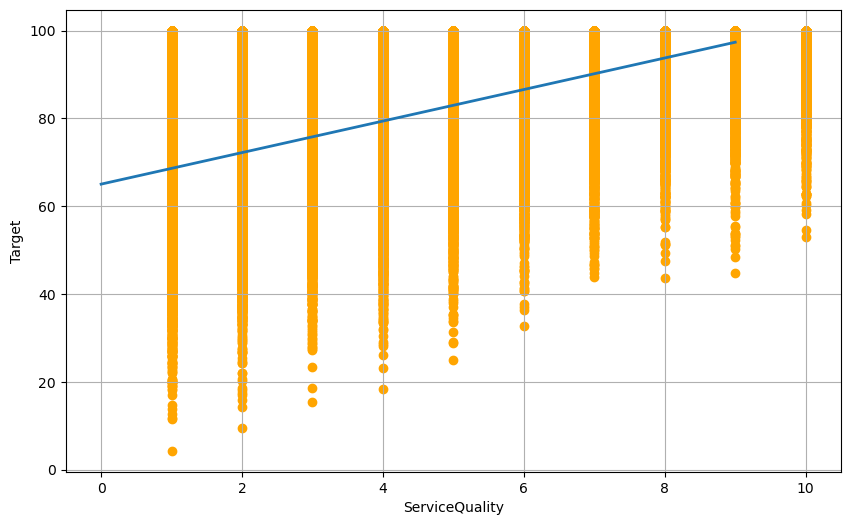

In [186]:
fig = plt.figure(figsize=(10,6))
x = np.arange(10)
our_model_y = next_w1 * x + next_w0
plt.plot(x, our_model_y, lw=2, label=f' Вручную= {next_w1:.2f}x + {next_w0:.2f}')
plt.xlabel('ServiceQuality')
plt.ylabel('Target')
plt.scatter(X,y, color='orange')
plt.grid()


<font size = 5> Такая форма распределения вызвана тем, что **ServiceQuality** является дискретным численным признаком, однако даже так можно увидеть, что модель достаточно хорошо уловила тренд целевой переменной.

## 3. Загрузить данные: 'insurance.csv'. Вывести и провести предобработку.Вывести список уникальных регионов.

In [187]:
df_3 = pd.read_csv('insurance.csv')

In [188]:
df_3.head()

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520


In [189]:
df_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


In [191]:
df_3.isna().sum()

age         0
sex         0
bmi         0
children    0
smoker      0
region      0
charges     0
dtype: int64

In [192]:
# Нет пропусков

In [193]:
df_3.region.unique()

array(['southwest', 'southeast', 'northwest', 'northeast'], dtype=object)

## 3.1. Выполнить однофакторный ANOVA тест, чтобы проверить влияние региона на индекс массы тела (BMI), используя первый способ, через библиотеку Scipy.

In [224]:
stats.f_oneway(df_3[df_3['region'] == 'northeast']['bmi'],
               df_3[df_3['region'] == 'northwest']['bmi'],
               df_3[df_3['region'] == 'southeast']['bmi'],
               df_3[df_3['region'] == 'southwest']['bmi'])

F_onewayResult(statistic=39.49505720170283, pvalue=1.881838913929143e-24)

<font size = 5> Таким образом, p_value < < 0.05 => Есть статистически значимые различия между средними значениями **BMI** в данных регионах

## 3.2. Выполнить однофакторный ANOVA тест, чтобы проверить влияние региона на индекс массы тела (BMI), используя второй способ, с помощью функции anova_lm() из библиотеки statsmodels

In [205]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [206]:
model = ols('bmi ~ region', data=df_3).fit()
anova_result = sm.stats.anova_lm(model, typ = 2)

In [207]:
print(anova_result)

                sum_sq      df          F        PR(>F)
region     4055.880631     3.0  39.495057  1.881839e-24
Residual  45664.319755  1334.0        NaN           NaN


<font size = 5> Видим результат, где:<br>
- sum_sq -  сумма квадратов отклонений для фактора region
- df - степени свободы, Имеем n - 1 = 3, где **n = 4** это группы регионов 
- F - значение F-статистики
- PR(>F) - P-value, которое указывает на малую стат. значимость гипотезы H0, т. е. **region** оказывает существенное влияние на **BMI**

## 3.3. С помощью t критерия Стьюдента перебрать все пары. Определить поправку Бонферрони. Сделать выводы.

In [236]:
region_pairs = []
regions = ['southwest', 'southeast', 'northwest', 'northeast']
groups = df_3.groupby('region').groups

for region1 in range(3):
    for region2 in range(region1 + 1, 4):
        region_pairs.append((regions[region1], regions[region2]))
        
for region1, region2 in region_pairs:
    print(region1, region2)
    print(stats.ttest_ind(df_3.iloc[groups[region1]]['bmi'], df_3.iloc[groups[region2]]['bmi']))

southwest southeast
Ttest_indResult(statistic=-5.908373821545118, pvalue=5.4374009639680636e-09)
southwest northwest
Ttest_indResult(statistic=3.2844171500398582, pvalue=0.001076958496307695)
southwest northeast
Ttest_indResult(statistic=3.1169000930045923, pvalue=0.0019086161671573072)
southeast northwest
Ttest_indResult(statistic=9.25649013552548, pvalue=2.643571405230106e-19)
southeast northeast
Ttest_indResult(statistic=8.790905562598699, pvalue=1.186014937424813e-17)
northwest northeast
Ttest_indResult(statistic=0.060307727183293185, pvalue=0.951929170821864)


<font size = 5> Имеем 6 сравнений, поэтому делим критическое значение p_value на 6 и сравниваем. p_value ~ 0.0083

<font size = 5> Таким образом, значимое различие в разнице BMI в регионах вносят **northwest** и **northeast** регионы 

## 3.4. Выполнить пост-хок тесты Тьюки и построить график.

In [238]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd

group1,group2,meandiff,p-adj,lower,upper,reject
northeast,northwest,0.0263,0.9999,-1.1552,1.2078,False
northeast,southeast,4.1825,0.0,3.033,5.332,True
northeast,southwest,1.4231,0.0107,0.2416,2.6046,True
northwest,southeast,4.1562,0.0,3.0077,5.3047,True
northwest,southwest,1.3968,0.0127,0.2162,2.5774,True
southeast,southwest,-2.7594,0.0,-3.9079,-1.6108,True


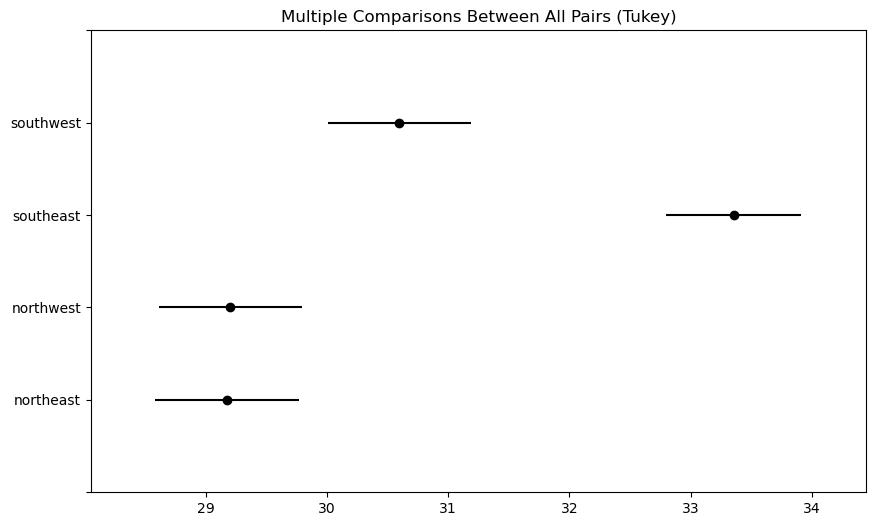

In [241]:
tukey = pairwise_tukeyhsd(df_3['bmi'], df_3['region'])
tukey.plot_simultaneous()
tukey.summary()

<font size = 5>  Видим как сильно перекрываются интервалы northwest и northeast, то есть различия между ними не существенны.

## 3.5. Выполнить двухфакторный ANOVA тест, чтобы проверить влияние региона и пола на индекс массы тела (BMI), используя функцию anova_lm() из библиотеки statsmodels.

In [246]:
model = ols('bmi ~ region + sex + region:sex', data=df_3).fit()

sm.stats.anova_lm(model, typ = 2)



,sum_sq,df,F,PR(>F)
region,4034.975135,3.0,39.398134,2.163195e-24
sex,86.007035,1.0,2.519359,1.126940e-01
region:sex,174.157808,3.0,1.700504,1.650655e-01
Residual,45404.154911,1330.0,NaN,NaN


<font size = 5> Видим, что **region** наиболее сильно влияет на **BMI**

group1,group2,meandiff,p-adj,lower,upper,reject
northeast:female,northeast:male,-0.2998,0.9998,-2.2706,1.6711,False
northeast:female,northwest:female,-0.0464,1.0,-2.0142,1.9215,False
northeast:female,northwest:male,-0.2042,1.0,-2.1811,1.7728,False
northeast:female,southeast:female,3.3469,0.0,1.41,5.2839,True
northeast:female,southeast:male,4.6657,0.0,2.7634,6.568,True
northeast:female,southwest:female,0.7362,0.9497,-1.2377,2.71,False
northeast:female,southwest:male,1.8051,0.1007,-0.1657,3.776,False
northeast:male,northwest:female,0.2534,0.9999,-1.7083,2.2152,False
northeast:male,northwest:male,0.0956,1.0,-1.8752,2.0665,False
northeast:male,southeast:female,3.6467,0.0,1.7159,5.5775,True


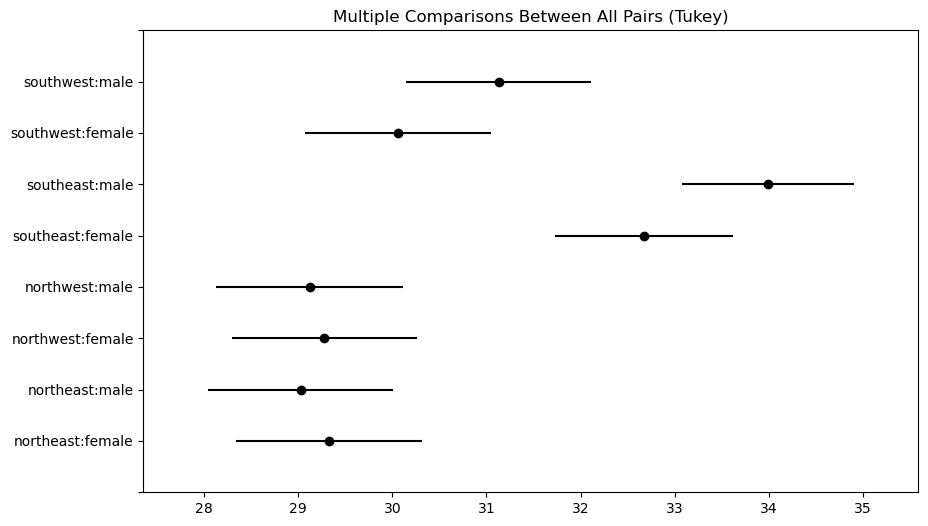

In [249]:
tukey_interaction = pairwise_tukeyhsd(endog=df_3['bmi'], 
                                      groups=df_3['region'] + ':' + df_3['sex'], 
                                      alpha=0.05)
tukey_interaction.plot_simultaneous()
tukey_interaction.summary()

<font size = 5>Можно выделить, что у мужчин и женщин, в пределах одного региона слабое отличие в **BMI**